In [1]:
!pwd

/Users/brandonkevinchen/fonglab/Projects/project-cr1_gd_project/analysis/gd_tumor_scanpy3


## Table of contents <a class='anchor' id='toc'></a>
* [13. Jan 31, 2021](#13)
* [14. Mar 8, 2021](#14)
* [15. Mar 10, 2021](#15)
* [16. Sep 2, 2021](#16)
* [17. Oct 13, 2021](#17)
* [18. Oct 14, 2021](#18)
* [19. Oct 15, 2021](#19)
* [20. Nov 24, 2021](#20)
* [21. Dec 21, 2021](#21)
* [22. Feb 23, 2022](#22)
* [23. Apr 25, 2022](#23)
* [24. May 24, 2022 - appeal to NI editor](#24)
* [25. Aug 11, 2022 - Vd-chain data](#25)
* [26. Sep 2, 2022 - CD8 exh score by subset, Fig 4 violins](#26)
* [27. Sep 22, 2022](#27)
* [28. Oct 10, 2022 - re-color and re-label TCR expansion UMAP](#28)
* [29. Oct 20, 2022 - PTT/cytotox violins split by expansion](#29)
* [30. Oct 24, 2022 - tweak expansion plots (drop nan, add IL2 violin)](#30)
* [31. Nov 3, 2022 - tweak matrixplot (add IL17, act: DNAM-1, NKG2D, NKp30, NKp44, NKp46, CD16)](#31)
* [32. Nov 17, 2022 - make PTT UMAP](#32)
* [33. Nov 21, 2022 - extract counts for (cytotox) violin plot stats](#33)
* [34. Nov 23, 2022](#34)
* [35. Nov 29, 2022 - re-export expansion violin counts (use tcr_expansion numbers) to match violins](#35)
* [36. Dec 1, 2022 - re-making the Fig. 4E heatmap](#36)
* [37. Bottom of notebook](#37)

## 13. Jan 31, 2021 <a class='anchor' id='13'></a>

[Table of contents](#toc)

1. Evaluate options for creating Vd2 labels using GENEX data
2. Create labels
3. Save to ‘results_file’

In [6]:
# dotplot
fig4e_marker_dict = {
                 'Exhaustion': ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'ENTPD1', 'TOX'],       
                 'Activation': ['TNFRSF9', 'MKI67'],          
                 'Cytotoxic': ['PRF1', 'GZMB', 'GZMA', 'GZMK'],
                 'Cytokine': ['TNF', 'IFNG', 'IL2']}

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_single_trdv2']`
categories: Vd2+, Vd2-, nan
var_group_labels: Exhaustion, Activation, Cytotoxic, etc.


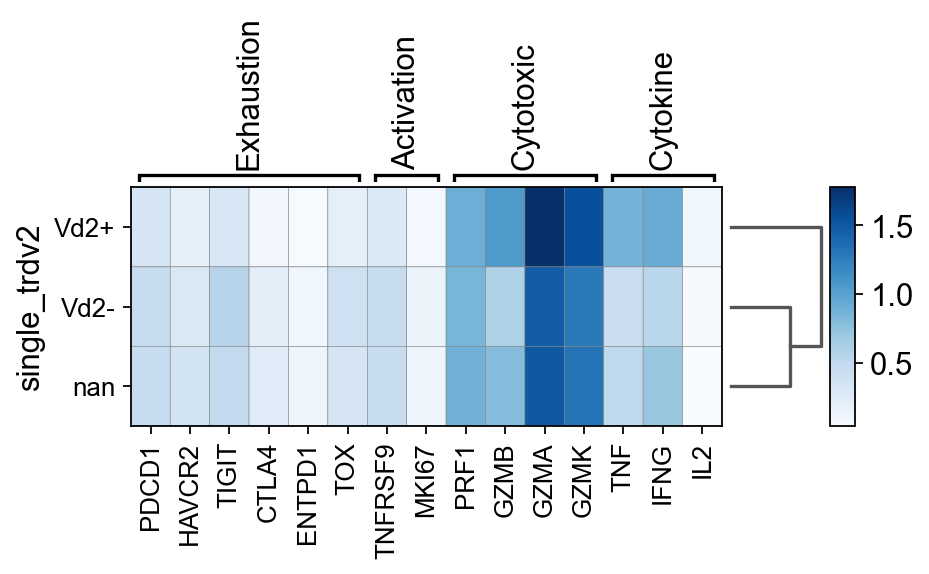

GridSpec(2, 3, height_ratios=[0.5, 10], width_ratios=[4.8, 0.8, 0.2])

In [7]:
# matrixplot (heatmap)
sc.pl.matrixplot(adata, fig4e_marker_dict, 'single_trdv2', dendrogram=True, 
                 cmap='Blues', save='_fig4e_single_trdv2')

categories: Vd2+, Vd2-, nan
var_group_labels: Exhaustion, Activation, Cytotoxic, etc.


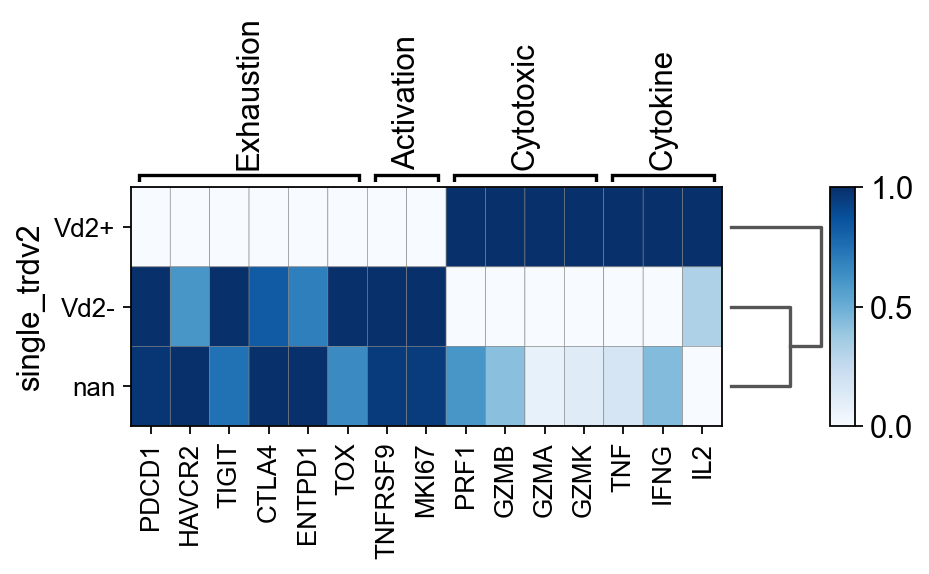

GridSpec(2, 3, height_ratios=[0.5, 10], width_ratios=[4.8, 0.8, 0.2])

In [8]:
# matrixplot (heatmap)
sc.pl.matrixplot(adata, fig4e_marker_dict, 'single_trdv2', dendrogram=True, 
                 cmap='Blues', standard_scale='var', save='_fig4e_single_trdv2_scaled')

### Evaluate options for creating Vd2 labels using GENEX data

In [9]:
trdv_genes = ['TRDV1', 'TRDV2', 'TRDV3', 'TRAV14DV4', 'TRAV29DV5', 'TRAV23DV6', 'TRAV36DV7', 'TRAV38-2DV8']
df = pd.DataFrame(adata[:, trdv_genes].X, columns = trdv_genes)
df

,TRDV1,TRDV2,TRDV3,TRAV14DV4,TRAV29DV5,TRAV23DV6,TRAV36DV7,TRAV38-2DV8
0,1.733922,-0.645546,-0.244023,-0.035973,-0.244889,-0.056937,-0.078989,-0.142141
1,0.492303,-0.509563,-0.209276,0.016666,-0.243020,-0.134350,-0.091204,-0.177123
2,-0.906340,2.326294,-0.258707,-0.150294,-0.084460,0.081396,-0.072790,-0.101172
3,-0.702713,-0.541289,-0.240464,0.008154,-0.291670,-0.116111,-0.079376,-0.151528
4,-0.757303,-0.561266,-0.290666,0.003467,4.537034,-0.102555,-0.059396,-0.108707
...,...,...,...,...,...,...,...,...
3019,-0.450865,-0.295909,-0.191179,0.069670,-0.175002,-0.240555,-0.090884,-0.174661
3020,-0.786273,-0.635799,-0.262172,-0.026610,-0.296664,-0.063269,-0.072167,-0.130916
3021,1.741261,-0.689894,-0.277407,-0.022635,-0.398177,-0.042944,-0.070438,-0.136600
3022,-0.927502,-0.816649,-0.296724,22.396383,-0.257527,0.041446,-0.059806,-0.089550


array([[<AxesSubplot:title={'center':'TRDV1'}>,
        <AxesSubplot:title={'center':'TRDV2'}>,
        <AxesSubplot:title={'center':'TRDV3'}>],
       [<AxesSubplot:title={'center':'TRAV14DV4'}>,
        <AxesSubplot:title={'center':'TRAV29DV5'}>,
        <AxesSubplot:title={'center':'TRAV23DV6'}>],
       [<AxesSubplot:title={'center':'TRAV36DV7'}>,
        <AxesSubplot:title={'center':'TRAV38-2DV8'}>, <AxesSubplot:>]],
      dtype=object)

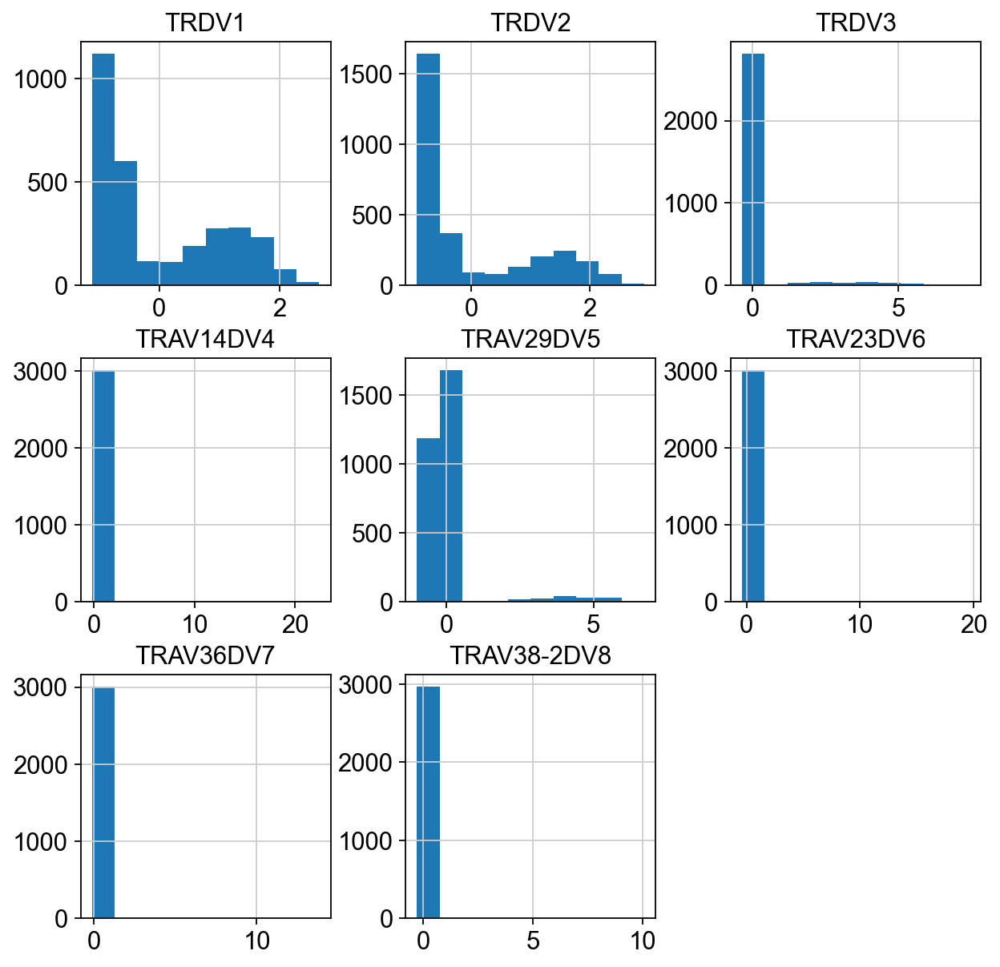

In [10]:
df.hist(figsize = (9, 9))

In [11]:
# label by max trdv expr
max_trdv_counts = df.idxmax(axis = 1).value_counts()
max_trdv_counts

TRDV1          1081
TRDV2           857
TRAV14DV4       386
TRAV29DV5       220
TRAV23DV6       218
TRDV3           191
TRAV38-2DV8      52
TRAV36DV7        19
dtype: int64

In [12]:
# filter out cells where all trdv genes < 0
max_trdv_counts_w_cutoff = df[df > 0].idxmax(axis = 1).value_counts()

# add 'nan' counts back in
n = adata.shape[0] - sum(max_trdv_counts_w_cutoff)
nan_count = pd.Series(n, index = ['nan'])
max_trdv_counts_w_cutoff = max_trdv_counts_w_cutoff.append(nan_count)

max_trdv_counts_w_cutoff

TRDV1          1081
TRDV2           857
TRAV14DV4       224
TRAV29DV5       206
TRDV3           191
TRAV23DV6       131
TRAV38-2DV8      52
TRAV36DV7        17
nan             265
dtype: int64

In [13]:
# compare counts
d = {'single_trdv': adata.obs['single_trdv'].value_counts(),
     'max_trdv_cutoff': max_trdv_counts_w_cutoff,
     'max_trdv': max_trdv_counts}
counts = pd.DataFrame(d, index = trdv_genes + ['nan'], dtype='int64')
counts[counts.isnull()] = 0
counts = counts.astype('int64')
counts

,single_trdv,max_trdv_cutoff,max_trdv
TRDV1,461,1081,1081
TRDV2,650,857,857
TRDV3,59,191,191
TRAV14DV4,1,224,386
TRAV29DV5,111,206,220
TRAV23DV6,1,131,218
TRAV36DV7,1,17,19
TRAV38-2DV8,0,52,52
nan,1740,265,0


In [14]:
# compare proportions
proportions = round(counts / adata.shape[0] * 100, 1)
proportions

,single_trdv,max_trdv_cutoff,max_trdv
TRDV1,15.2,35.7,35.7
TRDV2,21.5,28.3,28.3
TRDV3,2.0,6.3,6.3
TRAV14DV4,0.0,7.4,12.8
TRAV29DV5,3.7,6.8,7.3
TRAV23DV6,0.0,4.3,7.2
TRAV36DV7,0.0,0.6,0.6
TRAV38-2DV8,0.0,1.7,1.7
nan,57.5,8.8,0.0


### Create labels

In [15]:
max_trdv_counts_w_cutoff = df[df > 0].idxmax(axis = 1)
max_trdv_counts_w_cutoff[max_trdv_counts_w_cutoff.isnull()] = 'nan'
max_trdv_counts_w_cutoff

0           TRDV1
1           TRDV1
2           TRDV2
3       TRAV14DV4
4       TRAV29DV5
          ...    
3019    TRAV14DV4
3020          nan
3021        TRDV1
3022    TRAV14DV4
3023        TRDV1
Length: 3024, dtype: object

In [16]:
adata.obs['max_trdv'] = pd.Categorical(np.array(max_trdv_counts_w_cutoff),
                                      categories = trdv_genes + ['nan'])
adata.obs['max_trdv'].value_counts()

TRDV1          1081
TRDV2           857
nan             265
TRAV14DV4       224
TRAV29DV5       206
TRDV3           191
TRAV23DV6       131
TRAV38-2DV8      52
TRAV36DV7        17
Name: max_trdv, dtype: int64

In [17]:
temp = np.array(adata.obs['max_trdv'])
temp[temp == 'TRDV2'] = 'Vd2+'
temp[np.all([(temp != 'Vd2+'), (temp != 'nan')], axis=0)] = 'Vd2-'
adata.obs['max_trdv2'] = temp
adata.obs['max_trdv2'].value_counts()

Vd2-    1902
Vd2+     857
nan      265
Name: max_trdv2, dtype: int64

... storing 'max_trdv2' as categorical


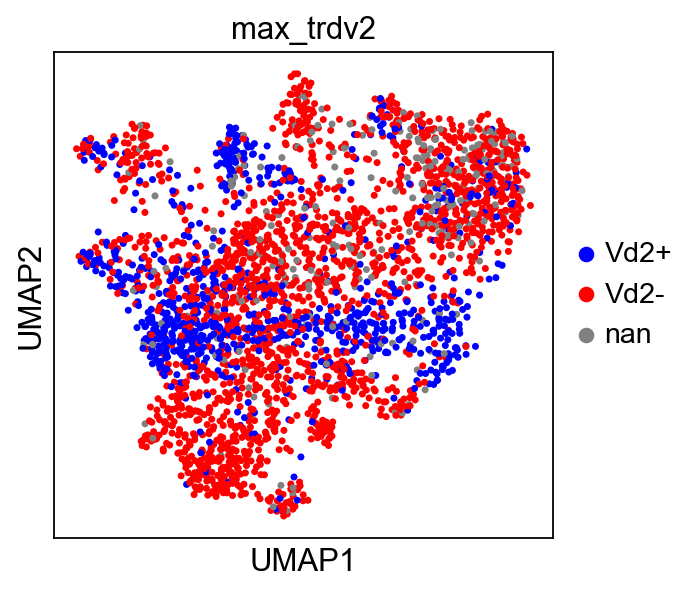

In [18]:
sc.pl.umap(adata, color=['max_trdv2'], palette=['blue', 'red', 'grey'])

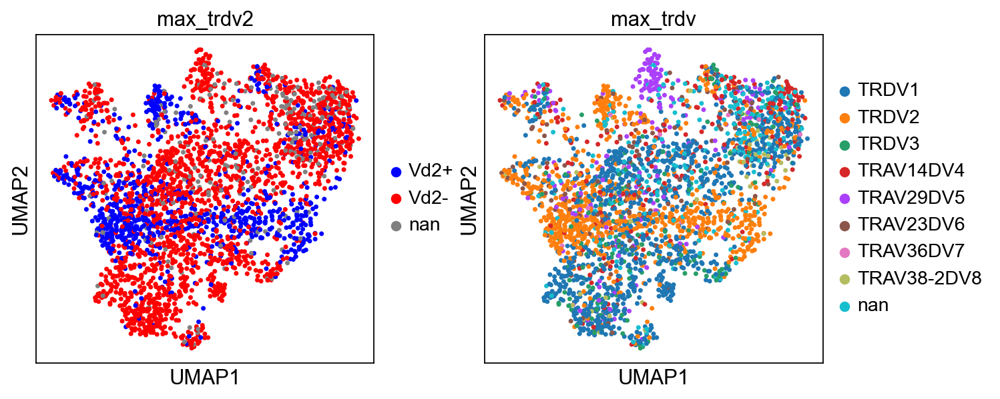

In [19]:
sc.pl.umap(adata, color=['max_trdv2', 'max_trdv'],
          save='_max_trdv')

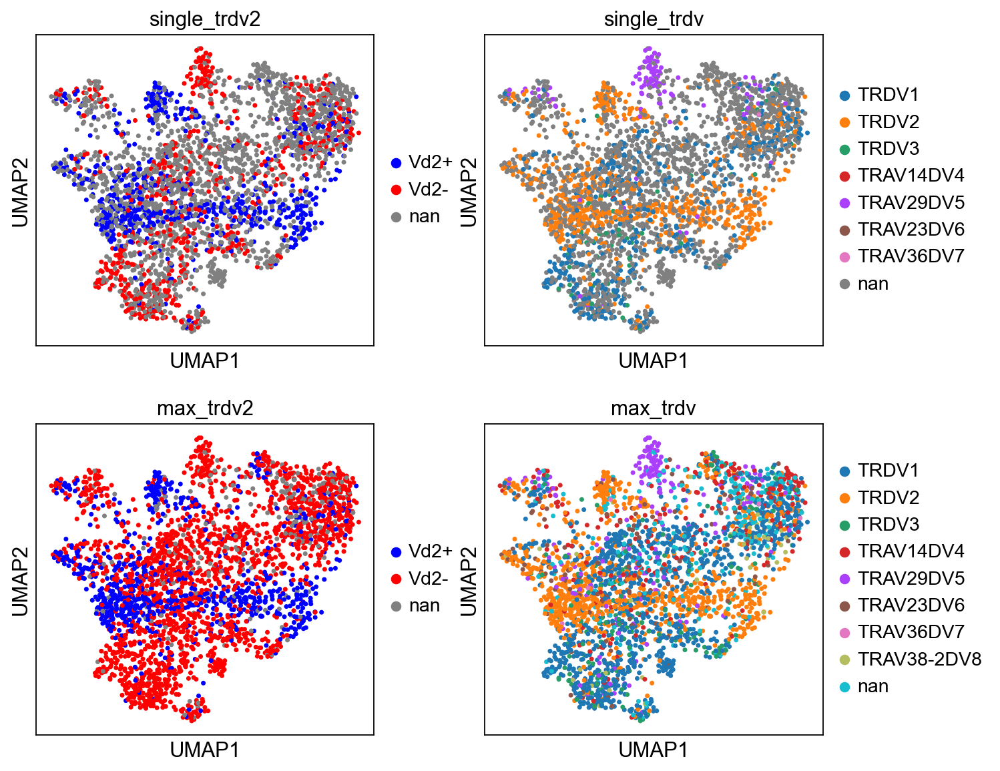

In [20]:
sc.pl.umap(adata, color=['single_trdv2', 'single_trdv', 
                         'max_trdv2', 'max_trdv'], ncols=2,
          save='_max_trdv_comparison')

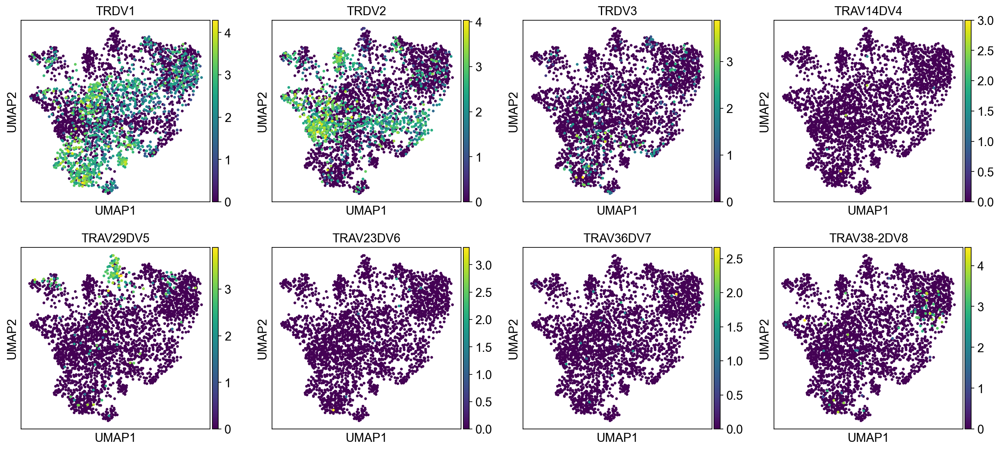

In [21]:
sc.pl.umap(adata, color=trdv_genes,
          save='_trdv_genes')

In [22]:
# dotplot
fig4e_marker_dict = {
                 'Exhaustion': ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'ENTPD1', 'TOX'],       
                 'Activation': ['TNFRSF9', 'MKI67'],          
                 'Cytotoxic': ['PRF1', 'GZMB', 'GZMA', 'GZMK'],
                 'Cytokine': ['TNF', 'IFNG', 'IL2']}

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_max_trdv2']`
categories: Vd2+, Vd2-, nan
var_group_labels: Exhaustion, Activation, Cytotoxic, etc.


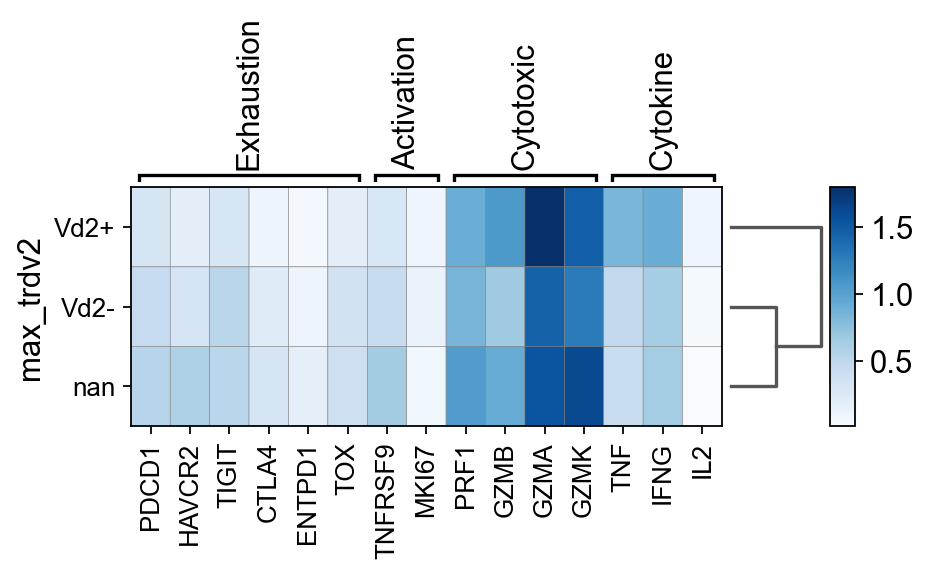

GridSpec(2, 3, height_ratios=[0.5, 10], width_ratios=[4.8, 0.8, 0.2])

In [23]:
# matrixplot (heatmap)
sc.pl.matrixplot(adata, fig4e_marker_dict, 'max_trdv2', dendrogram=True, 
                 cmap='Blues', 
                 save='_fig4e_max_trdv2')

categories: Vd2+, Vd2-, nan
var_group_labels: Exhaustion, Activation, Cytotoxic, etc.


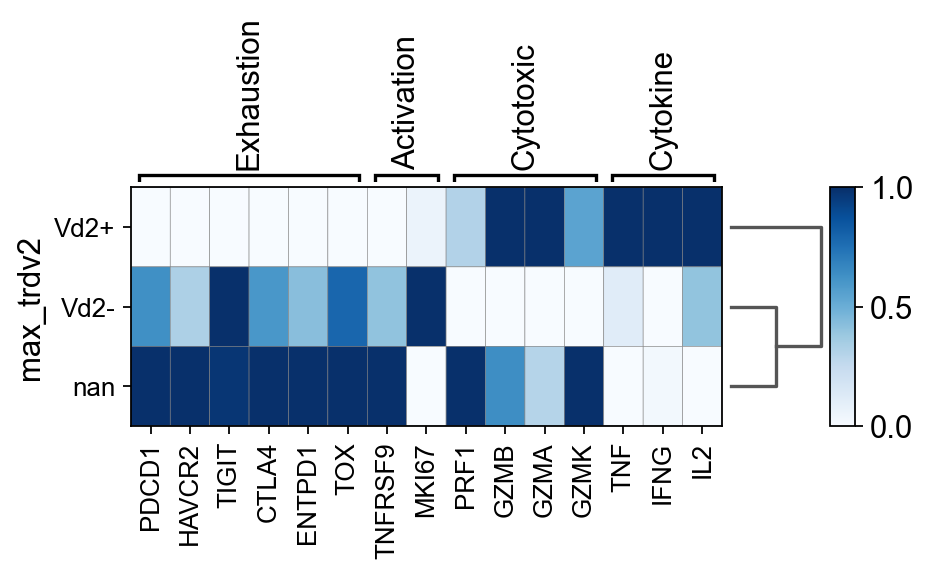

GridSpec(2, 3, height_ratios=[0.5, 10], width_ratios=[4.8, 0.8, 0.2])

In [24]:
# matrixplot (heatmap)
sc.pl.matrixplot(adata, fig4e_marker_dict, 'max_trdv2', dendrogram=True, 
                 cmap='Blues', standard_scale='var', 
                 save='_fig4e_max_trdv2_scaled')

### Save to 'results_file'

In [25]:
adata.write(results_file)

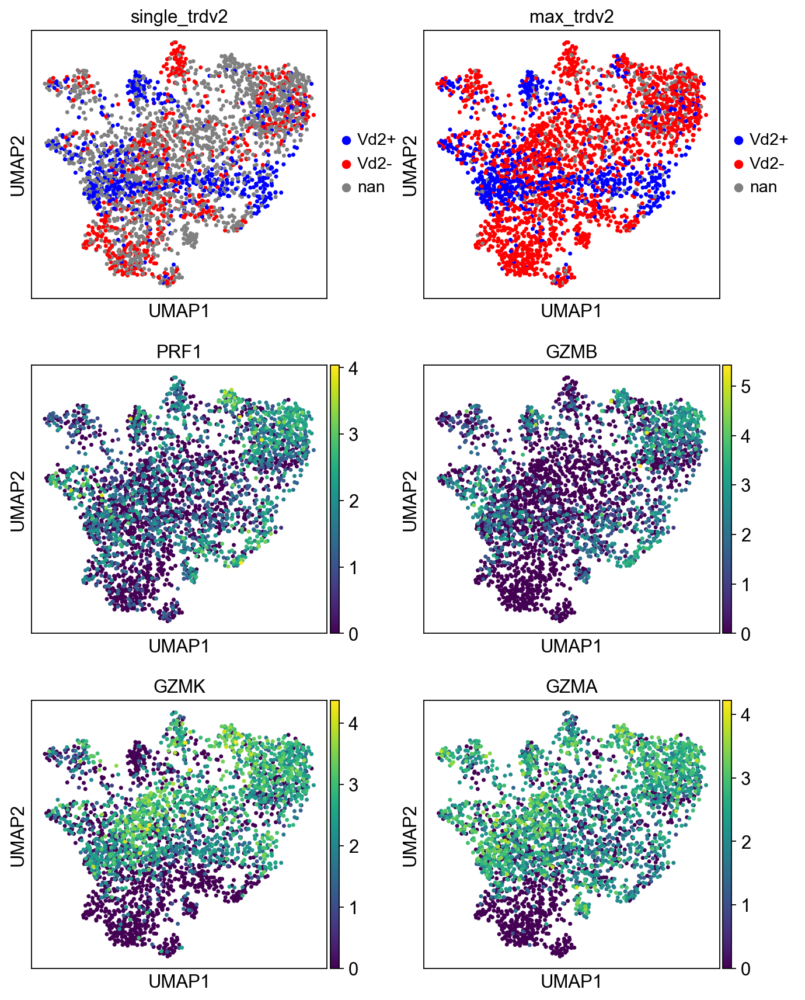

In [34]:
sc.pl.umap(adata, color=['single_trdv2', 'max_trdv2',
                        'PRF1', 'GZMB', 'GZMK', 'GZMA'], ncols = 2,
          save='_trdv2_gzm')

categories: Vd2+, Vd2-, nan
var_group_labels: Exhaustion, Activation, Cytotoxic, etc.


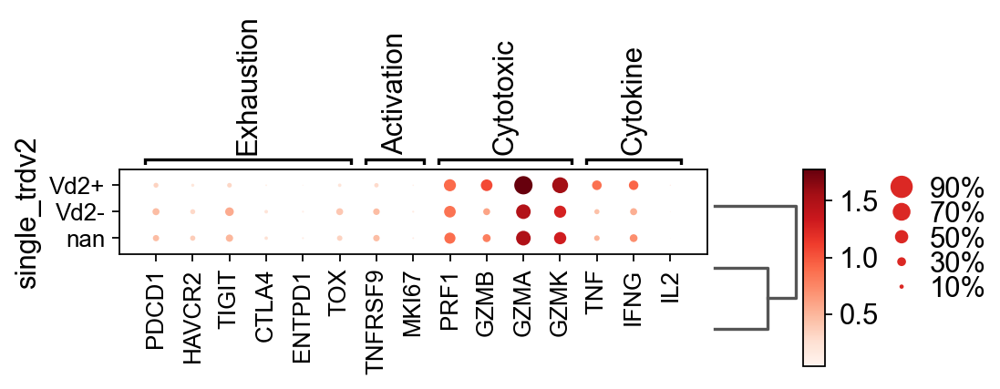

GridSpec(2, 5, height_ratios=[0.5, 10], width_ratios=[5.25, 0.8, 0.2, 0.5, 0.25])

In [32]:
sc.pl.dotplot(adata, fig4e_marker_dict, 'single_trdv2', dendrogram=True,
             save='_single_trdv2')

categories: Vd2+, Vd2-, nan
var_group_labels: Exhaustion, Activation, Cytotoxic, etc.


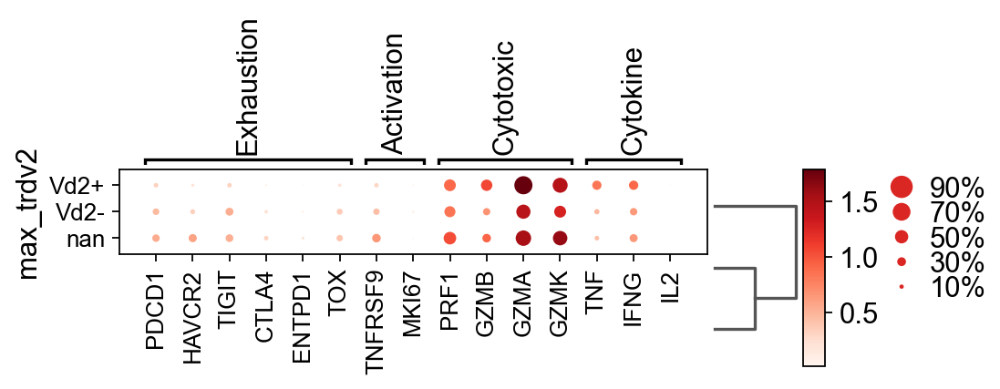

GridSpec(2, 5, height_ratios=[0.5, 10], width_ratios=[5.25, 0.8, 0.2, 0.5, 0.25])

In [33]:
sc.pl.dotplot(adata, fig4e_marker_dict, 'max_trdv2', dendrogram=True,
             save='_max_trdv2')

## 14. Mar 8, 2021 <a class='anchor' id='14'></a>

[Table of contents](#toc)

1. Re-evaluate max_trdv cutoff (of 0)
    1. First examine dv1, dv2, dv3, and dv5 to establish a baseline
    2. Next examine dv4, dv6, and dv8, keeping the baseline distributions in mind
2. Tue Mar 9 (post-meeting) - Don’t use a cutoff!
3. Create labels

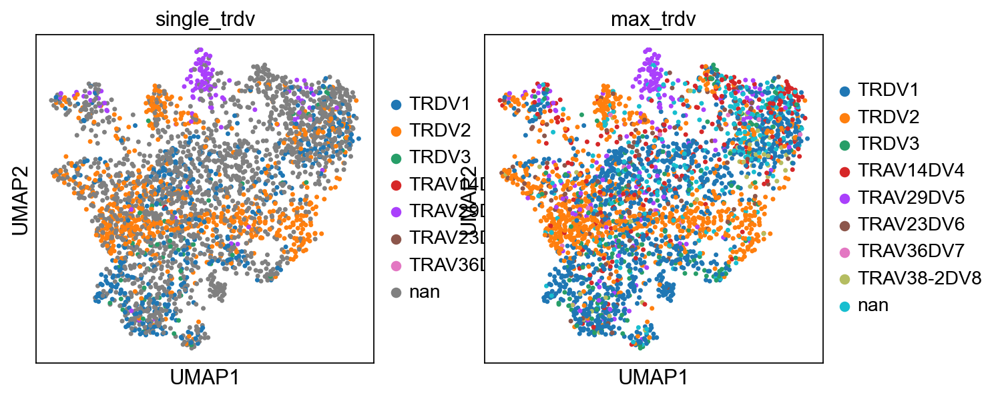

In [10]:
sc.pl.umap(adata, color=['single_trdv', 'max_trdv'])

### Re-evalulate max_trdv cutoff (of 0)

#### First examine dv1, dv2, dv3, and dv5 to establish a baseline

In [106]:
trdv_genes = ['TRDV1', 'TRDV2', 'TRDV3', 'TRAV14DV4', 'TRAV29DV5', 'TRAV23DV6', 'TRAV36DV7', 'TRAV38-2DV8']

In [107]:
# Examine dv1
df = pd.DataFrame(adata[adata.obs['max_trdv'] == 'TRDV1', trdv_genes].X, columns = trdv_genes)
df

,TRDV1,TRDV2,TRDV3,TRAV14DV4,TRAV29DV5,TRAV23DV6,TRAV36DV7,TRAV38-2DV8
0,1.733922,-0.645546,-0.244023,-0.035973,-0.244889,-0.056937,-0.078989,-0.142141
1,0.492303,-0.509563,-0.209276,0.016666,-0.243020,-0.134350,-0.091204,-0.177123
2,2.350619,-0.781054,-0.270012,-0.082548,-0.257603,0.017043,-0.071262,-0.119908
3,1.814133,-0.445166,-0.211767,0.047365,-0.292319,-0.172001,-0.090019,-0.181620
4,1.331667,-0.725743,-0.291136,-0.075397,-0.251163,-0.005672,-0.059533,-0.090745
...,...,...,...,...,...,...,...,...
1076,1.294891,-0.822438,-0.306041,-0.108943,-0.253752,0.046970,-0.055477,-0.077866
1077,0.879428,0.847458,-0.225044,0.001513,-0.228247,-0.119338,-0.083833,-0.156005
1078,0.961959,-0.654909,-0.254884,-0.022339,-0.325618,-0.058283,-0.077220,-0.146626
1079,1.741261,-0.689894,-0.277407,-0.022635,-0.398177,-0.042944,-0.070438,-0.136600


array([[<AxesSubplot:title={'center':'TRDV1'}>,
        <AxesSubplot:title={'center':'TRDV2'}>,
        <AxesSubplot:title={'center':'TRDV3'}>],
       [<AxesSubplot:title={'center':'TRAV14DV4'}>,
        <AxesSubplot:title={'center':'TRAV29DV5'}>,
        <AxesSubplot:title={'center':'TRAV23DV6'}>],
       [<AxesSubplot:title={'center':'TRAV36DV7'}>,
        <AxesSubplot:title={'center':'TRAV38-2DV8'}>, <AxesSubplot:>]],
      dtype=object)

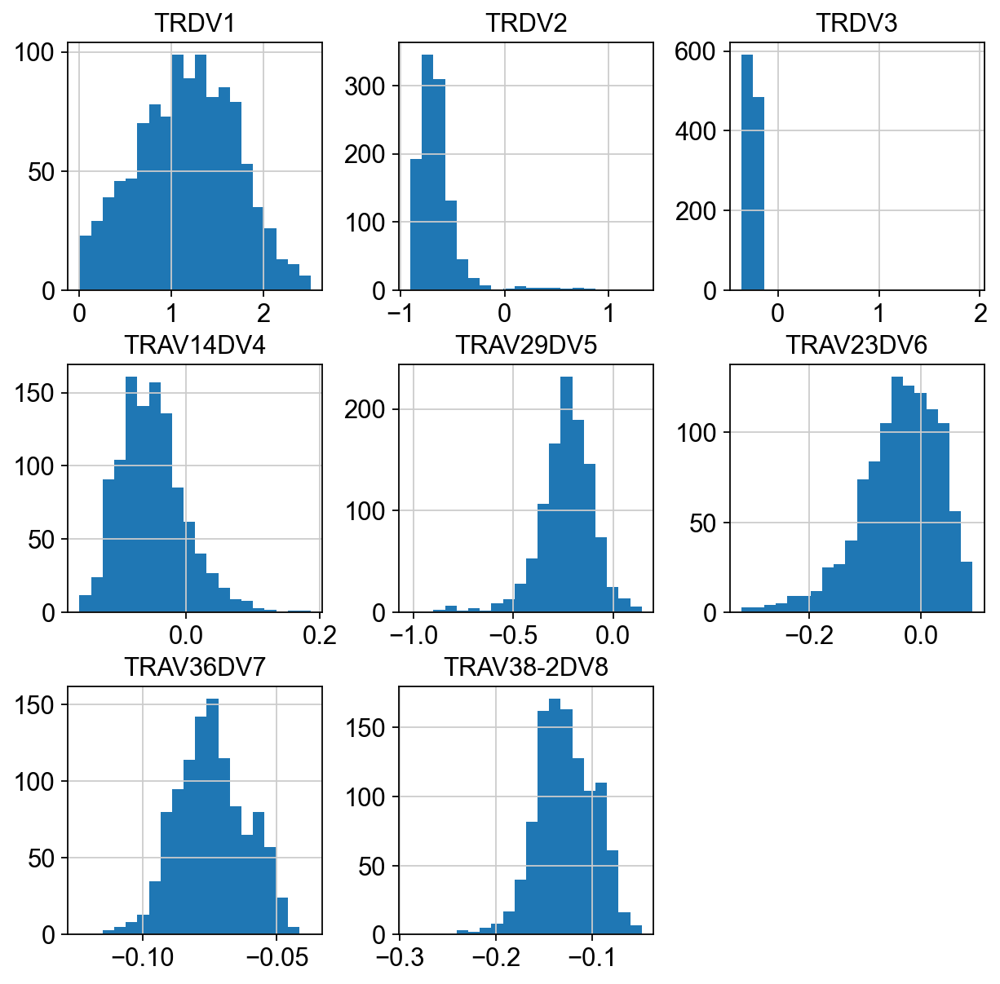

In [108]:
df.hist(figsize = (9, 9), bins = 20)

In [109]:
(df['TRDV1'] > 0.5).value_counts()

True     946
False    135
Name: TRDV1, dtype: int64

In [110]:
(df['TRDV1'] > 1).value_counts()

True     679
False    402
Name: TRDV1, dtype: int64

In [111]:
# benchmark 
adata.obs['single_trdv'].value_counts()

nan          1740
TRDV2         650
TRDV1         461
TRAV29DV5     111
TRDV3          59
TRAV36DV7       1
TRAV23DV6       1
TRAV14DV4       1
Name: single_trdv, dtype: int64

<AxesSubplot:>

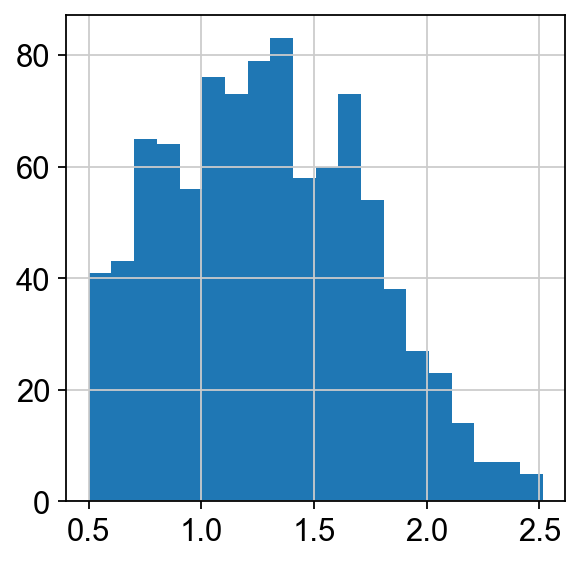

In [112]:
# 946 vs 461 (using cutoff: 0.5). still good.
df['TRDV1'][df['TRDV1'] > 0.5].hist(bins = 20)

In [114]:
# Examine dv2
df = pd.DataFrame(adata[adata.obs['max_trdv'] == 'TRDV2', trdv_genes].X, columns = trdv_genes)
df

,TRDV1,TRDV2,TRDV3,TRAV14DV4,TRAV29DV5,TRAV23DV6,TRAV36DV7,TRAV38-2DV8
0,-0.906340,2.326294,-0.258707,-0.150294,-0.084460,0.081396,-0.072790,-0.101172
1,-0.989043,1.178105,-0.342141,-0.085082,-0.397043,0.038540,-0.043907,-0.064813
2,-0.679245,1.570715,-0.215341,-0.028144,-0.155167,-0.088406,-0.087063,-0.154436
3,-0.939688,1.991997,-0.295474,-0.132160,-0.191390,0.070672,-0.059180,-0.079072
4,-0.546119,0.555683,-0.194053,0.026487,-0.155110,-0.173952,-0.092424,-0.172709
...,...,...,...,...,...,...,...,...
852,-0.809841,0.835372,-0.261331,-0.059199,-0.233065,-0.027691,-0.071816,-0.121067
853,-0.440296,0.578763,-0.097358,-0.035340,0.180615,-0.139252,-0.126206,-0.219373
854,-0.674357,0.410679,-0.195276,-0.052882,-0.070604,-0.065601,-0.094310,-0.162221
855,-0.801071,0.960847,-0.250929,-0.038841,-0.270384,-0.046399,-0.077383,-0.140304


array([[<AxesSubplot:title={'center':'TRDV1'}>,
        <AxesSubplot:title={'center':'TRDV2'}>,
        <AxesSubplot:title={'center':'TRDV3'}>],
       [<AxesSubplot:title={'center':'TRAV14DV4'}>,
        <AxesSubplot:title={'center':'TRAV29DV5'}>,
        <AxesSubplot:title={'center':'TRAV23DV6'}>],
       [<AxesSubplot:title={'center':'TRAV36DV7'}>,
        <AxesSubplot:title={'center':'TRAV38-2DV8'}>, <AxesSubplot:>]],
      dtype=object)

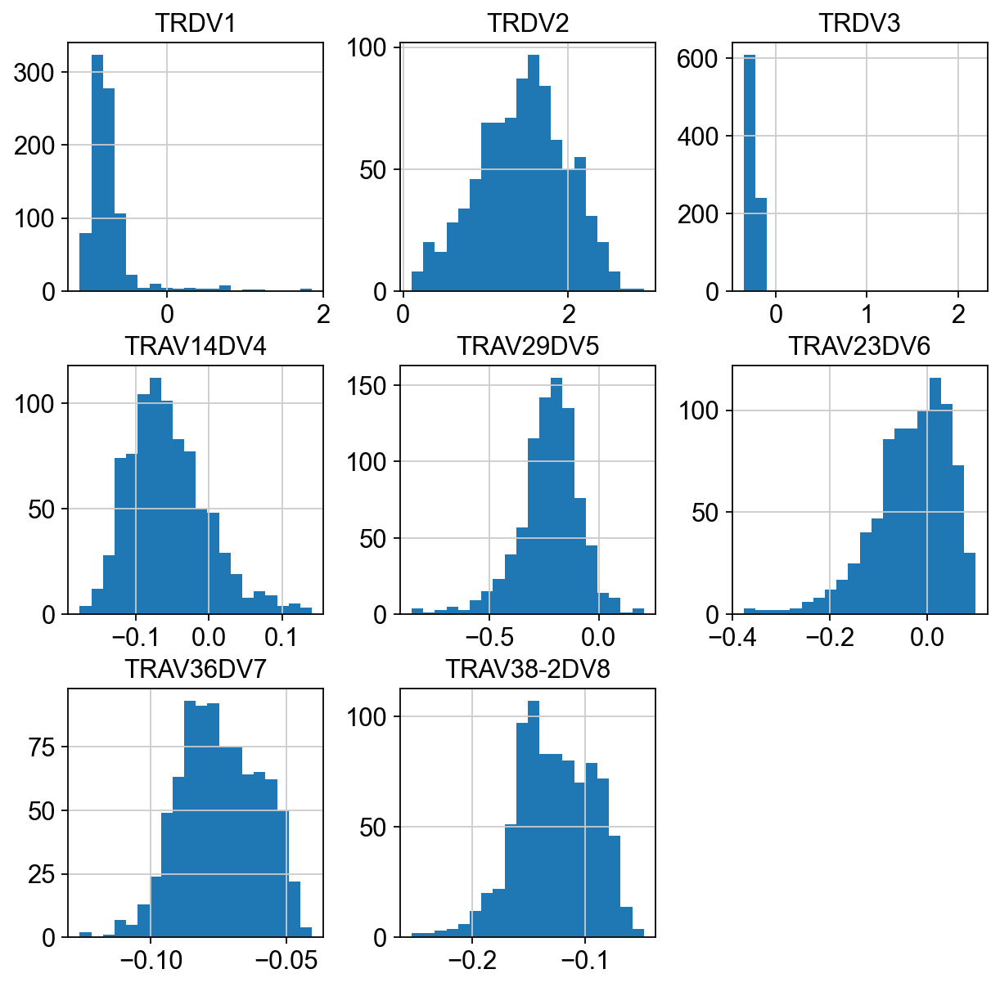

In [115]:
df.hist(figsize = (9, 9), bins = 20)

In [116]:
(df['TRDV2'] > 0.5).value_counts()

True     815
False     42
Name: TRDV2, dtype: int64

In [117]:
(df['TRDV2'] > 1).value_counts()

True     679
False    178
Name: TRDV2, dtype: int64

In [118]:
# benchmark 
adata.obs['single_trdv'].value_counts()

nan          1740
TRDV2         650
TRDV1         461
TRAV29DV5     111
TRDV3          59
TRAV36DV7       1
TRAV23DV6       1
TRAV14DV4       1
Name: single_trdv, dtype: int64

<AxesSubplot:>

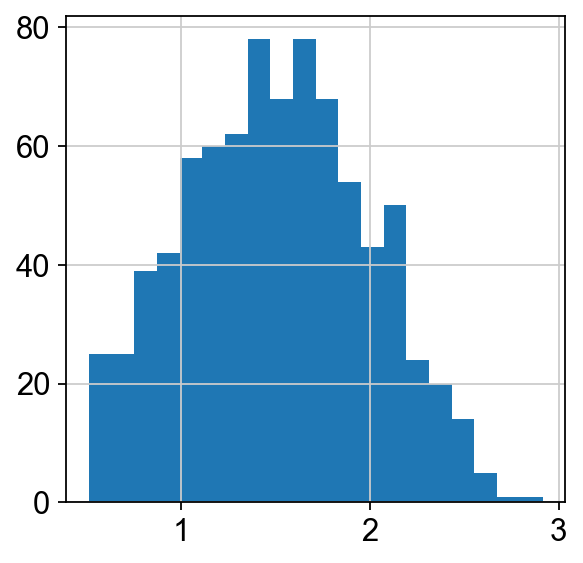

In [119]:
# 815 vs 650 (using cutoff: 0.5). still decent.
df['TRDV2'][df['TRDV2'] > 0.5].hist(bins = 20)

In [120]:
# Examine dv3
df = pd.DataFrame(adata[adata.obs['max_trdv'] == 'TRDV3', trdv_genes].X, columns = trdv_genes)
df

,TRDV1,TRDV2,TRDV3,TRAV14DV4,TRAV29DV5,TRAV23DV6,TRAV36DV7,TRAV38-2DV8
0,-0.925415,0.792409,1.675808,-0.064133,-0.346348,0.009646,-0.068948,-0.124228
1,-0.807288,-0.656508,4.656997,-0.029550,-0.308748,-0.054080,-0.073448,-0.134986
2,-0.784353,-0.671039,4.213836,-0.042548,-0.229464,-0.045364,-0.085454,-0.156177
3,-0.970062,1.976789,2.219699,-0.086738,-0.360311,0.036901,-0.051380,-0.079781
4,-0.866004,-0.696815,6.652742,-0.045091,-0.355701,-0.028692,-0.056604,-0.096108
...,...,...,...,...,...,...,...,...
186,-0.584650,-0.522230,4.425956,-0.040840,-0.022853,-0.105439,-0.085634,-0.137181
187,-0.634404,-0.470440,2.573076,0.013025,-0.251182,-0.144200,-0.068083,-0.120014
188,-0.873143,-0.692771,3.835822,-0.039094,-0.382128,-0.032399,-0.055071,-0.095339
189,-0.924420,-0.855972,4.902872,-0.134325,-0.164224,0.069142,-0.062327,-0.084133


array([[<AxesSubplot:title={'center':'TRDV1'}>,
        <AxesSubplot:title={'center':'TRDV2'}>,
        <AxesSubplot:title={'center':'TRDV3'}>],
       [<AxesSubplot:title={'center':'TRAV14DV4'}>,
        <AxesSubplot:title={'center':'TRAV29DV5'}>,
        <AxesSubplot:title={'center':'TRAV23DV6'}>],
       [<AxesSubplot:title={'center':'TRAV36DV7'}>,
        <AxesSubplot:title={'center':'TRAV38-2DV8'}>, <AxesSubplot:>]],
      dtype=object)

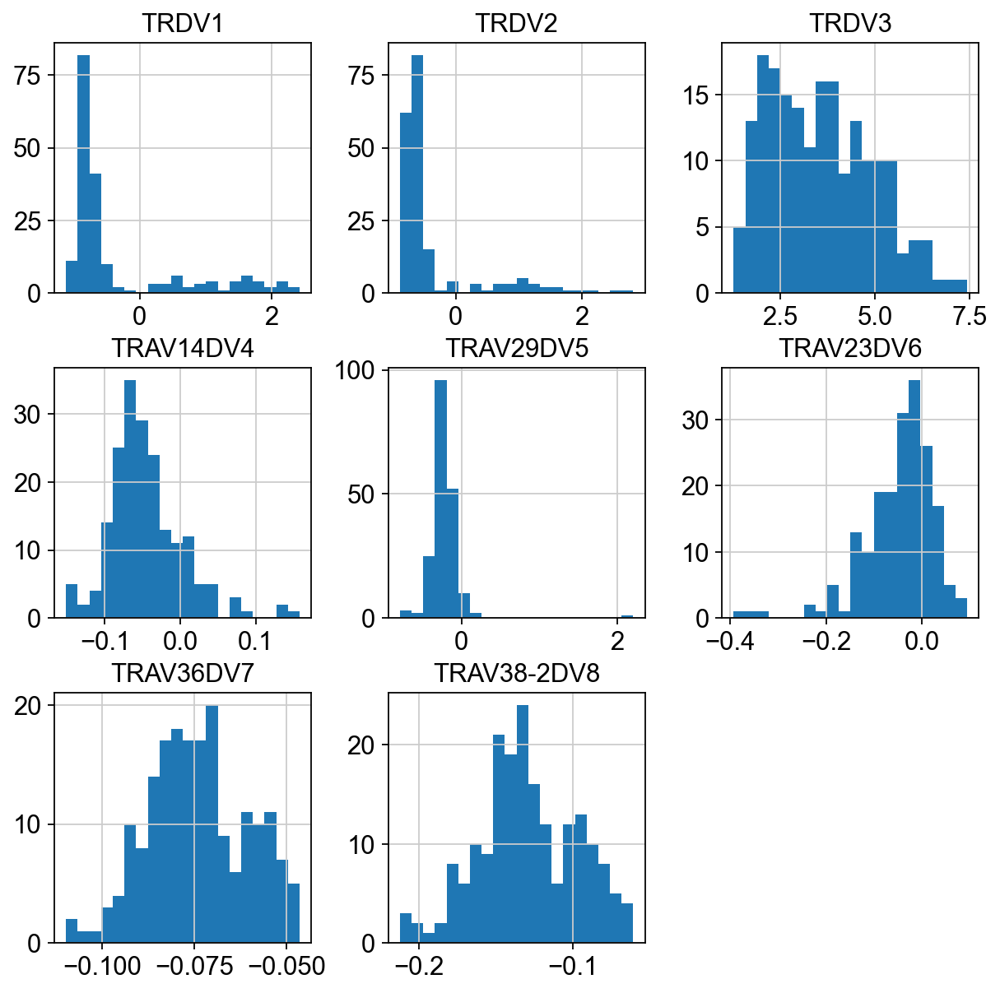

In [121]:
df.hist(figsize = (9, 9), bins = 20)

In [124]:
(df['TRDV3'] > 1).value_counts()

True    191
Name: TRDV3, dtype: int64

In [85]:
# benchmark 
adata.obs['single_trdv'].value_counts()

nan          1740
TRDV2         650
TRDV1         461
TRAV29DV5     111
TRDV3          59
TRAV36DV7       1
TRAV23DV6       1
TRAV14DV4       1
Name: single_trdv, dtype: int64

<AxesSubplot:>

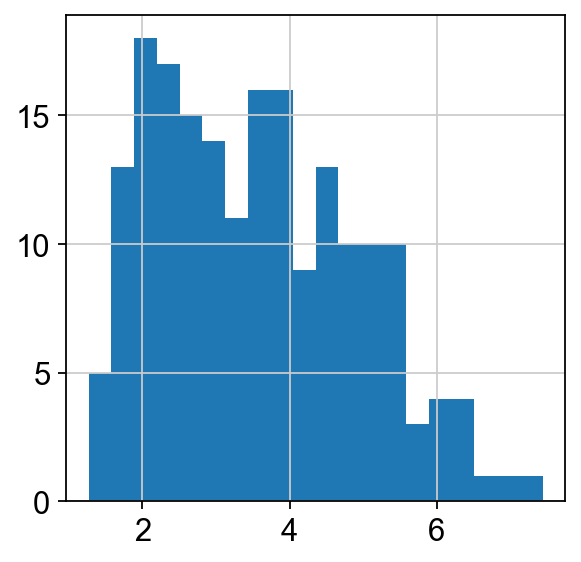

In [128]:
# 191 vs 59 (using cutoff: 1, 0 cells excluded). very good. or too good?

df['TRDV3'].hist(bins = 20)  # no additional cutoff required

In [130]:
# Examine dv5
df = pd.DataFrame(adata[adata.obs['max_trdv'] == 'TRAV29DV5', trdv_genes].X, columns = trdv_genes)
df

,TRDV1,TRDV2,TRDV3,TRAV14DV4,TRAV29DV5,TRAV23DV6,TRAV36DV7,TRAV38-2DV8
0,-0.757303,-0.561266,-0.290666,0.003467,4.537034,-0.102555,-0.059396,-0.108707
1,-0.419634,-0.373604,-0.162516,-0.006313,0.075794,-0.180571,-0.097114,-0.159518
2,-0.826722,-0.657241,-0.277909,-0.024724,4.806038,-0.054597,-0.067519,-0.124777
3,-0.989093,-0.733707,-0.328246,-0.001971,5.314579,-0.030922,-0.055726,-0.121465
4,-0.972888,-0.886530,-0.292421,-0.129713,3.797253,0.079429,-0.062720,-0.091521
...,...,...,...,...,...,...,...,...
201,-0.304189,-0.341462,-0.082877,-0.019180,0.279504,-0.193628,-0.125749,-0.210314
202,-0.157828,-0.077233,-0.121457,0.088745,0.107816,-0.338267,-0.106475,-0.188365
203,-0.131784,-0.092605,-0.102157,0.066578,0.205352,-0.324421,-0.112277,-0.191554
204,-0.954588,-0.798630,-0.306419,-0.072609,3.119038,0.022399,-0.058988,-0.100932


array([[<AxesSubplot:title={'center':'TRDV1'}>,
        <AxesSubplot:title={'center':'TRDV2'}>,
        <AxesSubplot:title={'center':'TRDV3'}>],
       [<AxesSubplot:title={'center':'TRAV14DV4'}>,
        <AxesSubplot:title={'center':'TRAV29DV5'}>,
        <AxesSubplot:title={'center':'TRAV23DV6'}>],
       [<AxesSubplot:title={'center':'TRAV36DV7'}>,
        <AxesSubplot:title={'center':'TRAV38-2DV8'}>, <AxesSubplot:>]],
      dtype=object)

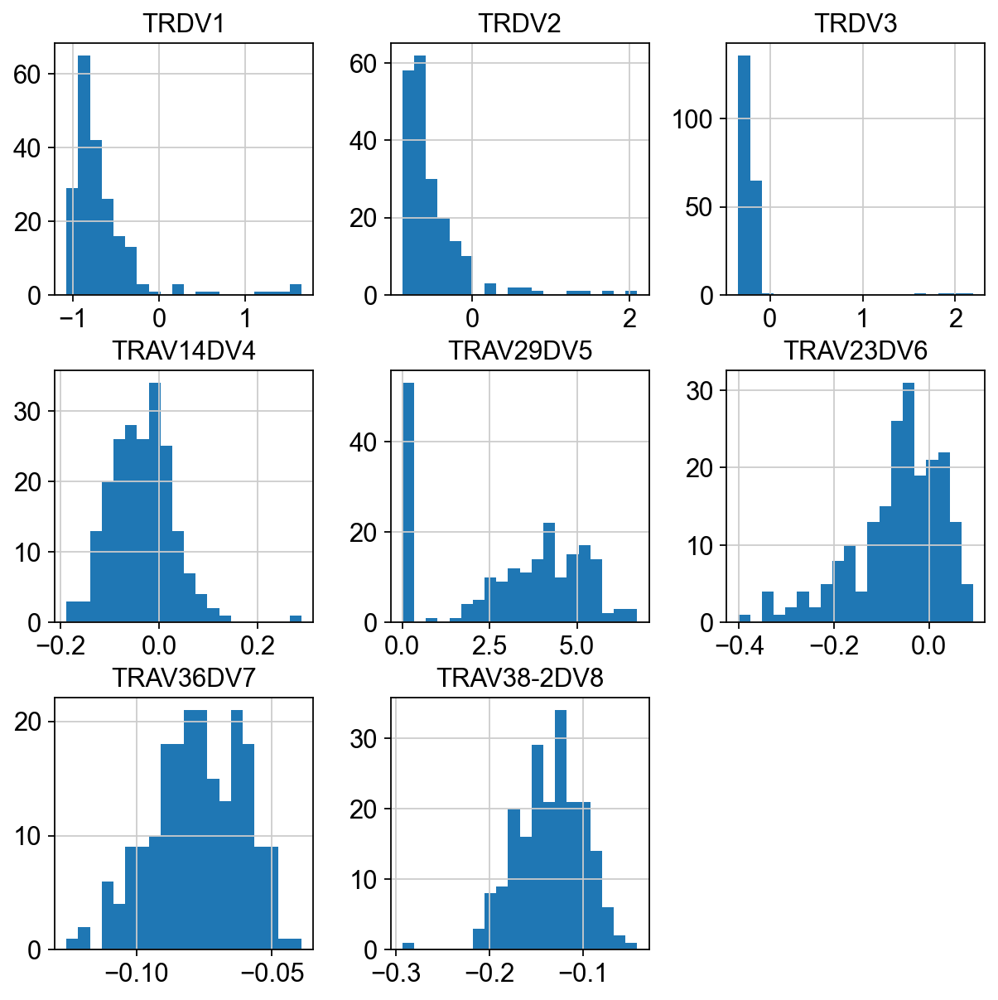

In [131]:
df.hist(figsize = (9, 9), bins = 20)

In [132]:
(df['TRAV29DV5'] > 0.5).value_counts()

True     153
False     53
Name: TRAV29DV5, dtype: int64

In [133]:
(df['TRAV29DV5'] > 1).value_counts()

True     152
False     54
Name: TRAV29DV5, dtype: int64

In [134]:
# benchmark 
adata.obs['single_trdv'].value_counts()

nan          1740
TRDV2         650
TRDV1         461
TRAV29DV5     111
TRDV3          59
TRAV36DV7       1
TRAV23DV6       1
TRAV14DV4       1
Name: single_trdv, dtype: int64

<AxesSubplot:>

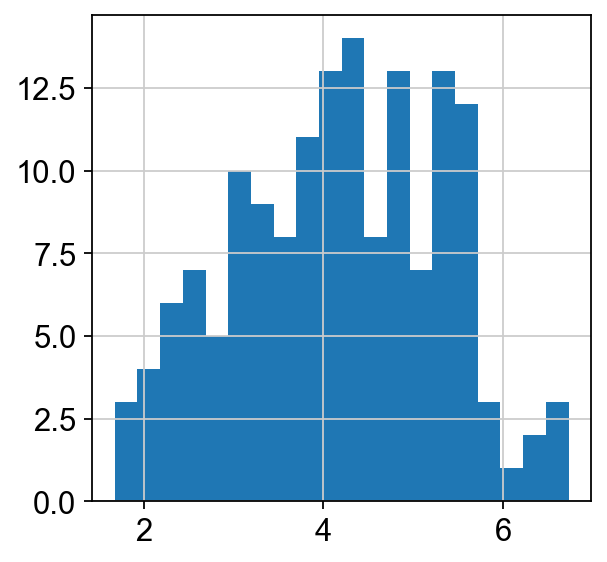

In [135]:
# 152 vs 111 (using cutoff: 1). good.
df['TRAV29DV5'][df['TRAV29DV5'] > 1].hist(bins = 20)

#### Next examine dv4, dv6, and dv8, keeping the baseline distributions in mind

In [136]:
# Examine dv4
df = pd.DataFrame(adata[adata.obs['max_trdv'] == 'TRAV14DV4', trdv_genes].X, columns = trdv_genes)
df

,TRDV1,TRDV2,TRDV3,TRAV14DV4,TRAV29DV5,TRAV23DV6,TRAV36DV7,TRAV38-2DV8
0,-0.702713,-0.541289,-0.240464,0.008154,-0.291670,-0.116111,-0.079376,-0.151528
1,-0.953380,-0.676380,-0.324013,0.025192,-0.638953,-0.064866,-0.057312,-0.131084
2,-0.268493,-0.082071,-0.195070,0.125422,-0.149359,-0.346303,-0.081873,-0.154830
3,-0.701753,-0.531662,-0.238165,0.017161,-0.312696,-0.123821,-0.080962,-0.158281
4,-0.312982,-0.121039,-0.226001,0.106801,-0.166119,-0.321000,-0.069176,-0.123134
...,...,...,...,...,...,...,...,...
219,-0.465178,-0.270438,-0.250653,0.071328,-0.237279,-0.246486,-0.064678,-0.115484
220,-0.299557,-0.153464,-0.182807,0.091135,-0.080004,-0.305187,-0.087076,-0.158108
221,-0.650129,-0.523560,-0.212160,0.000852,-0.201021,-0.122022,-0.088683,-0.165437
222,-0.450865,-0.295909,-0.191179,0.069670,-0.175002,-0.240555,-0.090884,-0.174661


array([[<AxesSubplot:title={'center':'TRDV1'}>,
        <AxesSubplot:title={'center':'TRDV2'}>,
        <AxesSubplot:title={'center':'TRDV3'}>],
       [<AxesSubplot:title={'center':'TRAV14DV4'}>,
        <AxesSubplot:title={'center':'TRAV29DV5'}>,
        <AxesSubplot:title={'center':'TRAV23DV6'}>],
       [<AxesSubplot:title={'center':'TRAV36DV7'}>,
        <AxesSubplot:title={'center':'TRAV38-2DV8'}>, <AxesSubplot:>]],
      dtype=object)

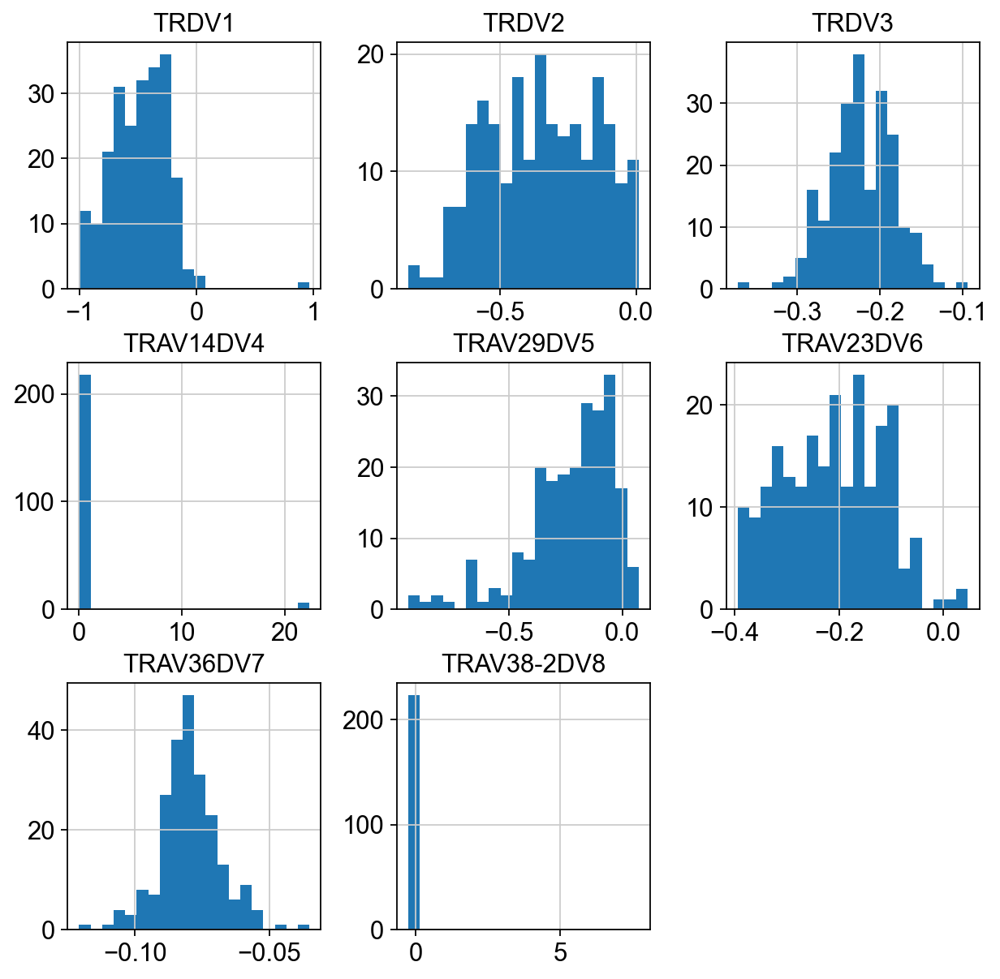

In [137]:
df.hist(figsize = (9, 9), bins = 20)

In [138]:
(df['TRAV14DV4'] > 0.5).value_counts()

False    218
True       6
Name: TRAV14DV4, dtype: int64

In [139]:
(df['TRAV14DV4'] > 10).value_counts()

False    218
True       6
Name: TRAV14DV4, dtype: int64

In [140]:
# benchmark 
adata.obs['single_trdv'].value_counts()

nan          1740
TRDV2         650
TRDV1         461
TRAV29DV5     111
TRDV3          59
TRAV36DV7       1
TRAV23DV6       1
TRAV14DV4       1
Name: single_trdv, dtype: int64

<AxesSubplot:>

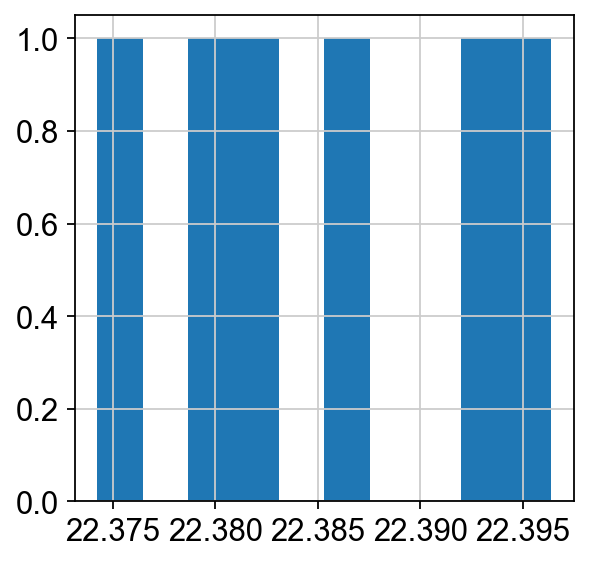

In [147]:
# 6 vs 1 (using cutoff: 0.5 or 10). good.
df['TRAV14DV4'][df['TRAV14DV4'] > 0.5].hist(bins = 10)

In [148]:
df['TRAV14DV4'][df['TRAV14DV4'] > 0.5]

55     22.386738
115    22.380198
122    22.392015
146    22.381836
188    22.374269
223    22.396383
Name: TRAV14DV4, dtype: float32

In [149]:
# Examine dv6
df = pd.DataFrame(adata[adata.obs['max_trdv'] == 'TRAV23DV6', trdv_genes].X, columns = trdv_genes)
df

,TRDV1,TRDV2,TRDV3,TRAV14DV4,TRAV29DV5,TRAV23DV6,TRAV36DV7,TRAV38-2DV8
0,-0.861546,-0.815689,-0.228444,-0.113677,-0.115161,0.040399,-0.086347,-0.141137
1,-0.888522,-0.787690,-0.295771,-0.104805,-0.214365,0.031036,-0.057785,-0.080250
2,-0.838230,-0.727583,-0.298839,-0.089469,-0.208676,0.001606,-0.054386,-0.072634
3,-0.963159,-0.891021,-0.308035,-0.148820,-0.179489,0.090476,-0.053748,-0.062919
4,-0.938381,-0.826173,-0.274052,-0.091623,-0.280673,0.038588,-0.071555,-0.122006
...,...,...,...,...,...,...,...,...
126,-0.954128,-0.849470,-0.323494,-0.126720,-0.240347,0.066277,-0.047600,-0.055382
127,-0.814793,-0.770563,-0.269471,-0.128860,-0.060924,0.032625,-0.063810,-0.078522
128,-0.974005,-0.849602,-0.301811,-0.101238,-0.310223,0.053836,-0.060370,-0.096100
129,-0.871767,-0.853722,-0.261788,-0.157327,-0.035113,0.076155,-0.068854,-0.086057


array([[<AxesSubplot:title={'center':'TRDV1'}>,
        <AxesSubplot:title={'center':'TRDV2'}>,
        <AxesSubplot:title={'center':'TRDV3'}>],
       [<AxesSubplot:title={'center':'TRAV14DV4'}>,
        <AxesSubplot:title={'center':'TRAV29DV5'}>,
        <AxesSubplot:title={'center':'TRAV23DV6'}>],
       [<AxesSubplot:title={'center':'TRAV36DV7'}>,
        <AxesSubplot:title={'center':'TRAV38-2DV8'}>, <AxesSubplot:>]],
      dtype=object)

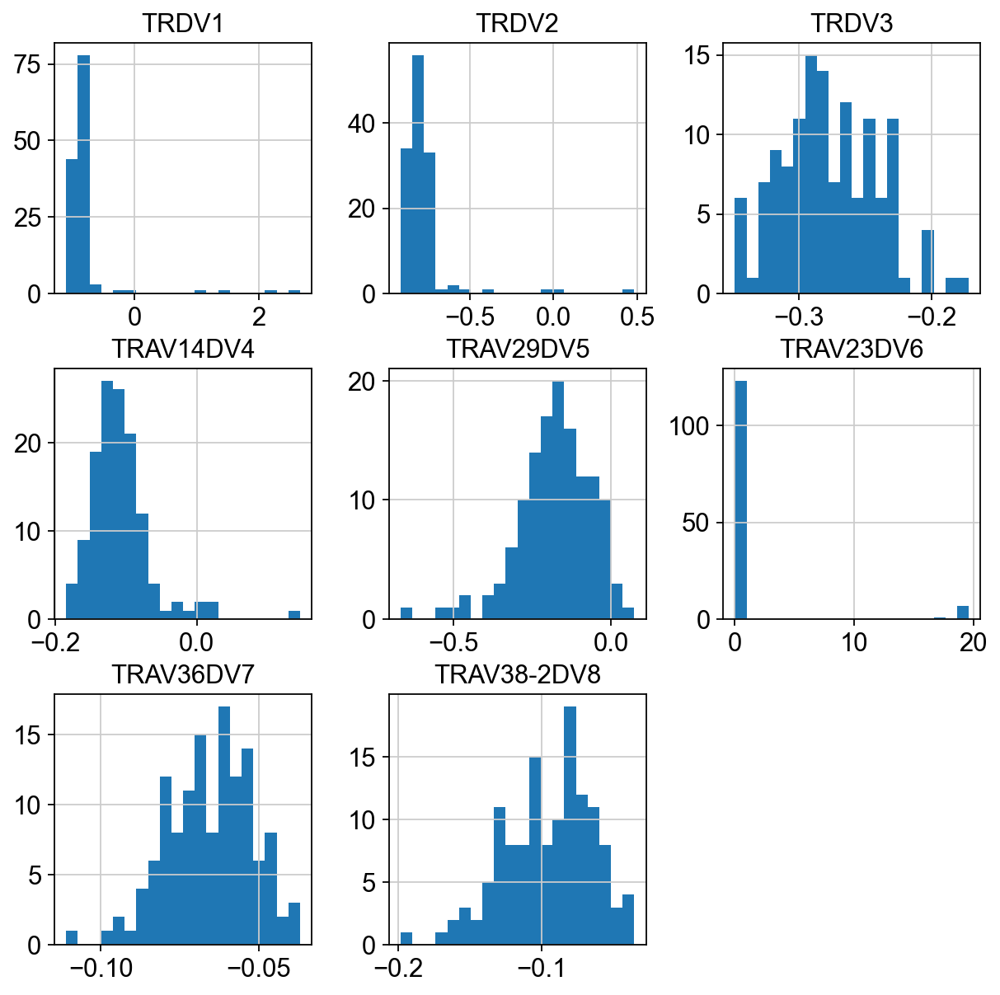

In [150]:
df.hist(figsize = (9, 9), bins = 20)

In [151]:
(df['TRAV23DV6'] > 0.5).value_counts()

False    123
True       8
Name: TRAV23DV6, dtype: int64

In [153]:
(df['TRAV23DV6'] > 10).value_counts()

False    123
True       8
Name: TRAV23DV6, dtype: int64

In [154]:
# benchmark 
adata.obs['single_trdv'].value_counts()

nan          1740
TRDV2         650
TRDV1         461
TRAV29DV5     111
TRDV3          59
TRAV36DV7       1
TRAV23DV6       1
TRAV14DV4       1
Name: single_trdv, dtype: int64

<AxesSubplot:>

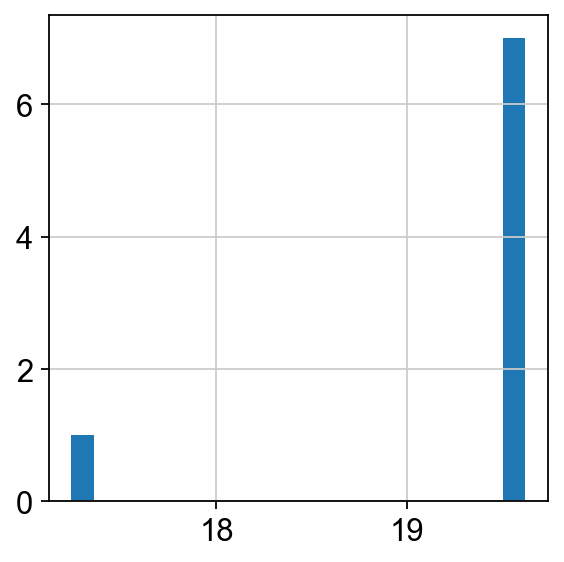

In [157]:
# 8 vs 1 (using cutoff: 1). good?
df['TRAV23DV6'][df['TRAV23DV6'] > 1].hist(bins = 20)

In [158]:
df['TRAV23DV6'][df['TRAV23DV6'] > 0.5]

16     19.614407
36     19.621235
45     19.618647
81     19.615732
92     19.615515
96     17.240002
98     19.616892
116    19.619436
Name: TRAV23DV6, dtype: float32

In [164]:
# Examine dv7
df = pd.DataFrame(adata[adata.obs['max_trdv'] == 'TRAV36DV7', trdv_genes].X, columns = trdv_genes)
df

,TRDV1,TRDV2,TRDV3,TRAV14DV4,TRAV29DV5,TRAV23DV6,TRAV36DV7,TRAV38-2DV8
0,0.788430,-0.615669,-0.267484,-0.016744,-0.319676,-0.074803,13.827182,-0.128504
1,-0.888134,0.909485,-0.257131,-0.047387,-0.336069,-0.012697,11.347442,-0.150265
2,-0.759328,-0.685290,-0.219151,-0.067128,-0.132445,-0.030315,13.806260,6.863410
3,0.905227,-0.595142,-0.234345,-0.026835,-0.207706,-0.080980,13.816506,-0.143566
4,0.445750,-0.771567,-0.311757,0.031627,-0.759045,-0.031876,7.458766,-0.175466
5,1.102330,-0.589965,-0.228417,-0.039028,-0.144736,-0.078254,13.814540,-0.137120
6,-0.636805,2.502622,-0.244675,0.035034,-0.302164,-0.160548,13.827803,-0.144755
7,-0.877277,1.877750,-0.271294,-0.022477,-0.401592,-0.039691,13.824301,-0.145087
8,-0.814582,0.793351,-0.218408,-0.065547,-0.189049,-0.014251,12.168548,-0.164798
9,-0.855645,-0.806616,2.327942,-0.116904,-0.110974,0.039305,13.807570,-0.123819


array([[<AxesSubplot:title={'center':'TRDV1'}>,
        <AxesSubplot:title={'center':'TRDV2'}>,
        <AxesSubplot:title={'center':'TRDV3'}>],
       [<AxesSubplot:title={'center':'TRAV14DV4'}>,
        <AxesSubplot:title={'center':'TRAV29DV5'}>,
        <AxesSubplot:title={'center':'TRAV23DV6'}>],
       [<AxesSubplot:title={'center':'TRAV36DV7'}>,
        <AxesSubplot:title={'center':'TRAV38-2DV8'}>, <AxesSubplot:>]],
      dtype=object)

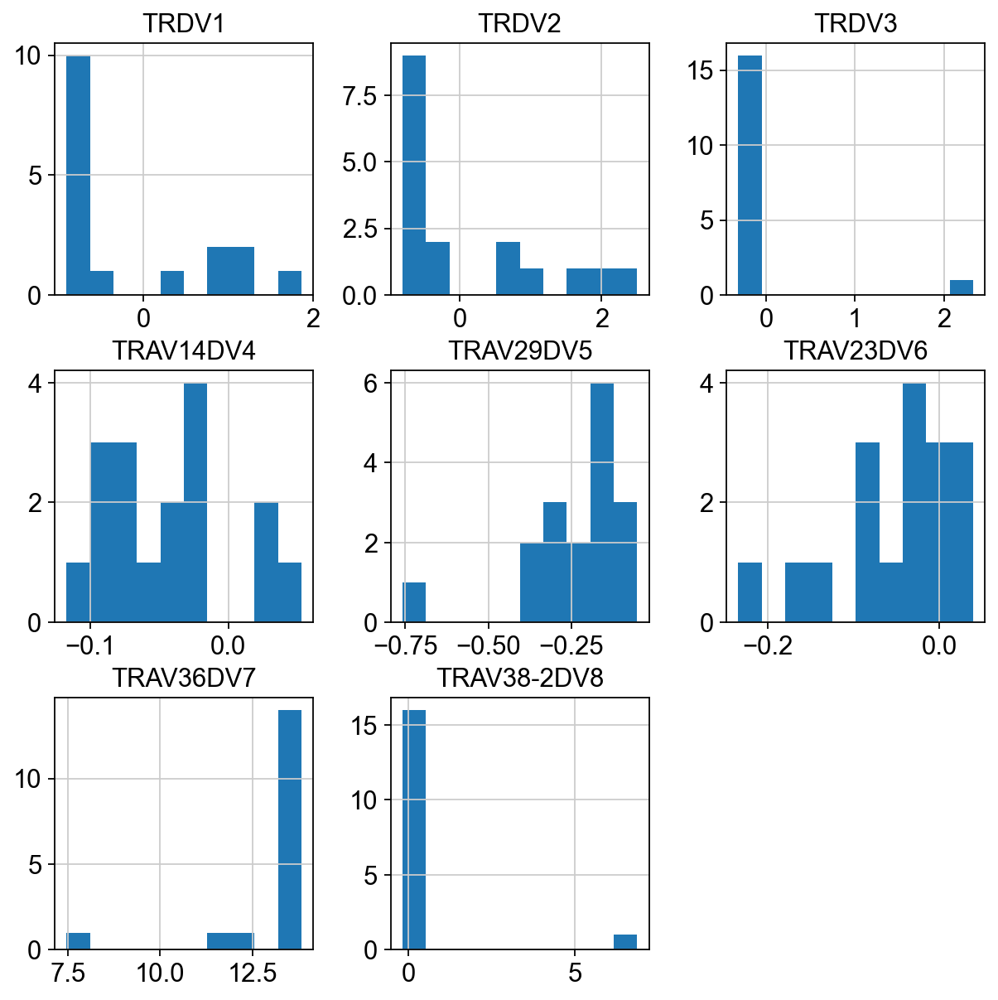

In [166]:
df.hist(figsize = (9, 9), bins = 10)

In [172]:
(df['TRAV36DV7'] > 0).value_counts()

True    17
Name: TRAV36DV7, dtype: int64

In [170]:
(df['TRAV36DV7'] > 5).value_counts()

True    17
Name: TRAV36DV7, dtype: int64

In [171]:
# benchmark 
adata.obs['single_trdv'].value_counts()

nan          1740
TRDV2         650
TRDV1         461
TRAV29DV5     111
TRDV3          59
TRAV36DV7       1
TRAV23DV6       1
TRAV14DV4       1
Name: single_trdv, dtype: int64

<AxesSubplot:>

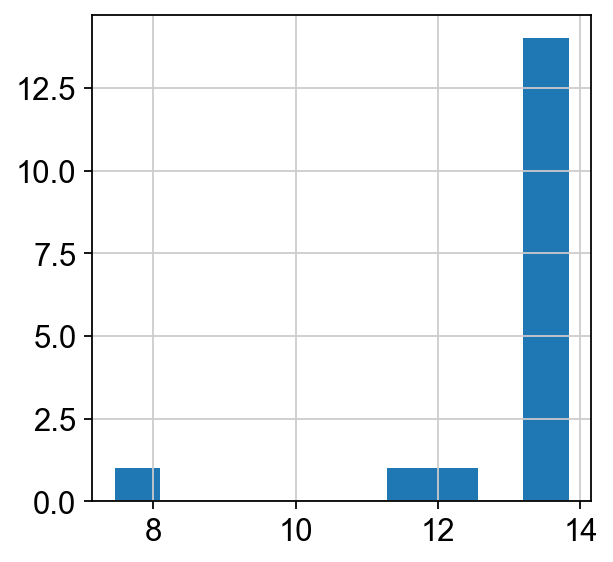

In [175]:
# 17 vs 1 (using cutoff: 0 or 5). good?
df['TRAV36DV7'].hist(bins = 10)  # no cutoff required

In [179]:
# Examine dv8
df = pd.DataFrame(adata[adata.obs['max_trdv'] == 'TRAV38-2DV8', trdv_genes].X, columns = trdv_genes)
df

,TRDV1,TRDV2,TRDV3,TRAV14DV4,TRAV29DV5,TRAV23DV6,TRAV36DV7,TRAV38-2DV8
0,-0.859288,-0.733497,-0.262990,-0.060836,-0.277433,-0.011038,-0.073906,9.822875
1,-0.568691,-0.450442,-0.196533,0.015087,-0.148668,-0.157437,-0.091891,6.045100
2,-0.006981,-0.668058,-0.234727,-0.038060,-0.249768,-0.048096,-0.084174,2.308495
3,-0.888010,-0.698349,-0.274432,-0.015191,-0.433355,-0.043078,-0.073399,9.272901
4,-0.897542,-0.758946,-0.303778,-0.077154,-0.301581,0.008839,-0.056485,8.357414
5,-0.455419,-0.336239,-0.181918,0.042195,-0.100337,-0.214067,-0.093580,9.563079
6,-0.799168,-0.758769,-0.236888,-0.112637,-0.064329,0.018682,-0.078829,6.889845
7,0.126082,-0.788061,-0.203509,-0.115582,-0.039083,0.028643,-0.094339,4.112100
8,-0.957401,-0.847703,-0.278851,-0.099477,-0.281860,0.050587,-0.069983,7.946621
9,-0.682589,-0.584913,-0.214596,-0.031257,-0.149647,-0.084565,-0.087398,6.119715


array([[<AxesSubplot:title={'center':'TRDV1'}>,
        <AxesSubplot:title={'center':'TRDV2'}>,
        <AxesSubplot:title={'center':'TRDV3'}>],
       [<AxesSubplot:title={'center':'TRAV14DV4'}>,
        <AxesSubplot:title={'center':'TRAV29DV5'}>,
        <AxesSubplot:title={'center':'TRAV23DV6'}>],
       [<AxesSubplot:title={'center':'TRAV36DV7'}>,
        <AxesSubplot:title={'center':'TRAV38-2DV8'}>, <AxesSubplot:>]],
      dtype=object)

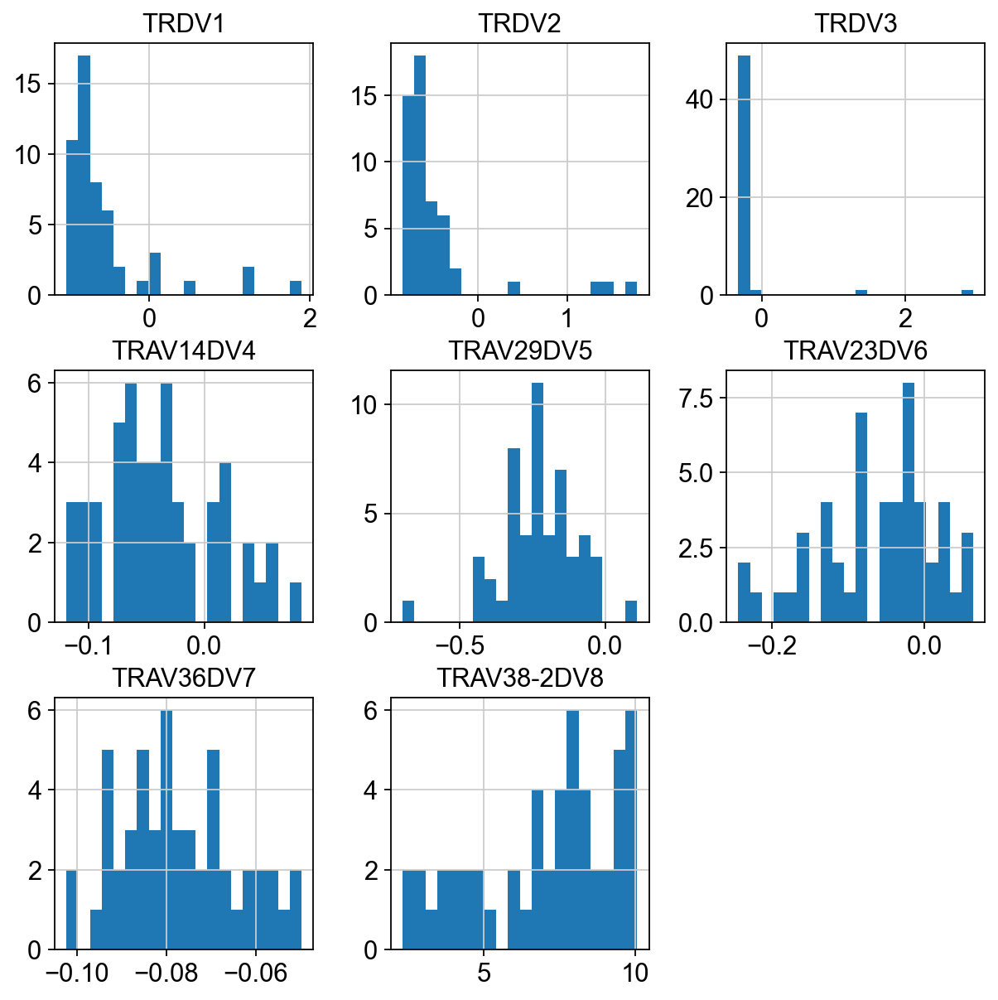

In [180]:
df.hist(figsize = (9, 9), bins = 20)

In [185]:
(df['TRAV38-2DV8'] > 0).value_counts()

True    52
Name: TRAV38-2DV8, dtype: int64

In [186]:
(df['TRAV38-2DV8'] > 2).value_counts()

True    52
Name: TRAV38-2DV8, dtype: int64

In [171]:
# benchmark 
adata.obs['single_trdv'].value_counts()

nan          1740
TRDV2         650
TRDV1         461
TRAV29DV5     111
TRDV3          59
TRAV36DV7       1
TRAV23DV6       1
TRAV14DV4       1
Name: single_trdv, dtype: int64

<AxesSubplot:>

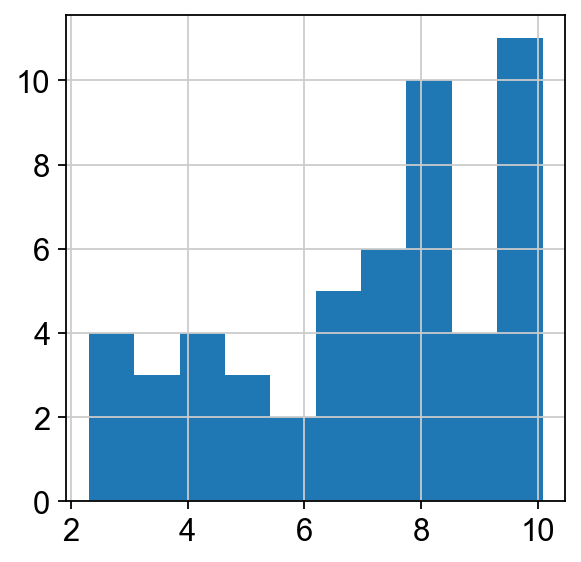

In [184]:
# 52 vs 1 (using cutoff: 0 or 2). good?
df['TRAV38-2DV8'].hist(bins = 10)  # no cutoff required

### Tue Mar 9 (post-meeting) - Don't use a cutoff!

In [6]:
trdv_genes = ['TRDV1', 'TRDV2', 'TRDV3', 'TRAV14DV4', 'TRAV29DV5', 'TRAV23DV6', 'TRAV36DV7', 'TRAV38-2DV8']
df = pd.DataFrame(adata[:, trdv_genes].X, columns = trdv_genes)
df

,TRDV1,TRDV2,TRDV3,TRAV14DV4,TRAV29DV5,TRAV23DV6,TRAV36DV7,TRAV38-2DV8
0,1.733922,-0.645546,-0.244023,-0.035973,-0.244889,-0.056937,-0.078989,-0.142141
1,0.492303,-0.509563,-0.209276,0.016666,-0.243020,-0.134350,-0.091204,-0.177123
2,-0.906340,2.326294,-0.258707,-0.150294,-0.084460,0.081396,-0.072790,-0.101172
3,-0.702713,-0.541289,-0.240464,0.008154,-0.291670,-0.116111,-0.079376,-0.151528
4,-0.757303,-0.561266,-0.290666,0.003467,4.537034,-0.102555,-0.059396,-0.108707
...,...,...,...,...,...,...,...,...
3019,-0.450865,-0.295909,-0.191179,0.069670,-0.175002,-0.240555,-0.090884,-0.174661
3020,-0.786273,-0.635799,-0.262172,-0.026610,-0.296664,-0.063269,-0.072167,-0.130916
3021,1.741261,-0.689894,-0.277407,-0.022635,-0.398177,-0.042944,-0.070438,-0.136600
3022,-0.927502,-0.816649,-0.296724,22.396383,-0.257527,0.041446,-0.059806,-0.089550


array([[<AxesSubplot:title={'center':'TRDV1'}>,
        <AxesSubplot:title={'center':'TRDV2'}>,
        <AxesSubplot:title={'center':'TRDV3'}>],
       [<AxesSubplot:title={'center':'TRAV14DV4'}>,
        <AxesSubplot:title={'center':'TRAV29DV5'}>,
        <AxesSubplot:title={'center':'TRAV23DV6'}>],
       [<AxesSubplot:title={'center':'TRAV36DV7'}>,
        <AxesSubplot:title={'center':'TRAV38-2DV8'}>, <AxesSubplot:>]],
      dtype=object)

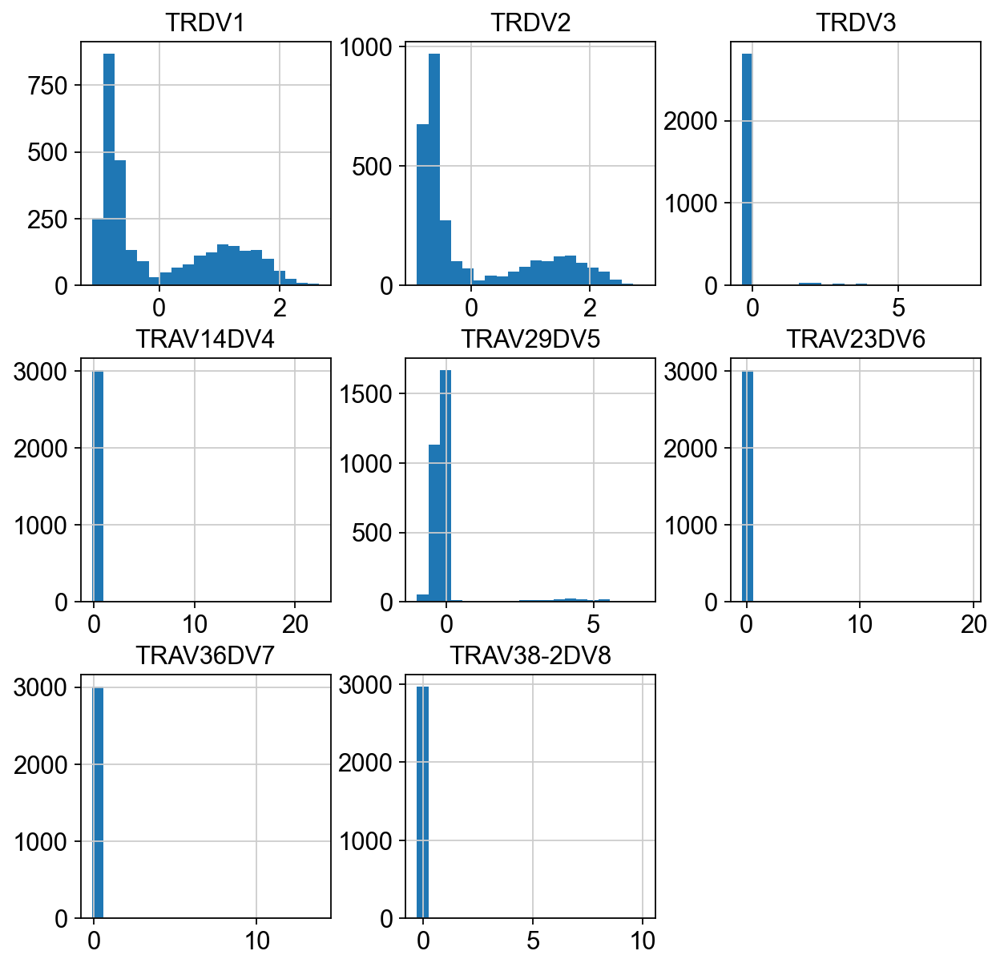

In [8]:
df.hist(figsize = (9, 9), bins = 20)

In [9]:
# label by max trdv expr
max_trdv_counts = df.idxmax(axis = 1).value_counts()
max_trdv_counts

TRDV1          1081
TRDV2           857
TRAV14DV4       386
TRAV29DV5       220
TRAV23DV6       218
TRDV3           191
TRAV38-2DV8      52
TRAV36DV7        19
dtype: int64

In [ ]:
# filter out cells where all trdv genes < 0.5
max_trdv_counts_w_cutoff = df[df > 0.5].idxmax(axis = 1).value_counts()

# add 'nan' counts back in
n = adata.shape[0] - sum(max_trdv_counts_w_cutoff)
nan_count = pd.Series(n, index = ['nan'])
max_trdv_counts_w_cutoff = max_trdv_counts_w_cutoff.append(nan_count)

max_trdv_counts_w_cutoff

In [10]:
# compare counts
d = {'single_trdv': adata.obs['single_trdv'].value_counts(),
     'max_trdv': max_trdv_counts}
#     'max_trdv_cutoff': max_trdv_counts_w_cutoff,
     
counts = pd.DataFrame(d, index = trdv_genes + ['nan'], dtype='int64')
counts[counts.isnull()] = 0
counts = counts.astype('int64')
counts

,single_trdv,max_trdv
TRDV1,461,1081
TRDV2,650,857
TRDV3,59,191
TRAV14DV4,1,386
TRAV29DV5,111,220
TRAV23DV6,1,218
TRAV36DV7,1,19
TRAV38-2DV8,0,52
nan,1740,0


In [11]:
# compare proportions
proportions = round(counts / adata.shape[0] * 100, 1)
proportions

,single_trdv,max_trdv
TRDV1,15.2,35.7
TRDV2,21.5,28.3
TRDV3,2.0,6.3
TRAV14DV4,0.0,12.8
TRAV29DV5,3.7,7.3
TRAV23DV6,0.0,7.2
TRAV36DV7,0.0,0.6
TRAV38-2DV8,0.0,1.7
nan,57.5,0.0


### Create labels

In [22]:
max_trdv = df.idxmax(axis = 1)
max_trdv.value_counts()

TRDV1          1081
TRDV2           857
TRAV14DV4       386
TRAV29DV5       220
TRAV23DV6       218
TRDV3           191
TRAV38-2DV8      52
TRAV36DV7        19
dtype: int64

In [24]:
adata.obs['max_trdv_v2'] = pd.Categorical(np.array(max_trdv),
                                      categories = trdv_genes)
adata.obs['max_trdv_v2'].value_counts()

TRDV1          1081
TRDV2           857
TRAV14DV4       386
TRAV29DV5       220
TRAV23DV6       218
TRDV3           191
TRAV38-2DV8      52
TRAV36DV7        19
Name: max_trdv_v2, dtype: int64

In [25]:
temp = np.array(adata.obs['max_trdv_v2'])
temp[temp == 'TRDV2'] = 'Vd2+'
temp[np.all([(temp != 'Vd2+'), (temp != 'nan')], axis=0)] = 'Vd2-'
adata.obs['max_trdv2_v2'] = temp
adata.obs['max_trdv2_v2'].value_counts()

Vd2-    2167
Vd2+     857
Name: max_trdv2_v2, dtype: int64

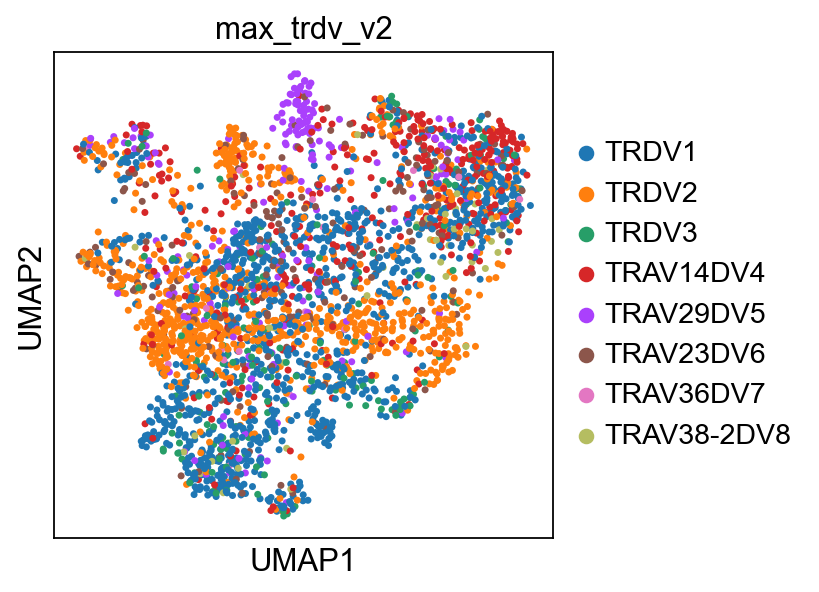

In [32]:
sc.pl.umap(adata, color=['max_trdv_v2'])

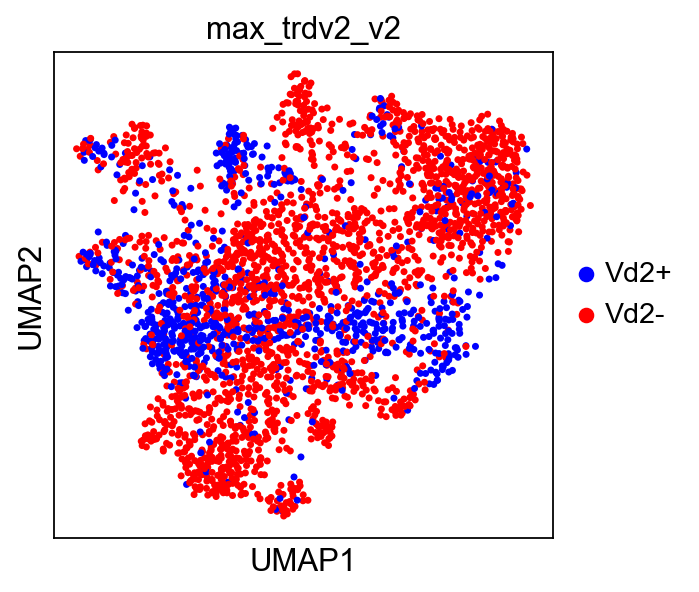

In [31]:
sc.pl.umap(adata, color=['max_trdv2_v2'], palette=['blue', 'red'])

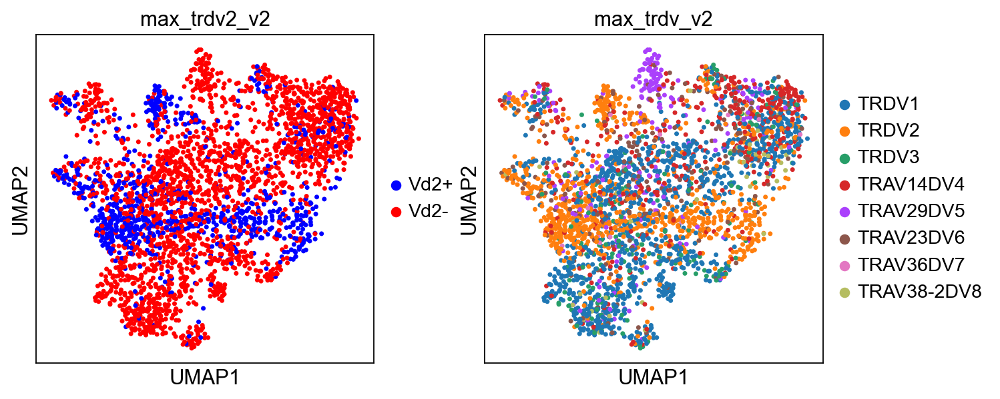

In [33]:
sc.pl.umap(adata, color=['max_trdv2_v2', 'max_trdv_v2'],
          save='_max_trdv_v2')

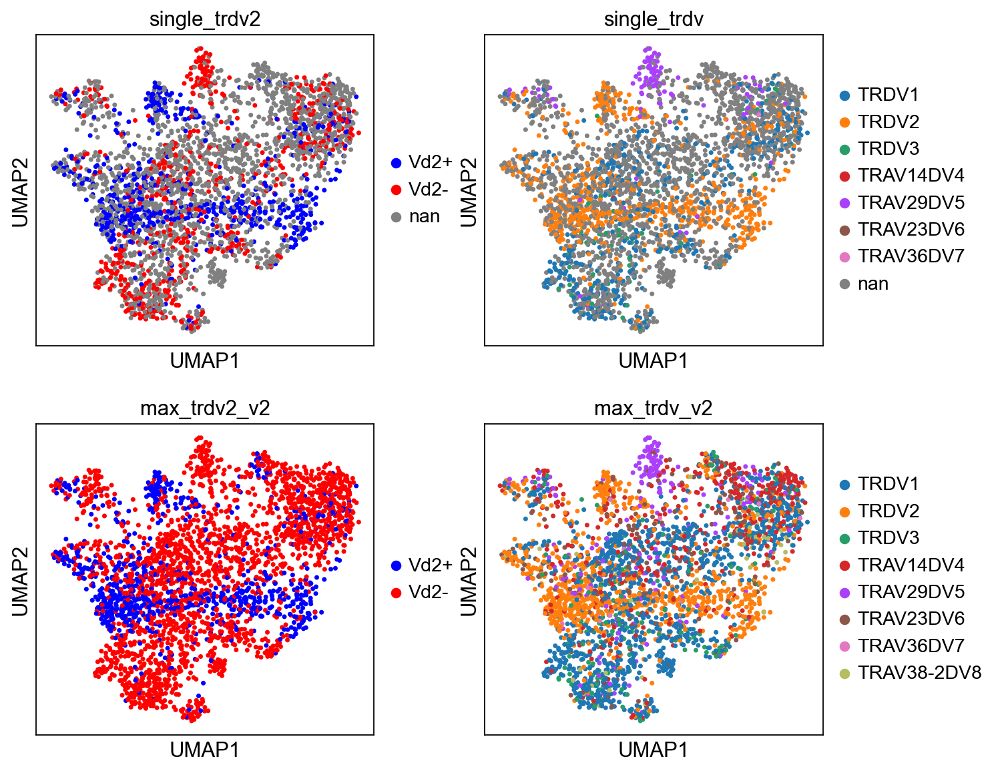

In [34]:
sc.pl.umap(adata, color=['single_trdv2', 'single_trdv', 
                         'max_trdv2_v2', 'max_trdv_v2'], ncols=2,
          save='_max_trdv_v2_comparison')

In [35]:
adata.write(results_file)

## 15. Mar 10, 2021 <a class='anchor' id='15'></a>

[Table of contents](#toc)

In [6]:
adata = sc.read(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_colors', 'trdv_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

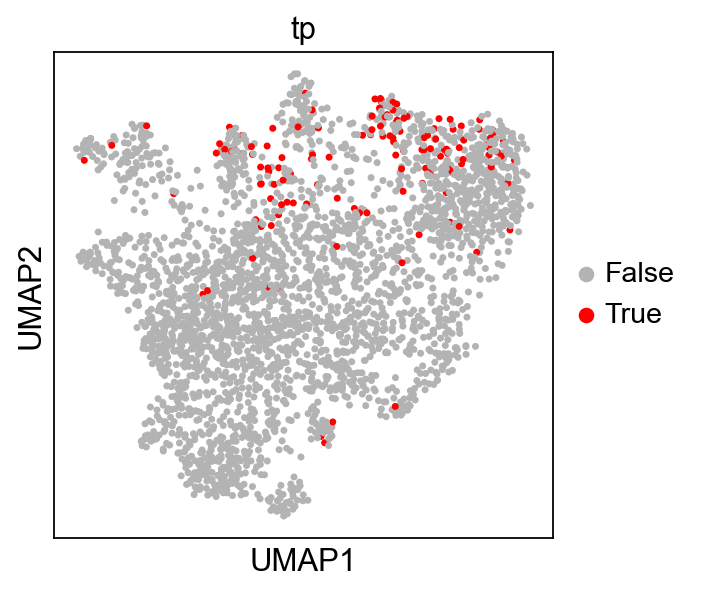

In [23]:
sc.pl.umap(adata, color='tp', palette=['#b3b3b3', 'red'])

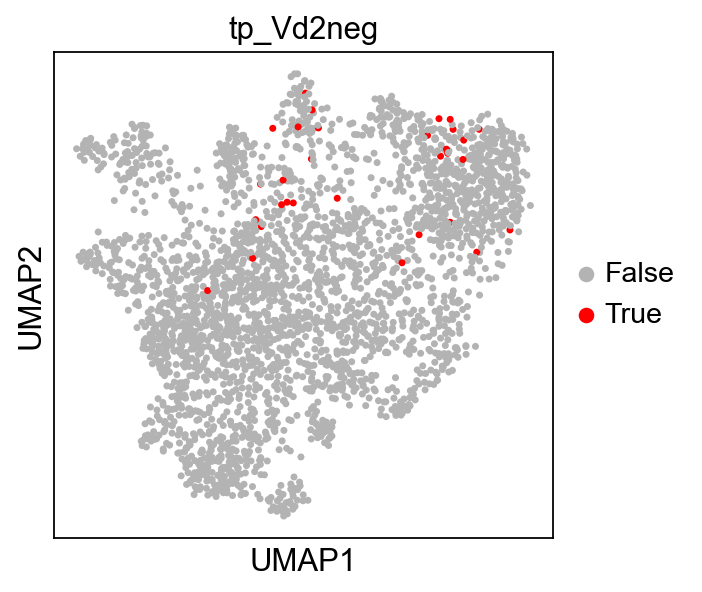

In [25]:
sc.pl.umap(adata, color='tp_Vd2neg', palette=['#b3b3b3', 'red'])

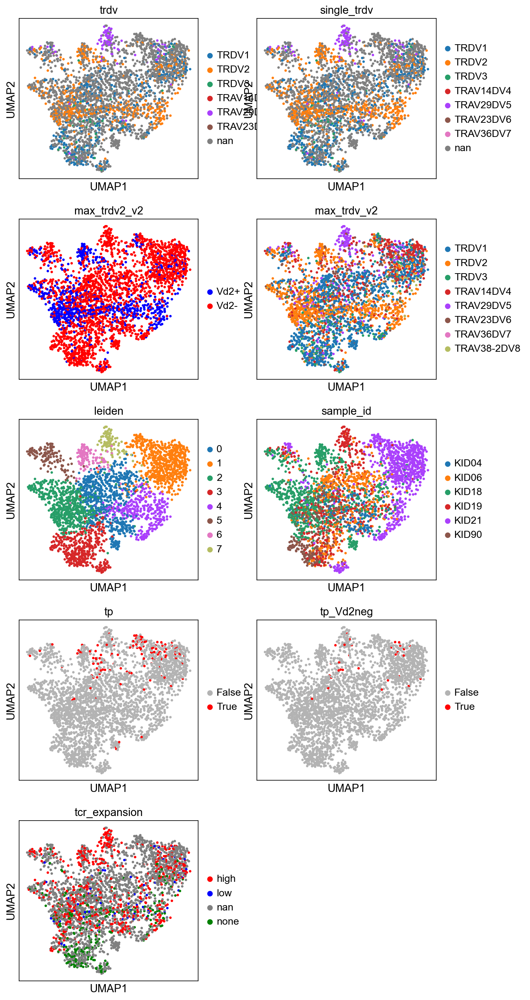

In [28]:
sc.pl.umap(adata, color=['trdv', 'single_trdv', 
                         'max_trdv2_v2', 'max_trdv_v2', 
                         'leiden', 'sample_id', 
                         'tp', 'tp_Vd2neg',
                        'tcr_expansion'], ncols = 2)

### Define tp_Vd2neg_v2 using new trdv2 labels

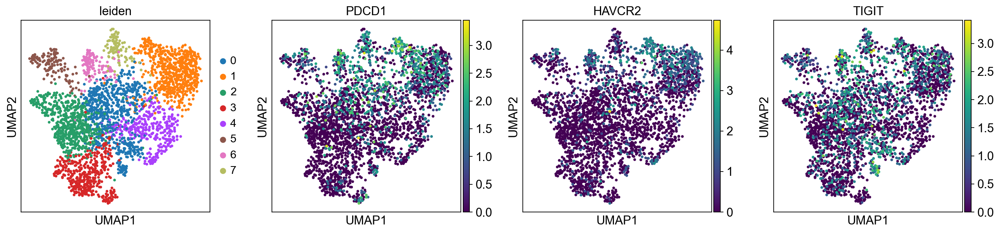

In [26]:
sc.pl.umap(adata, color=['leiden', 'PDCD1', 'HAVCR2', 'TIGIT'])

#### Reexamine 'tp' label

In [41]:
adata.obs['tp'].value_counts()

False    2887
True      137
Name: tp, dtype: int64

In [43]:
# percent 'triple positive'
print(137/2887 * 100)

4.745410460685833


In [38]:
cutoff = 0.5
print(np.unique(np.array(adata[:, 'PDCD1'].X > cutoff), return_counts = True))
print(np.unique(np.array(adata[:, 'HAVCR2'].X > cutoff), return_counts = True))
print(np.unique(np.array(adata[:, 'TIGIT'].X > cutoff), return_counts = True))

(array([False,  True]), array([2261,  763]))
(array([False,  True]), array([2419,  605]))
(array([False,  True]), array([2146,  878]))


In [39]:
# percent 'single' positive
print(763/3024 * 100)
print(605/3024 * 100)
print(878/3024 * 100)

25.23148148148148
20.006613756613756
29.034391534391535


#### 11.2.1 - Gene signature of all TP cells (for reference)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


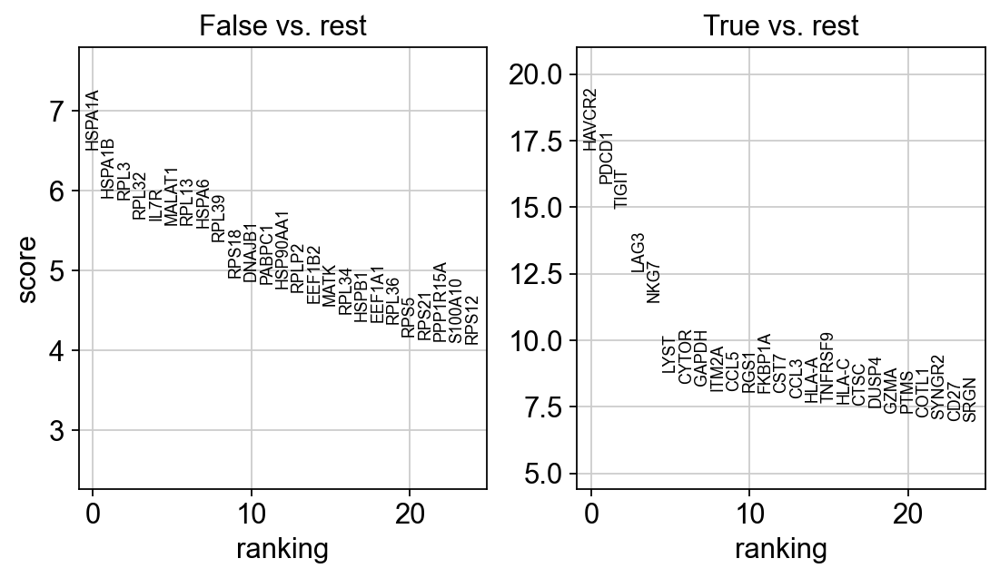

In [292]:
sc.tl.rank_genes_groups(adata, 'tp', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [293]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
df = pd.DataFrame(
    {group + '_' + key[:4]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj', 'logfoldchanges']})
df.to_csv('outputs/markers_tp.csv', index=False)
df.head(10)

,False_name,False_pval,False_logf,True_name,True_pval,True_logf
0,HSPA1A,3.336265e-08,2.053025,HAVCR2,5.638133e-62,3.866431
1,HSPA1B,1.093855e-06,1.811884,PDCD1,4.040694e-53,3.333630
2,RPL3,1.231782e-06,0.218768,TIGIT,7.085679e-47,2.976416
3,RPL32,4.610464e-06,0.220574,LAG3,9.276732e-33,2.412532
4,IL7R,4.936212e-06,4.482817,NKG7,8.032999e-27,1.596216
5,MALAT1,6.876931e-06,0.438864,LYST,3.024570e-15,1.681555
6,RPL13,6.876931e-06,0.210289,CYTOR,1.114196e-13,1.501552
7,HSPA6,7.555146e-06,2.291837,GAPDH,1.866505e-13,0.871433
8,RPL39,1.807849e-05,0.153757,ITM2A,8.341235e-13,1.484625
9,RPS18,1.558001e-04,0.222091,CCL5,8.359060e-13,0.827681


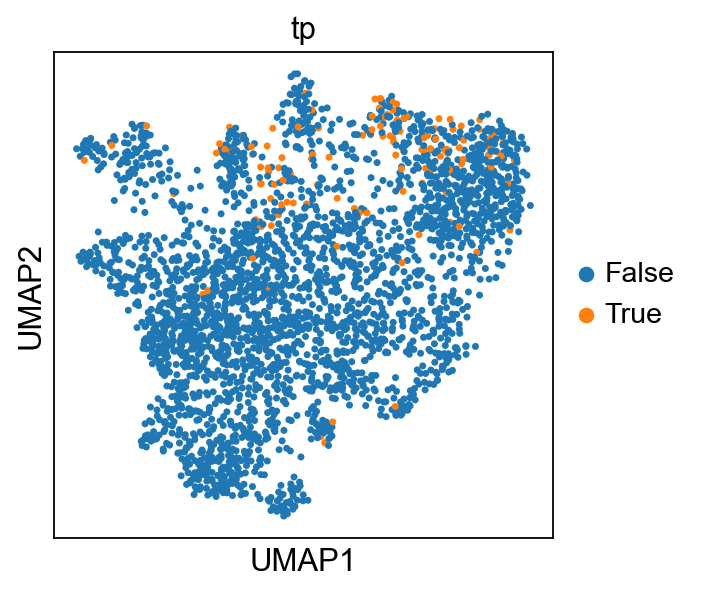

In [294]:
sc.pl.umap(adata, color='tp', save='_tp_gt0.5')

#### 11.2.2 - Generate tp_Vd2neg_v2 gene signature (v2, using max_trdv labels)

In [75]:
# define 'triple positive' (TP) cells as cells with PDCD1, HAVCR2, and TIGIT values > 0.5
adata.obs['tp_Vd2neg_v2'] = \
np.array(adata.obs['tp'] == 'True') & \
np.array(adata.obs['max_trdv_v2'] != 'TRDV2') & \
np.array(adata.obs['max_trdv_v2'] != 'nan')
adata.obs['tp_Vd2neg_v2'] = adata.obs['tp_Vd2neg_v2'].astype('category')

print(adata.obs['tp'].value_counts())
print(adata.obs['tp_Vd2neg_v2'].value_counts())

False    2887
True      137
Name: tp, dtype: int64
False    2921
True      103
Name: tp_Vd2neg_v2, dtype: int64


In [76]:
print(137 / adata.n_obs * 100)
print(103 / adata.n_obs * 100)

4.530423280423281
3.4060846560846563


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


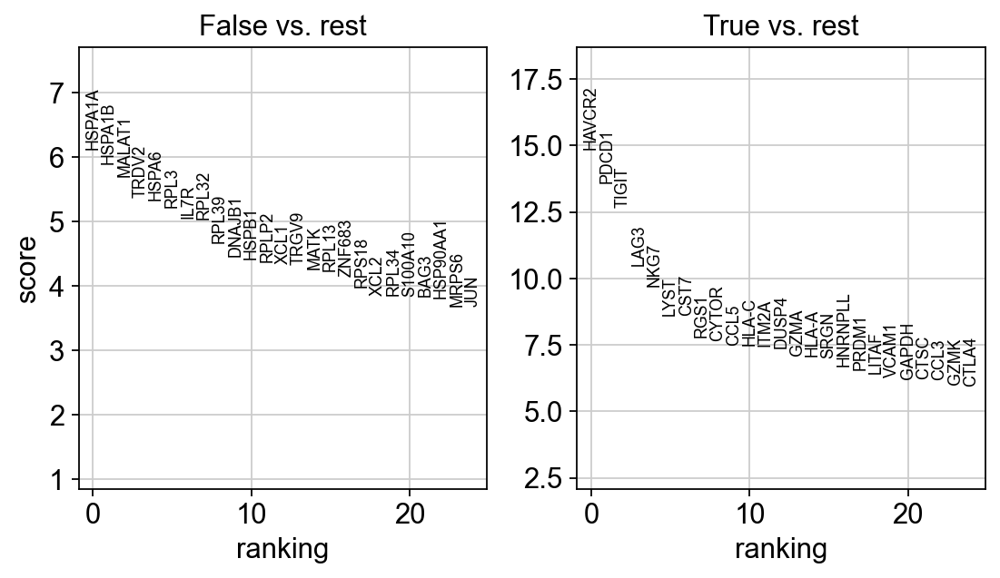

In [89]:
sc.tl.rank_genes_groups(adata, 'tp_Vd2neg_v2', method='wilcoxon', n_genes = 500)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [90]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
df = pd.DataFrame(
    {group + '_' + key[:4]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj', 'logfoldchanges']})
df.to_csv('outputs/markers_tp_Vd2neg_v2.csv', index=False)
df.head(10)

,False_name,False_pval,False_logf,True_name,True_pval,True_logf
0,HSPA1A,5.801860e-07,2.266654,HAVCR2,8.580461e-46,3.811680
1,HSPA1B,2.085485e-06,2.091378,PDCD1,4.045787e-38,3.228813
2,MALAT1,5.919278e-06,0.505919,TIGIT,4.506457e-33,2.840866
3,TRDV2,3.024323e-05,5.451016,LAG3,4.250669e-22,2.293268
4,HSPA6,3.696495e-05,2.609984,NKG7,1.075831e-18,1.537507
5,RPL3,5.912601e-05,0.213390,LYST,1.674114e-14,1.865185
6,IL7R,1.388738e-04,5.289827,CST7,1.674114e-14,1.290906
7,RPL32,1.388738e-04,0.254319,RGS1,1.459378e-11,1.952153
8,RPL39,7.288659e-04,0.181489,CYTOR,3.874765e-11,1.564568
9,DNAJB1,1.726920e-03,1.385863,CCL5,1.197630e-10,0.868854


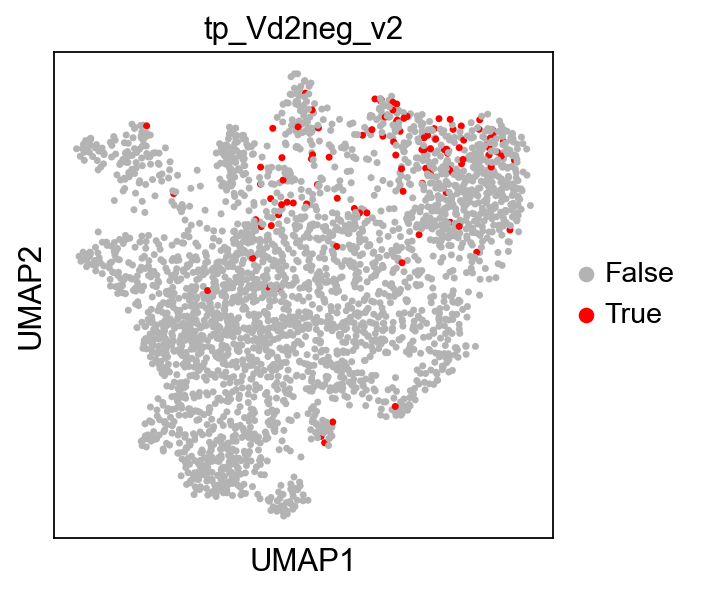

In [91]:
sc.pl.umap(adata, color='tp_Vd2neg_v2', save='_tp_Vd2neg_v2', palette=['#b3b3b3', 'red'])

#### Check patient distributions

In [80]:
adata[adata.obs['leiden_0.6'] == '7', ].obs['sample_id'].value_counts()  # KID 19 dominated

KID19    89
KID21     5
KID06     5
KID18     2
Name: sample_id, dtype: int64

In [87]:
adata[adata.obs['tp'] == 'True', ].obs['sample_id'].value_counts() # skewed toward KID 21 and KID 18

KID21    72
KID18    33
KID19    19
KID06     8
KID90     5
Name: sample_id, dtype: int64

In [88]:
adata[adata.obs['tp_Vd2neg'] == 'True', ].obs['sample_id'].value_counts()  # skewered toward KID 21 and KID 19

KID21    14
KID19    11
KID06     4
KID18     2
Name: sample_id, dtype: int64

In [83]:
adata[adata.obs['tp_Vd2neg_v2'] == True, ].obs['sample_id'].value_counts()  # most new cells from KID 21 (and KID 19)

KID21    63
KID19    18
KID18     9
KID06     8
KID90     5
Name: sample_id, dtype: int64

In [92]:
adata.write(results_file)

## 16. Sep 2, 2021 <a class='anchor' id='16'></a>

[Table of contents](#toc)

In [6]:
adata = sc.read(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2neg_v2_colors', 'tp_colors', 'trdv_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

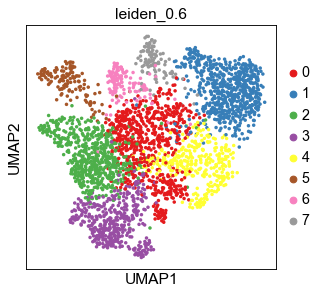

In [8]:
sc.pl.umap(adata, color = ['leiden_0.6'])

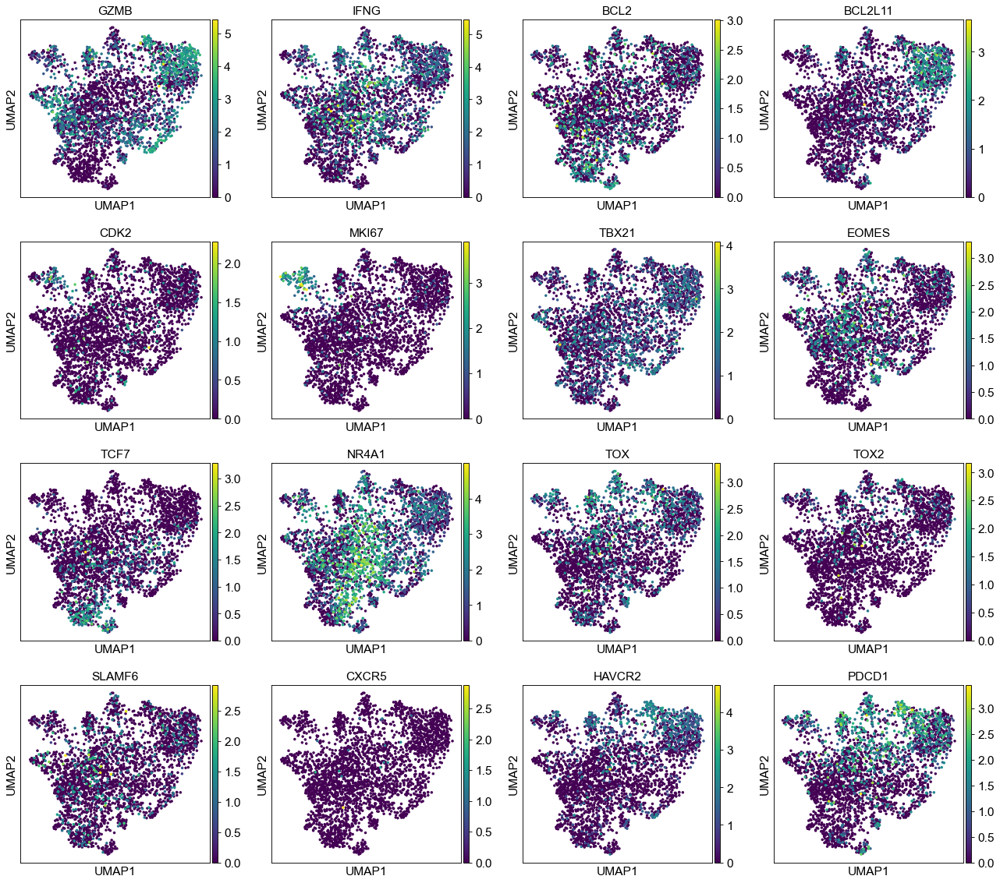

In [14]:
sc.pl.umap(adata, color = ['GZMB', 'IFNG', 'BCL2', 'BCL2L11', # cytotox, cytokines
                           'CDK2', 'MKI67', 'TBX21', 'EOMES', # TFs
                           'TCF7', 'NR4A1', 'TOX', 'TOX2', # TFs
                           'SLAMF6', 'CXCR5', 'HAVCR2', 'PDCD1'], # inhib receptors
          save = '_markers_chen_2019')

In [15]:
bengsch_2018_exh_sig = ['ABI3',	'ABR',	'ACADL',	'ACE',	'ACOD1',	'ACOT11',	'ACSBG1',	'ADA',	'ADAM19',	'ADAM9',	'ADAMTS9',	'ADGRE4P',	'ADGRG1',	'ADRBK2',	'AFMID',	'AGPAT3',	'AHI1',	'AIDA',	'AK3',	'AKR1B10',	'AKR1E2',	'ALCAM',	'ALOX5AP',	'ALS2',	'ANK3',	'ANXA3',	'APAF1',	'APLP2',	'APOBEC2',	'APOC2',	'AREG',	'ARHGEF12',	'ARID3A',	'ARL5A',	'ARMCX3',	'ARSB',	'ART3',	'ASAP2',	'ASPRV1',	'ATMIN',	'ATP6V0A1',	'ATP8A2',	'ATPIF1',	'ATXN1',	'B4GALT4',	'BANK1',	'BHLHE41',	'BLNK',	'BTK',	'C10orf128',	'C12orf71',	'C1orf54',	'C5AR1',	'C6orf141',	'C7orf49',	'CACNA1E',	'CALCB',	'CAMP',	'CASP1',	'CASP3',	'CASP4',	'CCDC109B',	'CCDC112',	'CCDC146',	'CCDC66',	'CCDC88A',	'CCNYL1',	'CCRL2',	'CD14',	'CD19',	'CD200R1',	'CD200R1L',	'CD200R1L',	'CD24',	'CD244',	'CD300LD',	'CD302',	'CD36',	'CD38',	'CD7',	'CD80',	'CD81',	'CD83',	'CD86',	'CDC14A',	'CDK14',	'CDK6',	'CDKN2C',	'CEACAM1',	'CELA1',	'CENPQ',	'CEP128',	'CERS6',	'CGGBP1',	'CHIT1',	'CHN2',	'CHST11',	'CHST12',	'CHST2',	'CIB2',	'CKAP4',	'CLEC4E',	'CLGN',	'CMKLR1',	'CNRIP1',	'CNTLN',	'CNTN5',	'CORO2A',	'CPEB2',	'CRIP2',	'CRMP1',	'CSF1R',	'CSF2RA',	'CSPP1',	'CTLA4',	'CTSC',	'CXCL10',	'CXCL3',	'CXCR5',	'CXorf56',	'CYBB',	'CYFIP1',	'CYP4F2',	'CYP4V2',	'DAPK2',	'DCLK2',	'DCLRE1C',	'DCUN1D4',	'DENND5B',	'DERL3',	'DHX58',	'DOCK6',	'DOCK7',	'DPCR1',	'DTX3',	'DUSP4',	'DZANK1',	'EAF2',	'EEA1',	'EGR1',	'EHD4',	'EIF2AK2',	'EIF4E3',	'ENDOU',	'ENPP1',	'ENPP2',	'ENPP5',	'ENPP6',	'ENTPD1',	'EOMES',	'F10',	'FABP1',	'FABP4',	'FABP7',	'FAIM',	'FAM129A',	'FAM185A',	'FAM208A',	'FAM81A',	'FAM84A',	'FANCD2',	'FANCD2OS',	'FAXC',	'FCER1G',	'FGD4',	'FGL2',	'FGR',	'FILIP1',	'FN1',	'FPR2',	'FPR3',	'FRY',	'FYN',	'GABARAPL1',	'GAS7',	'GCA',	'GCNT1',	'GFPT1',	'GFRAL',	'GGTA1P',	'GJB2',	'GLCCI1',	'GLP1R',	'GNAS',	'GNB4',	'GNG3',	'GNGT2',	'GNPDA2',	'GNS',	'GPD2',	'GPM6A',	'GPR137B',	'GPR155',	'GPR52',	'GPR65',	'GPRC5A',	'GRB7',	'GSTA4',	'GVINP1',	'GXYLT1',	'GZMK',	'HAUS3',	'HCK',	'HDC',	'HELZ2',	'HERC6',	'HHEX',	'HIP1',	'HLA-DQB1',	'HLA-DRB5',	'HMGB2',	'HMGN3',	'HP',	'HSPA13',	'HSPA4L',	'HYAL2',	'ICA1',	'IDH1',	'IER5L',	'IFI16',	'IFI16',	'IFI16',	'IFI27',	'IFI44',	'IFIH1',	'IFIT1B',	'IFIT3',	'IFITM2',	'IFITM3',	'IKBIP',	'IKZF2',	'IKZF3',	'IL10',	'IL10RA',	'IL13RA1',	'IL15RA',	'IL21',	'IL2RB',	'IL6',	'IL7',	'ILDR1',	'INHBA',	'IQCA1',	'IRAK2',	'ISG15',	'ISG20',	'ITGA2',	'ITGAM',	'ITGAV',	'ITGB1BP1',	'ITGB8',	'ITIH5',	'JDP2',	'KAZALD1',	'KCNIP3',	'KCTD9',	'KIAA0196',	'KIF13B',	'KIF5C',	'KLKB1',	'KLRB1',	'KYNU',	'LAG3',	'LAMP2',	'LAT2',	'LAX1',	'LCLAT1',	'LCN2',	'LGALS3',	'LGALS4',	'LGALSL',	'LILRB3',	'LIM2',	'LITAF',	'LMO1',	'LOC728392',	'LOC81691',	'LPCAT4',	'LRRC8C',	'LRRK2',	'LTF',	'LYZ',	'MAFG',	'MAGEE1',	'MAP2',	'MAP6',	'MCEMP1',	'MDFIC',	'MEF2C',	'MEF2D',	'METRNL',	'MGST1',	'MKRN2',	'MLKL',	'MMD',	'MMP8',	'MPEG1',	'MPP4',	'MRGPRX3',	'MRGPRX3',	'MS4A1',	'MTERF2',	'MX1',	'MX2',	'MXD1',	'MYADM',	'MYBL1',	'MYO18B',	'MYO1E',	'MYO1F',	'MYO9A',	'MZB1',	'NAB1',	'NAIP',	'NAP1L3',	'NAPSA',	'NCF1',	'NCF2',	'NCF4',	'NDFIP2',	'NDNF',	'NEB',	'NENF',	'NKG7',	'NLRC5',	'NR4A2',	'NREP',	'NSMAF',	'NUGGC',	'NUPR1',	'OAS1',	'OAS1',	'OAS3',	'OCIAD2',	'OFD1',	'OGFRL1',	'OLR1',	'OOSP1',	'OOSP2',	'OPTN',	'OR2D2',	'OSBPL3',	'OSR2',	'OSTM1',	'OXR1',	'PARD3B',	'PAWR',	'PBX3',	'PCGF5',	'PDCD1',	'PENK',	'PERP',	'PEX11A',	'PGLYRP1',	'PGM2L1',	'PGRMC2',	'PHACTR2',	'PHF11',	'PI4K2B',	'PILRA',	'PLA2G16',	'PLBD1',	'PLEKHF1',	'PLGRKT',	'PLK2',	'PLOD2',	'PLSCR1',	'PLSCR4',	'PLXDC1',	'PLXDC2',	'PML',	'POLN',	'PON3',	'POU2AF1',	'PPFIBP1',	'PRDM1',	'PRELID2',	'PREX1',	'PRG2',	'PRG3',	'PRR5L',	'PRSS2',	'PTGER2',	'PTGER4',	'PTGS2',	'PTPN13',	'PYGL',	'RAB30',	'RAB39B',	'RAET1E',	'RANBP17',	'RAP1GAP2',	'RASGEF1A',	'RASGRP3',	'RASSF1',	'RASSF4',	'RBBP6',	'RENBP',	'RGS1',	'RGS16',	'RNASE6',	'RNF128',	'RSAD2',	'RTP4',	'RYK',	'S100A11',	'S100A8',	'S100A9',	'SAMSN1',	'SCCPDH',	'SCD',	'SCLY',	'SEC11C',	'SEC24A',	'SEC24D',	'4-Sep',	'SERP1',	'SERPINB10',	'SERPINI1',	'SETBP1',	'SFMBT1',	'SGK1',	'SGPP2',	'SH2D1B',	'SH2D7',	'SH3YL1',	'SIRPA',	'SIRPB1',	'SIRPB1',	'SLC22A15',	'SLC25A24',	'SLC27A4',	'SLCO4C1',	'SLPI',	'SNRPN',	'SNURF',	'SOSTDC1',	'SP140',	'SPIN4',	'SPRY2',	'SRGAP3',	'SRXN1',	'ST6GALNAC3',	'STAT3',	'STK3',	'STK32C',	'STK39',	'STRN',	'STX19',	'STX7',	'SUN1',	'SUOX',	'SUV39H2',	'SV2C',	'SYK',	'SYT11',	'TAP1',	'TAS2R40',	'TBC1D12',	'TCEAL9',	'TCF4',	'TEC',	'THBD',	'THBS1',	'THEMIS2',	'TIFA',	'TIGIT',	'TJP2',	'TK1',	'TLR2',	'TMEM106A',	'TMEM140',	'TMEM159',	'TMEM163',	'TMEM170B',	'TMEM2',	'TMEM263',	'TMPRSS13',	'TNFRSF13C',	'TNFRSF17',	'TNFSF13B',	'TNFSF4',	'TNIP3',	'TOPORS',	'TOR1AIP1',	'TOX',	'TOX2',	'TRAFD1',	'TRAM2',	'TRDN',	'TREM1',	'TREML4',	'TRIB1',	'TRMT61B',	'TRPC1',	'TRPS1',	'TSGA10',	'TSTD3',	'TTN',	'TWSG1',	'TXN',	'UBASH3B',	'UMAD1',	'UNC93B1',	'VAMP8',	'VCAN',	'VMP1',	'VPS54',	'VSIG1',	'XAF1',	'XCL1',	'XDH',	'ZAK',	'ZBED3',	'ZBP1',	'ZBTB38',	'ZC2HC1A',	'ZC3H12C',	'ZCRB1',	'ZFAND4',	'ZMAT1',	'ZNF208',	'ZNF382',	'ZNF705A',	'ZNF773',	'ZPBP',]

In [16]:
len(bengsch_2018_exh_sig)

526

In [24]:
n = 0
for gene in bengsch_2018_exh_sig:
    if gene in adata.var.index:
        n += 1
print(n)

133


In [17]:
# using only the  133 out of 526 genes 
# in the bengsch et al. gene list that are in our dataset
sc.tl.score_genes(adata, bengsch_2018_exh_sig, 
                  score_name = 'exh_sig_bengsch')

computing score 'exh_sig_bengsch'
    finished: added
    'exh_sig_bengsch', score of gene set (adata.obs).
    1146 total control genes are used. (0:00:00)


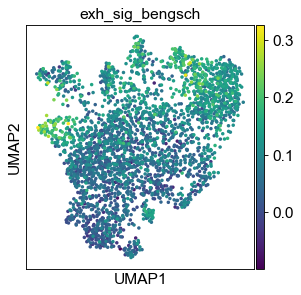

In [26]:
sc.pl.umap(adata, color='exh_sig_bengsch', 
          save='_score_bengsch_2018')

## 17. Oct 13, 2021 <a class='anchor' id='17'></a>

[Table of contents](#toc)

In [1]:
adata = sc.read(results_file)
adata

NameError: name 'sc' is not defined

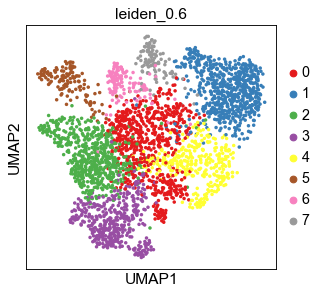

In [7]:
sc.pl.umap(adata, color = ['leiden_0.6'])

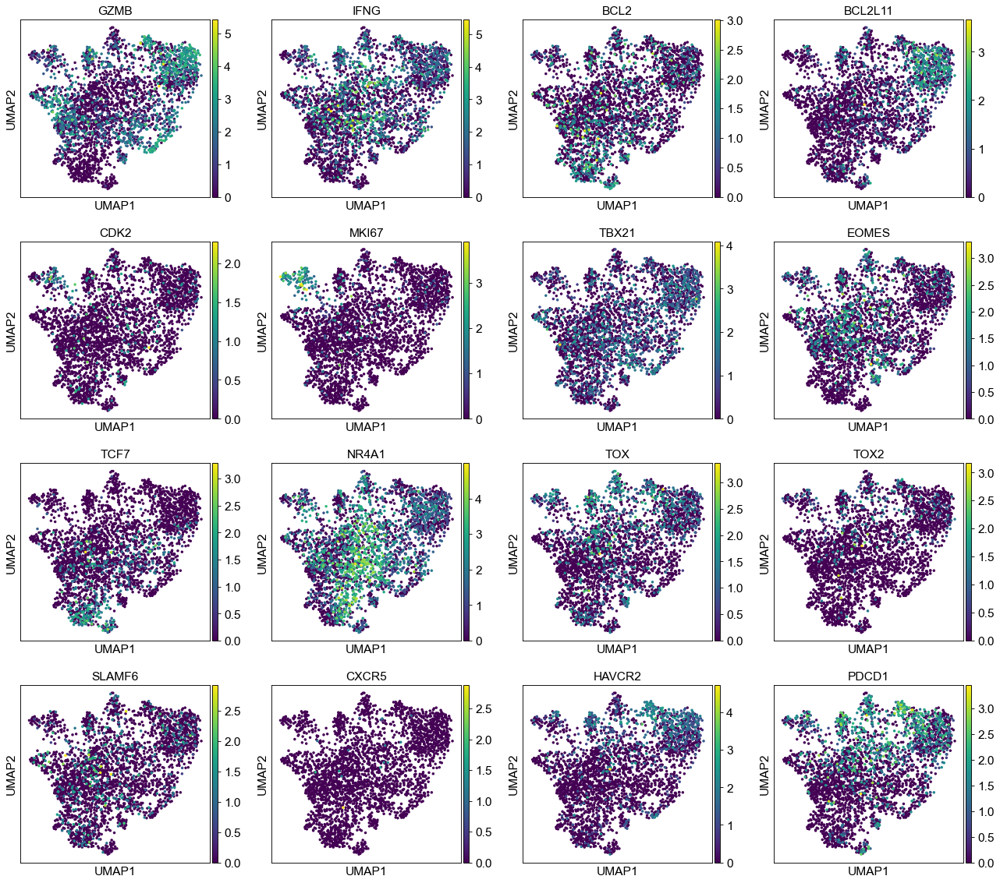

In [9]:
sc.pl.umap(adata, color = ['GZMB', 'IFNG', 'BCL2', 'BCL2L11', # cytotox, cytokines
                           'CDK2', 'MKI67', 'TBX21', 'EOMES', # TFs
                           'TCF7', 'NR4A1', 'TOX', 'TOX2', # TFs
                           'SLAMF6', 'CXCR5', 'HAVCR2', 'PDCD1']) # inhib receptors

In [10]:
scott_2019_exh_sig = ['ABCB8',	'ABCB9',	'ABHD14B',	'ABHD4',	'ABHD6',	'ABI3',	'ABR',	'ABTB1',	'ACAA1',	'ACAA2',	'ACADL',	'ACADS',	'ACBD4',	'ACCS',	'ACCSL',	'ACD',	'ACKR2',	'ACO1',	'ACOT7',	'ACOXL',	'ACSF2',	'ACSF3',	'ACTN1',	'ACTN1',	'ACTN2',	'ACTN2',	'ACTN3',	'ACTN3',	'ACTN4',	'ACTN4',	'ACTR1A',	'ACTR1B',	'ACVR2A',	'ACVR2B',	'ADAP1',	'ADAP2',	'ADAT2',	'ADCK5',	'ADGRG1',	'ADGRL1',	'ADGRL2',	'ADGRL3',	'ADPRH',	'ADRB1',	'ADRB3',	'ADSS1',	'ADSS2',	'AFMID',	'AGBL5',	'AGFG1',	'AGPAT3',	'AGPAT4',	'AHCYL1',	'AHCYL2',	'AIFM2',	'AKR1B10',	'AKR1B15',	'AKR1E2',	'ALDH7A1',	'ALKBH3',	'ALKBH6',	'AMZ1',	'ANGPTL2',	'ANKRD29',	'ANKRD46',	'ANKS1A',	'ANKS1B',	'ANXA11',	'ANXA4',	'AOX1',	'AP2A1',	'AP2A2',	'AP3S2',	'AP5B1',	'APBB1',	'APH1B',	'APLP1',	'APPL1',	'APPL2',	'ARAP1',	'ARAP2',	'ARAP3',	'ARF3',	'ARFGAP1',	'ARFGAP3',	'ARFIP2',	'ARHGAP11B',	'ARHGAP39',	'ARHGAP4',	'ARHGAP9',	'ARHGEF16',	'ARHGEF26',	'ARL16',	'ARL6IP1',	'ARMC3',	'ARMCX3',	'ARPC1A',	'ARPIN-AP3S2',	'ARRB1',	'ARRB2',	'ARRDC1',	'ARSA',	'ARSG',	'ARVCF',	'ASB2',	'ASGR1',	'ASGR2',	'ASL',	'ATAT1',	'ATCAY',	'ATG4B',	'ATG9A',	'ATG9B',	'ATMIN',	'ATP6V0A1',	'ATP6V0A1',	'ATP6V0A2',	'ATP6V0A2',	'ATP6V0A4',	'ATP6V0A4',	'ATP6V0B',	'ATP6V0D1',	'ATP9A',	'ATP9B',	'ATXN10',	'AUH',	'AVIL',	'AVIL',	'B3GNT7',	'B4GALT4',	'BAIAP2',	'BAIAP3',	'BCAM',	'BCAT2',	'BCKDK',	'BCL2A1',	'BCL2L11',	'BCO2',	'BCOR',	'BCORL1',	'BCR',	'BEND4',	'BIN1',	'BIRC2',	'BIRC3',	'BIRC7',	'BLK',	'BLOC1S5',	'BLOC1S5-TXNDC5',	'BMF',	'BNIP3',	'BOC',	'BORCS6',	'BRF2',	'BSPRY',	'BTD',	'BTG1',	'BTG1',	'BTG2',	'BTG2',	'BTRC',	'C1QTNF1',	'C1QTNF6',	'CA2',	'CACNA1A',	'CACNA1B',	'CACNA1C',	'CACNA1D',	'CACNA1E',	'CACNA1F',	'CACNA1S',	'CADM3',	'CALCA',	'CALCB',	'CALCB',	'CALHM2',	'CALM1',	'CALM2',	'CALM3',	'CAMK2A',	'CAMK2B',	'CAMK2D',	'CAMK2G',	'CAMKMT',	'CAMLG',	'CAND1',	'CAND2',	'CAPG',	'CAPN1',	'CAPN11',	'CAPN2',	'CAPN3',	'CAPN8',	'CAPN9',	'CAPNS1',	'CAPNS2',	'CARD10',	'CARNS1',	'CASP3',	'CASP7',	'CASP9',	'CBARP',	'CBL',	'CBLB',	'CBX6',	'CBX8',	'CBY1',	'CCDC134',	'CCDC163',	'CCDC17',	'CCDC28A',	'CCDC28B',	'CCDC57',	'CCDC86',	'CCL18',	'CCL3',	'CCL3L3',	'CCL4',	'CCL4L2',	'CCNI',	'CCR8',	'CCRL2',	'CD101',	'CD151',	'CD200',	'CD200R1',	'CD200R1',	'CD200R1',	'CD200R1',	'CD200R1L',	'CD200R1L',	'CD200R1L',	'CD200R1L',	'CD2BP2',	'CD3E',	'CD72',	'CD8A',	'CDC34',	'CDCA2',	'CDCP2',	'CDK10',	'CDK11A',	'CDK11B',	'CDK14',	'CDK16',	'CDK17',	'CDK18',	'CDK5',	'CDK6',	'CDK9',	'CDKN2C',	'CELA1',	'CENPA',	'CENPO',	'CENPT',	'CEP250',	'CEP89',	'CERS4',	'CERS5',	'CERS6',	'CETN2',	'CFAP126',	'CGRRF1',	'CHAD',	'CHAT',	'CHMP6',	'CHN1',	'CHN2',	'CHN2',	'CHN2',	'CHPF',	'CHPF2',	'CHRNB1',	'CHST12',	'CHST14',	'CHURC1-FNTB',	'CIAPIN1',	'CIRBP',	'CIZ1',	'CKB',	'CKM',	'CLASRP',	'CLDN10',	'CLEC10A',	'CLIP1',	'CLIP2',	'CLIP3',	'CLNK',	'CLSPN',	'CMTM3',	'CNIH2',	'CNIH3',	'CNOT10',	'CNOT11',	'CNPY2',	'CNTROB',	'COCH',	'COG7',	'COMMD10',	'COMMD4',	'COMMD7',	'COMMD7',	'COMMD7',	'COMT',	'COPRS',	'COPS4',	'COQ9',	'CORO2A',	'CORO2B',	'CRACR2A',	'CRAT',	'CRB3',	'CREB3L2',	'CREM',	'CRLF2',	'CRMP1',	'CRYZ',	'CRYZL1',	'CSDC2',	'CSF1',	'CSF2',	'CSF2RA',	'CSNK1D',	'CSNK1D',	'CSNK1E',	'CSNK1E',	'CST6',	'CST7',	'CTDNEP1',	'CTDSP2',	'CTLA4',	'CTNND2',	'CTSA',	'CTSB',	'CTSC',	'CUEDC1',	'CUEDC2',	'CUL7',	'CUL7',	'CUL9',	'CUL9',	'CXCL1',	'CXCL2',	'CXCL3',	'CXXC5',	'CYB5R3',	'CYP11A1',	'CYP20A1',	'CYP4F11',	'CYP4F11',	'CYP4F12',	'CYP4F12',	'CYP4F2',	'CYP4F2',	'CYP4F22',	'CYP4F22',	'CYP4F3',	'CYP4F3',	'CYP4F8',	'CYP4F8',	'DALRD3',	'DAP',	'DAPK2',	'DCAF11',	'DCAF4',	'DCAF4L1',	'DCAF4L2',	'DCAKD',	'DCLK1',	'DCLK2',	'DCTN2',	'DCXR',	'DDX28',	'DECR1',	'DECR2',	'DEDD',	'DEF8',	'DENND6A',	'DENND6B',	'DGAT1',	'DGCR6',	'DGCR6L',	'DGKA',	'DGKB',	'DGKD',	'DGKG',	'DGKH',	'DGKI',	'DGKK',	'DGKZ',	'DHCR7',	'DHRS11',	'DIS3L2',	'DMAP1',	'DNAI7',	'DNAJC12',	'DNAJC4',	'DNAJC6',	'DNAL4',	'DNASE2',	'DNM1',	'DNM2',	'DNM3',	'DNMT3A',	'DNMT3B',	'DNPEP',	'DOCK11',	'DOCK6',	'DOCK7',	'DOCK8',	'DOCK9',	'DOK1',	'DOLPP1',	'DPAGT1',	'DPEP1',	'DPEP2',	'DPEP2',	'DPEP2',	'DPEP3',	'DPEP3',	'DPYS',	'DPYSL2',	'DPYSL3',	'DPYSL4',	'DRAM1',	'DTD1',	'DTX3',	'DUS2',	'DUS3L',	'DUSP10',	'DUSP15',	'DUSP2',	'DUSP22',	'DUSP6',	'DUSP7',	'DXO',	'E2F3',	'ECH1',	'ECI2',	'EDC3',	'EDC4',	'EDEM2',	'EEF2K',	'EFCAB8',	'EFHD1',	'EFHD2',	'EGR1',	'EGR2',	'EHD1',	'EHD1',	'EHD2',	'EHD2',	'EHD3',	'EHD3',	'EHD4',	'EHD4',	'EHMT1',	'EHMT2',	'EIF2D',	'EIF4ENIF1',	'ELK3',	'ELMO1',	'ELMO2',	'ELMO3',	'ELP3',	'EMID1',	'EMILIN1',	'EML1',	'EML1',	'EML2',	'EML2',	'EML3',	'EML4',	'EML4',	'ENDOV',	'ENGASE',	'ENPP1',	'ENPP2',	'ENPP3',	'ENPP5',	'ENTPD1',	'EPCAM',	'EPDR1',	'EPHA1',	'EPHA10',	'EPHA2',	'EPHA3',	'EPHA4',	'EPHA5',	'EPHA6',	'EPHA7',	'EPHA8',	'EPHB1',	'EPHB2',	'EPHB3',	'EPHB4',	'EPHB6',	'EPHX1',	'ERGIC1',	'ERGIC3',	'ERP29',	'ETV5',	'EVA1B',	'EXO5',	'EXOC3L1',	'EXOC7',	'EXOG',	'EXT2',	'FAH',	'FAHD2A',	'FAHD2B',	'FAM104B',	'FAM131A',	'FAM151B',	'FAM156A',	'FAM156B',	'FAM174A',	'FAM174B',	'FAM210B',	'FAM222B',	'FAM3A',	'FAM3C',	'FAM83H',	'FANCG',	'FARP1',	'FARP2',	'FARS2',	'FASLG',	'FASTK',	'FAXC',	'FBXL18',	'FBXO44',	'FBXO6',	'FBXO6',	'FBXW11',	'FBXW12',	'FBXW5',	'FBXW8',	'FBXW9',	'FCER1G',	'FCGBP',	'FCHSD1',	'FCRL1',	'FCRL2',	'FCRL3',	'FCRL6',	'FDFT1',	'FDX1',	'FDXR',	'FGR',	'FIBP',	'FILIP1',	'FILIP1L',	'FLOT2',	'FLT1',	'FLT4',	'FNDC3A',	'FNDC3B',	'FNTB',	'FRMD3',	'FRMD4A',	'FRMD4B',	'FRMD5',	'FRMD6',	'FUCA2',	'FUS',	'FUT10',	'FUZ',	'FYN',	'GABARAPL1',	'GABARAPL3',	'GAK',	'GALNS',	'GALNT3',	'GALNT6',	'GALT',	'GATAD2A',	'GCDH',	'GCNT1',	'GCSAM',	'GDE1',	'GDI1',	'GDI2',	'GFI1',	'GFI1B',	'GGT1',	'GGT2',	'GGT5',	'GHDC',	'GIMAP1',	'GIPC1',	'GIPC2',	'GLB1',	'GLB1L',	'GLDC',	'GLIS1',	'GLMP',	'GLP1R',	'GMPPA',	'GNB1',	'GNB2',	'GNB4',	'GNGT2',	'GNL1',	'GNPDA1',	'GNPDA2',	'GORASP1',	'GOT2',	'GPD2',	'GPLD1',	'GPR108',	'GPR137',	'GPR137B',	'GPR153',	'GPR157',	'GPR162',	'GPRASP1',	'GPRASP2',	'GPRIN2',	'GPSM1',	'GPSM2',	'GRINA',	'GRK4',	'GRK5',	'GRK6',	'GSDMD',	'GSE1',	'GSN',	'GSN',	'GSTM1',	'GSTM2',	'GSTM3',	'GSTM4',	'GSTM5',	'GSTO1',	'GSTO2',	'GSTP1',	'GSTT2',	'GSTT2B',	'GTDC1',	'GTF2IRD1',	'GTF2IRD2',	'GTF2IRD2B',	'GYG1',	'GYPC',	'GZMA',	'HACD3',	'HAGH',	'HAGHL',	'HAP1',	'HARBI1',	'HAVCR2',	'HCK',	'HDAC3',	'HDAC4',	'HDAC5',	'HDAC7',	'HDAC9',	'HDDC3',	'HDHD3',	'HEATR3',	'HES6',	'HIC1',	'HIC2',	'HIP1',	'HIP1R',	'HLA-A',	'HLA-B',	'HLA-C',	'HLA-DMA',	'HLA-E',	'HLA-F',	'HLA-G',	'HLA-H',	'HMG20B',	'HMGCL',	'HMGCLL1',	'HMSD',	'HNRNPL',	'HOOK2',	'HOOK3',	'HPS1',	'HPS4',	'HS1BP3',	'HSBP1',	'HTATIP2',	'HTRA2',	'HUNK',	'ICA1',	'IFT22',	'IFT43',	'IFT46',	'IFT52',	'IGF1R',	'IGSF3',	'IGSF5',	'IKZF2',	'IKZF4',	'IL10',	'IL21',	'IL21R',	'IL2RB',	'IL3RA',	'IL6ST',	'ILDR1',	'ILK',	'ILVBL',	'INPP5B',	'INPP5D',	'INPPL1',	'INSC',	'INSR',	'INSRR',	'IP6K3',	'IRAK2',	'IREB2',	'IRF8',	'IRS2',	'ISLR',	'ISOC2',	'ISY1',	'ISY1-RAB43',	'ITCH',	'ITFG2',	'ITIH5',	'ITM2A',	'ITM2C',	'IZUMO1R',	'IZUMO4',	'JAG1',	'JAG2',	'JAK1',	'JAK2',	'JAK3',	'JAM2',	'JDP2',	'JOSD2',	'JRK',	'KANK3',	'KCNH2',	'KCNH6',	'KCNH7',	'KCTD11',	'KCTD13',	'KCTD3',	'KCTD7',	'KDF1',	'KDM4A',	'KDM4D',	'KDM4E',	'KDM4F',	'KDR',	'KHK',	'KIF15',	'KIF19',	'KIF5B',	'KIFC2',	'KIFC3',	'KLC1',	'KLC2',	'KLC3',	'KLC4',	'KLHDC3',	'KLHDC8B',	'KLHL1',	'KLHL4',	'KLHL5',	'KLK1',	'KLK2',	'KLK3',	'KLRB1',	'KLRB1',	'KLRC1',	'KLRC2',	'KLRC3',	'KLRC4',	'KLRC4-KLRK1',	'KLRF1',	'KLRF1',	'KLRF2',	'KLRF2',	'KNDC1',	'KPTN',	'LAG3',	'LANCL1',	'LAPTM4A',	'LASP1',	'LAT2',	'LBH',	'LCAT',	'LCK',	'LCLAT1',	'LCMT1',	'LDAF1',	'LDHB',	'LEPROT',	'LETMD1',	'LGALS4',	'LGI1',	'LGI2',	'LIMD2',	'LIMK1',	'LIMK2',	'LINC02218',	'LIPE',	'LIPT1',	'LITAF',	'LMNTD2',	'LMO4',	'LOC105369632',	'LPAR2',	'LPCAT3',	'LPXN',	'LRRC1',	'LRRC14',	'LRRC27',	'LRRC29',	'LRRC61',	'LRRC9',	'LRTOMT',	'LSS',	'LTA4H',	'LXN',	'LY75',	'LY75-CD302',	'LYN',	'LYPLA1',	'LYPLA2',	'LZTS1',	'M1AP',	'MAGED2',	'MAGEH1',	'MAN2B2',	'MANBA',	'MAP1LC3A',	'MAP1LC3B',	'MAP1LC3B2',	'MAP2',	'MAP4K1',	'MAPK1',	'MAPK3',	'MARVELD2',	'MATK',	'MAX',	'MAZ',	'MCAM',	'MCCC2',	'MCF2',	'MCF2L',	'MCF2L2',	'MCOLN1',	'MCOLN1',	'MCOLN2',	'MCOLN2',	'MCOLN3',	'MCOLN3',	'MCUB',	'MDFIC',	'MEA1',	'MECOM',	'MED18',	'MEGF10',	'MEGF11',	'MEI1',	'METTL21A',	'METTL6',	'MFSD10',	'MFSD3',	'MICU1',	'MIIP',	'MLKL',	'MLLT6',	'MMD',	'MMD2',	'MMP13',	'MMP23A',	'MMP23B',	'MNAT1',	'MOB2',	'MORN1',	'MOSPD3',	'MPG',	'MPHOSPH6',	'MPST',	'MRC1',	'MRC2',	'MRGPRE',	'MRNIP',	'MRPL4',	'MSRB2',	'MSTO1',	'MTFR1L',	'MTG2',	'MTHFSD',	'MUS81',	'MVB12A',	'MVK',	'MXD4',	'MYD88',	'MYO1A',	'MYO1A',	'MYO1B',	'MYO1B',	'MYO1C',	'MYO1C',	'MYO1D',	'MYO1D',	'MYO1E',	'MYO1E',	'MYO1F',	'MYO1F',	'MYO1G',	'MYO1G',	'MYO1H',	'MYO1H',	'MYO6',	'MZT2A',	'MZT2B',	'NAA40',	'NAB2',	'NACC1',	'NACC2',	'NADSYN1',	'NAGK',	'NAGLU',	'NAIP',	'NAPSA',	'NAT9',	'NATD1',	'NCF1',	'NCF1B',	'NCF1C',	'NCMAP',	'NDE1',	'NDFIP1',	'NDUFAF7',	'NDUFS2',	'NECAP2',	'NEIL1',	'NEK8',	'NELFE',	'NEU3',	'NEU4',	'NEURL2',	'NEURL3',	'NFIL3',	'NFKBIL1',	'NIT1',	'NLRX1',	'NMB',	'NOSIP',	'NPEPL1',	'NR4A2',	'NRBP2',	'NRGN',	'NSDHL',	'NSMAF',	'NSMF',	'NTPCR',	'NUCB1',	'NUDCD3',	'NUDT1',	'NUDT22',	'OAZ2',	'OCIAD2',	'OCRL',	'OPTN',	'ORAI1',	'ORAI3',	'OS9',	'OSGIN1',	'OTOS',	'OTUB1',	'OXA1L',	'OXSR1',	'OXSR1',	'P2RX4',	'P2RX7',	'P4HTM',	'PABPC1',	'PABPC1',	'PABPC1L',	'PABPC1L',	'PABPC3',	'PABPC3',	'PABPC4',	'PABPC4',	'PACRGL',	'PACSIN1',	'PACSIN2',	'PADI1',	'PADI2',	'PADI3',	'PADI4',	'PAFAH1B3',	'PANX1',	'PANX3',	'PAQR7',	'PARP16',	'PBX4',	'PCBP4',	'PCK1',	'PCK2',	'PCTP',	'PDCD1',	'PDCD1LG2',	'PDE4A',	'PDE4B',	'PDE4C',	'PDE4D',	'PDE8A',	'PDE8B',	'PDE8B',	'PDE8B',	'PDK2',	'PDLIM5',	'PDLIM7',	'PDZD11',	'PDZD2',	'PEAR1',	'PEF1',	'PERP',	'PEX11A',	'PEX11B',	'PEX11G',	'PEX19',	'PEX6',	'PFKFB1',	'PFKFB2',	'PFKFB3',	'PFKFB4',	'PFKL',	'PFKM',	'PFKP',	'PGAP2',	'PGAP3',	'PGD',	'PGLS',	'PGLYRP1',	'PGLYRP2',	'PGPEP1',	'PGPEP1L',	'PHKA1',	'PHKA2',	'PHKG2',	'PICK1',	'PIGS',	'PIP5K1A',	'PIP5K1B',	'PIP5K1C',	'PITPNM1',	'PITPNM2',	'PITPNM3',	'PKD1L2',	'PKN1',	'PKN2',	'PKN3',	'PKP4',	'PLA2G15',	'PLA2G6',	'PLA2R1',	'PLAU',	'PLBD2',	'PLCXD1',	'PLEKHD1',	'PLEKHG2',	'PLEKHM2',	'PLGRKT',	'PLK2',	'PLK3',	'PLOD1',	'PLOD2',	'PLOD3',	'PLPP2',	'PLPP4',	'PLPP5',	'PLSCR1',	'PLSCR2',	'PLSCR3',	'PLXNA1',	'PLXNA2',	'PLXNA3',	'PLXNA4',	'PLXNB1',	'PLXNB2',	'PLXNB3',	'PLXND1',	'PMFBP1',	'PMM1',	'PNKP',	'PNPLA6',	'PNPLA6',	'PNPLA7',	'PNPLA7',	'POLD4',	'POLR3H',	'POU2F2',	'PPCDC',	'PPIC',	'PPIE',	'PPM1B',	'PPM1H',	'PPM1N',	'PPOX',	'PPP1R12C',	'PPP1R16B',	'PPP1R3B',	'PPP1R3G',	'PRDM16',	'PRDX5',	'PRDX6',	'PRELID2',	'PREX1',	'PREX2',	'PRKCE',	'PRKCH',	'PRKCSH',	'PRKRA',	'PRMT2',	'PRR36',	'PRR5',	'PRR5',	'PRR5-ARHGAP8',	'PRR5L',	'PRR5L',	'PRRC1',	'PRRT1',	'PRSS1',	'PRSS2',	'PRSS3',	'PRSS36',	'PSKH1',	'PSKH2',	'PTGER2',	'PTGR1',	'PTK2',	'PTK2B',	'PTMS',	'PTPN11',	'PTPN14',	'PTPN21',	'PTPN5',	'PTPN6',	'PTPN7',	'PTPRR',	'R3HDM4',	'RAB11A',	'RAB11B',	'RAB24',	'RAB32',	'RAB36',	'RAB3A',	'RAB4A',	'RAB4B',	'RABEP2',	'RABGAP1',	'RABGAP1L',	'RABL2A',	'RABL2B',	'RAD51D',	'RALGPS1',	'RALGPS2',	'RAPGEF1',	'RAPSN',	'RASD1',	'RASGEF1B',	'RASGEF1C',	'RASGRF1',	'RASGRF2',	'RASSF1',	'RASSF6',	'RASSF7',	'RBL1',	'RBL2',	'RBM11',	'RBMS2',	'RDH12',	'RDM1',	'RECQL5',	'RENBP',	'REPIN1',	'RFC2',	'RFT1',	'RFTN1',	'RFXANK',	'RGP1',	'RGS16',	'RGS3',	'RGS8',	'RGS9',	'RHBDD3',	'RHOA',	'RHOC',	'RHOD',	'RING1',	'RIPK3',	'RIPPLY3',	'RNASEH1',	'RNF122',	'RNF135',	'RNF166',	'RNF215',	'RNF26',	'RNH1',	'RPA2',	'RPA4',	'RPS6KA1',	'RPS6KA2',	'RPS6KA3',	'RPS6KA6',	'RPS6KB1',	'RPS6KB2',	'RPS6KL1',	'RPUSD1',	'RTN1',	'RUNDC1',	'RYBP',	'SAMSN1',	'SCAMP1',	'SCCPDH',	'SCIN',	'SCIN',	'SCLY',	'SCN10A',	'SCN11A',	'SCN1A',	'SCN2A',	'SCN3A',	'SCN4A',	'SCN5A',	'SCN7A',	'SCN8A',	'SCN9A',	'SCRIB',	'SCRN2',	'SDCBP2',	'SDF4',	'SDR39U1',	'SDR42E1',	'SEC22A',	'SELENBP1',	'SEMA4C',	'SEMA7A',	'SERHL',	'SERHL2',	'SERPINA3',	'SERPINB6',	'SERPINE2',	'SESN2',	'SETBP1',	'SFRP4',	'SFT2D1',	'SFT2D2',	'SFXN4',	'SGTA',	'SH2D1B',	'SH2D2A',	'SH3BP2',	'SH3GLB2',	'SH3TC1',	'SH3TC2',	'SH3YL1',	'SHARPIN',	'SHKBP1',	'SIGIRR',	'SIK1',	'SIK1B',	'SIK2',	'SIL1',	'SIPA1',	'SIPA1L1',	'SIPA1L2',	'SIPA1L3',	'SIRT2',	'SIRT4',	'SIRT5',	'SIRT6',	'SLA2',	'SLC16A10',	'SLC16A11',	'SLC16A13',	'SLC16A3',	'SLC16A8',	'SLC1A5',	'SLC22A15',	'SLC25A1',	'SLC25A10',	'SLC25A11',	'SLC25A34',	'SLC25A39',	'SLC25A45',	'SLC27A1',	'SLC27A4',	'SLC28A1',	'SLC28A2',	'SLC29A4',	'SLC2A10',	'SLC2A8',	'SLC35B1',	'SLC35B2',	'SLC36A1',	'SLC36A2',	'SLC36A3',	'SLC36A4',	'SLC37A1',	'SLC37A2',	'SLC38A10',	'SLC38A9',	'SLC39A4',	'SLC39A5',	'SLC41A3',	'SLC4A1',	'SLC4A10',	'SLC4A2',	'SLC4A3',	'SLC4A4',	'SLC4A5',	'SLC4A7',	'SLC4A8',	'SLC4A9',	'SLC52A1',	'SLC52A2',	'SLC52A3',	'SLC9A3R1',	'SLC9A3R2',	'SLC9B1',	'SLC9B2',	'SLCO4A1',	'SMARCAL1',	'SMARCB1',	'SMCO4',	'SMIM10',	'SMIM10L2A',	'SMIM10L2B',	'SMIM24',	'SMIM3',	'SMIM7',	'SMPD5',	'SMYD2',	'SNAP47',	'SNAPIN',	'SNRNP35',	'SNX32',	'SNX33',	'SNX5',	'SNX6',	'SNX9',	'SPATA2L',	'SPCS3',	'SPINT1',	'SPINT2',	'SPO11',	'SPOCK2',	'SPP1',	'SPRY1',	'SPRY2',	'SPSB2',	'SPSB2',	'SRC',	'SRFBP1',	'SRGAP1',	'SRGAP2B',	'SRGAP2C',	'SRGAP3',	'SRR',	'SRXN1',	'SSBP2',	'SSBP3',	'SSBP4',	'ST14',	'ST3GAL1',	'ST3GAL2',	'ST6GALNAC3',	'ST6GALNAC6',	'ST6GALNAC6',	'ST6GALNAC6',	'STAMBPL1',	'STARD3NL',	'STK11',	'STK39',	'STK39',	'STN1',	'STOML1',	'STX10',	'STX4',	'STX5',	'STX6',	'STXBP1',	'STXBP2',	'SULF1',	'SULF2',	'SULT2A1',	'SULT2B1',	'SULT2B1',	'SUOX',	'SUPT3H',	'SUSD1',	'SUSD3',	'SUSD4',	'SV2A',	'SV2B',	'SV2C',	'SYK',	'SYNGR2',	'SYNGR3',	'SYNPO',	'SZT2',	'TACC2',	'TAF11',	'TAF11L10',	'TAF11L11',	'TAF11L12',	'TAF11L13',	'TAF11L14',	'TAF11L2',	'TAF11L3',	'TAF11L4',	'TAF11L5',	'TAF11L6',	'TAF11L7',	'TAF11L8',	'TAF11L9',	'TANGO2',	'TAP2',	'TARS1',	'TARS2',	'TARS3',	'TBC1D1',	'TBC1D2B',	'TBC1D4',	'TBC1D7',	'TBC1D7',	'TBC1D7-LOC100130357',	'TCEA1',	'TCEA2',	'TCF25',	'TCIRG1',	'TCIRG1',	'TCN2',	'TCTA',	'TECR',	'TECRL',	'TECTA',	'TERT',	'TESK2',	'TFPT',	'THEMIS2',	'TIAM1',	'TIAM2',	'TICAM1',	'TICAM2',	'TIGIT',	'TIMM17B',	'TIPRL',	'TJP1',	'TJP1',	'TJP2',	'TJP3',	'TJP3',	'TK1',	'TLR7',	'TLR8',	'TMBIM1',	'TMCC3',	'TMCO6',	'TMED4',	'TMED9',	'TMEM106A',	'TMEM106C',	'TMEM120A',	'TMEM120B',	'TMEM135',	'TMEM175',	'TMEM181',	'TMEM191B',	'TMEM191C',	'TMEM218',	'TMEM241',	'TMEM242',	'TMEM256',	'TMEM256-PLSCR3',	'TMEM38B',	'TMEM39B',	'TMEM59L',	'TMEM8B',	'TMEM9',	'TMEM9B',	'TMIE',	'TMPRSS13',	'TNFRSF18',	'TNFRSF1A',	'TNFRSF1B',	'TNFRSF4',	'TNFRSF9',	'TNFSF8',	'TNK2',	'TNKS1BP1',	'TNS1',	'TNS3',	'TOMM40L',	'TOX',	'TOX2',	'TP53INP2',	'TPI1',	'TPP1',	'TPRG1',	'TPTEP2-CSNK1E',	'TRABD',	'TRADD',	'TRAF5',	'TRAPPC3',	'TRMT12',	'TRPM1',	'TRPM3',	'TRPM6',	'TRPM7',	'TRPT1',	'TSC22D4',	'TSPAN11',	'TSPAN32',	'TSPAN4',	'TSPAN9',	'TSPY1',	'TSPY10',	'TSPY2',	'TSPY26P',	'TSPY3',	'TSPY4',	'TSSC4',	'TST',	'TSTD3',	'TUBG1',	'TUBG2',	'TWSG1',	'TXNDC12',	'TYK2',	'TYROBP',	'U2AF1',	'U2AF1L4',	'U2AF1L5',	'UBASH3B',	'UBE2M',	'UBE2R2',	'UBTD1',	'UBTD2',	'UBXN8',	'UCP2',	'UGT1A1',	'UGT1A1',	'UGT1A10',	'UGT1A10',	'UGT1A4',	'UGT1A4',	'UGT1A6',	'UGT1A6',	'UGT1A7',	'UGT1A7',	'UGT1A8',	'UGT1A8',	'UGT1A9',	'UGT1A9',	'UNC119',	'UNC119',	'UNC119B',	'UNC119B',	'UNC13D',	'UPF1',	'UQCC1',	'VAMP1',	'VAMP2',	'VAMP8',	'VAX1',	'VAX2',	'VIL1',	'VIL1',	'VILL',	'VILL',	'VIPAS39',	'VMP1',	'VPS37B',	'VPS37C',	'VPS45',	'VSIG10',	'VSIG10L',	'VWA8',	'WBP1',	'WDR6',	'WDR83',	'WDR90',	'WDSUB1',	'WDTC1',	'WFS1',	'WIZ',	'WLS',	'WWP1',	'WWP2',	'XCR1',	'XDH',	'XIAP',	'XKR8',	'XXYLT1',	'YAF2',	'YES1',	'YIPF1',	'YIPF2',	'YPEL1',	'YPEL2',	'YPEL3',	'YWHAG',	'YWHAH',	'ZAN',	'ZAP70',	'ZBED2',	'ZBED3',	'ZBTB3',	'ZC3H7A',	'ZC3H7B',	'ZDHHC12',	'ZDHHC16',	'ZDHHC4',	'ZER1',	'ZFAND3',	'ZFP36L1',	'ZFP41',	'ZFYVE19',	'ZFYVE21',	'ZFYVE28',	'ZMYM2',	'ZMYM3',	'ZMYM4',	'ZMYND10',	'ZNF143',	'ZNF212',	'ZNF219',	'ZNF226',	'ZNF233',	'ZNF395',	'ZNF414',	'ZNF418',	'ZNF419',	'ZNF446',	'ZNF480',	'ZNF552',	'ZNF561',	'ZNF562',	'ZNF586',	'ZNF587B',	'ZNF610',	'ZNF664',	'ZNF692',	'ZNF746',	'ZNF76',	'ZNF768',	'ZNF774',	'ZNF837',	'ZNHIT1',	'ZSCAN1',	'ZSWIM4',	'ZSWIM5',	'ZSWIM6',	'ZSWIM8']

In [11]:
len(scott_2019_exh_sig)

1661

In [13]:
n = 0
for gene in scott_2019_exh_sig:
    if gene in adata.var.index:
        n += 1
print(n)

301


In [14]:
# using only the  301 out of 1661 genes 
# in the scott_2019_exh_sig list that are in our dataset
sc.tl.score_genes(adata, scott_2019_exh_sig, 
                  score_name = 'exh_sig_scott')

computing score 'exh_sig_scott'
    finished: added
    'exh_sig_scott', score of gene set (adata.obs).
    1103 total control genes are used. (0:00:00)


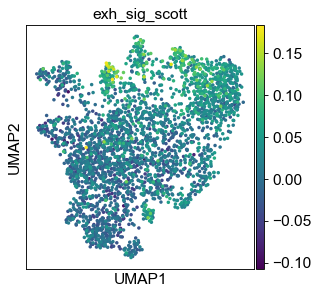

In [15]:
sc.pl.umap(adata, color='exh_sig_scott', 
          save='_score_scott_2019')

In [16]:
adata.write(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2neg_v2_colors', 'tp_colors', 'trdv_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

## 18. Oct 14, 2021 <a class='anchor' id='18'></a>

[Table of contents](#toc)

In [17]:
adata = sc.read(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2neg_v2_colors', 'tp_colors', 'trdv_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [19]:
gd_vd2neg_tp_sig = ['HAVCR2',	'PDCD1',	'TIGIT',	'LAG3',	'NKG7',	'CST7',	'CCL5',	'CTSW',	'LYST',	'CCL3',	'CCL4',	'PRF1',	'PTMS',	'APOBEC3G',	'RPL41',	'KLRD1',	'CYTOR',	'HLA-C',	'LITAF',	'CCL4L2']

In [20]:
len(gd_vd2neg_tp_sig)

20

In [21]:
n = 0
for gene in gd_vd2neg_tp_sig:
    if gene in adata.var.index:
        n += 1
print(n)

10


In [22]:
# using only the  301 out of 1661 genes 
# in the scott_2019_exh_sig list that are in our dataset
sc.tl.score_genes(adata, gd_vd2neg_tp_sig, 
                  score_name = 'exh_sig_ptt')

computing score 'exh_sig_ptt'
    finished: added
    'exh_sig_ptt', score of gene set (adata.obs).
    147 total control genes are used. (0:00:00)


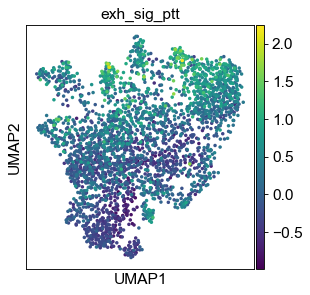

In [26]:
sc.pl.umap(adata, color='exh_sig_ptt', 
          save='_score_vd2neg_tp')

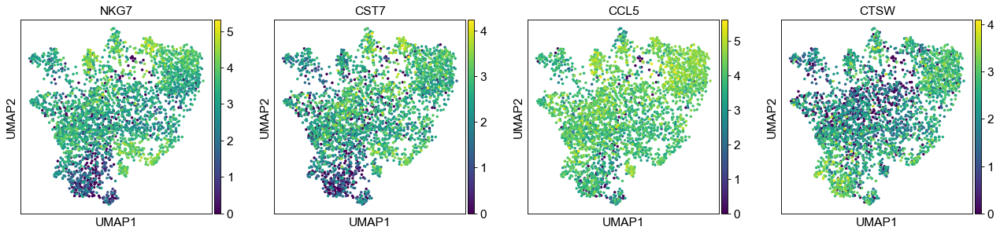

In [27]:
sc.pl.umap(adata, color=['NKG7', 'CST7', 'CCL5', 'CTSW']) # 10/20 are in .raw but have been filtered out at the highly variable genes step?

### Use raw - ptt

In [45]:
len(gd_vd2neg_tp_sig)

20

In [44]:
n = 0
for gene in gd_vd2neg_tp_sig:
    if gene in adata.raw.var.index:
        n += 1
print(n)

20


In [28]:
# using only the  301 out of 1661 genes 
# in the scott_2019_exh_sig list that are in our dataset
sc.tl.score_genes(adata, gd_vd2neg_tp_sig, 
                  score_name = 'exh_sig_ptt_raw', use_raw=True) # uses 20/20 genes

computing score 'exh_sig_ptt_raw'
    finished: added
    'exh_sig_ptt_raw', score of gene set (adata.obs).
    149 total control genes are used. (0:00:00)


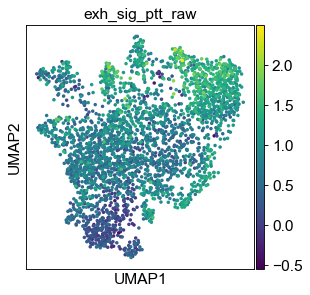

In [29]:
sc.pl.umap(adata, color='exh_sig_ptt_raw', 
          save='_score_vd2neg_tp_raw')

## 19. Oct 15, 2021 (Fri) <a class='anchor' id='19'></a>

[Table of contents](#toc)

In [32]:
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2neg_v2_colors', 'tp_colors', 'trdv_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'con

#### Bengsch, Wherry 2018

In [33]:
bengsch_2018_exh_sig = ['ABI3',	'ABR',	'ACADL',	'ACE',	'ACOD1',	'ACOT11',	'ACSBG1',	'ADA',	'ADAM19',	'ADAM9',	'ADAMTS9',	'ADGRE4P',	'ADGRG1',	'ADRBK2',	'AFMID',	'AGPAT3',	'AHI1',	'AIDA',	'AK3',	'AKR1B10',	'AKR1E2',	'ALCAM',	'ALOX5AP',	'ALS2',	'ANK3',	'ANXA3',	'APAF1',	'APLP2',	'APOBEC2',	'APOC2',	'AREG',	'ARHGEF12',	'ARID3A',	'ARL5A',	'ARMCX3',	'ARSB',	'ART3',	'ASAP2',	'ASPRV1',	'ATMIN',	'ATP6V0A1',	'ATP8A2',	'ATPIF1',	'ATXN1',	'B4GALT4',	'BANK1',	'BHLHE41',	'BLNK',	'BTK',	'C10orf128',	'C12orf71',	'C1orf54',	'C5AR1',	'C6orf141',	'C7orf49',	'CACNA1E',	'CALCB',	'CAMP',	'CASP1',	'CASP3',	'CASP4',	'CCDC109B',	'CCDC112',	'CCDC146',	'CCDC66',	'CCDC88A',	'CCNYL1',	'CCRL2',	'CD14',	'CD19',	'CD200R1',	'CD200R1L',	'CD200R1L',	'CD24',	'CD244',	'CD300LD',	'CD302',	'CD36',	'CD38',	'CD7',	'CD80',	'CD81',	'CD83',	'CD86',	'CDC14A',	'CDK14',	'CDK6',	'CDKN2C',	'CEACAM1',	'CELA1',	'CENPQ',	'CEP128',	'CERS6',	'CGGBP1',	'CHIT1',	'CHN2',	'CHST11',	'CHST12',	'CHST2',	'CIB2',	'CKAP4',	'CLEC4E',	'CLGN',	'CMKLR1',	'CNRIP1',	'CNTLN',	'CNTN5',	'CORO2A',	'CPEB2',	'CRIP2',	'CRMP1',	'CSF1R',	'CSF2RA',	'CSPP1',	'CTLA4',	'CTSC',	'CXCL10',	'CXCL3',	'CXCR5',	'CXorf56',	'CYBB',	'CYFIP1',	'CYP4F2',	'CYP4V2',	'DAPK2',	'DCLK2',	'DCLRE1C',	'DCUN1D4',	'DENND5B',	'DERL3',	'DHX58',	'DOCK6',	'DOCK7',	'DPCR1',	'DTX3',	'DUSP4',	'DZANK1',	'EAF2',	'EEA1',	'EGR1',	'EHD4',	'EIF2AK2',	'EIF4E3',	'ENDOU',	'ENPP1',	'ENPP2',	'ENPP5',	'ENPP6',	'ENTPD1',	'EOMES',	'F10',	'FABP1',	'FABP4',	'FABP7',	'FAIM',	'FAM129A',	'FAM185A',	'FAM208A',	'FAM81A',	'FAM84A',	'FANCD2',	'FANCD2OS',	'FAXC',	'FCER1G',	'FGD4',	'FGL2',	'FGR',	'FILIP1',	'FN1',	'FPR2',	'FPR3',	'FRY',	'FYN',	'GABARAPL1',	'GAS7',	'GCA',	'GCNT1',	'GFPT1',	'GFRAL',	'GGTA1P',	'GJB2',	'GLCCI1',	'GLP1R',	'GNAS',	'GNB4',	'GNG3',	'GNGT2',	'GNPDA2',	'GNS',	'GPD2',	'GPM6A',	'GPR137B',	'GPR155',	'GPR52',	'GPR65',	'GPRC5A',	'GRB7',	'GSTA4',	'GVINP1',	'GXYLT1',	'GZMK',	'HAUS3',	'HCK',	'HDC',	'HELZ2',	'HERC6',	'HHEX',	'HIP1',	'HLA-DQB1',	'HLA-DRB5',	'HMGB2',	'HMGN3',	'HP',	'HSPA13',	'HSPA4L',	'HYAL2',	'ICA1',	'IDH1',	'IER5L',	'IFI16',	'IFI16',	'IFI16',	'IFI27',	'IFI44',	'IFIH1',	'IFIT1B',	'IFIT3',	'IFITM2',	'IFITM3',	'IKBIP',	'IKZF2',	'IKZF3',	'IL10',	'IL10RA',	'IL13RA1',	'IL15RA',	'IL21',	'IL2RB',	'IL6',	'IL7',	'ILDR1',	'INHBA',	'IQCA1',	'IRAK2',	'ISG15',	'ISG20',	'ITGA2',	'ITGAM',	'ITGAV',	'ITGB1BP1',	'ITGB8',	'ITIH5',	'JDP2',	'KAZALD1',	'KCNIP3',	'KCTD9',	'KIAA0196',	'KIF13B',	'KIF5C',	'KLKB1',	'KLRB1',	'KYNU',	'LAG3',	'LAMP2',	'LAT2',	'LAX1',	'LCLAT1',	'LCN2',	'LGALS3',	'LGALS4',	'LGALSL',	'LILRB3',	'LIM2',	'LITAF',	'LMO1',	'LOC728392',	'LOC81691',	'LPCAT4',	'LRRC8C',	'LRRK2',	'LTF',	'LYZ',	'MAFG',	'MAGEE1',	'MAP2',	'MAP6',	'MCEMP1',	'MDFIC',	'MEF2C',	'MEF2D',	'METRNL',	'MGST1',	'MKRN2',	'MLKL',	'MMD',	'MMP8',	'MPEG1',	'MPP4',	'MRGPRX3',	'MRGPRX3',	'MS4A1',	'MTERF2',	'MX1',	'MX2',	'MXD1',	'MYADM',	'MYBL1',	'MYO18B',	'MYO1E',	'MYO1F',	'MYO9A',	'MZB1',	'NAB1',	'NAIP',	'NAP1L3',	'NAPSA',	'NCF1',	'NCF2',	'NCF4',	'NDFIP2',	'NDNF',	'NEB',	'NENF',	'NKG7',	'NLRC5',	'NR4A2',	'NREP',	'NSMAF',	'NUGGC',	'NUPR1',	'OAS1',	'OAS1',	'OAS3',	'OCIAD2',	'OFD1',	'OGFRL1',	'OLR1',	'OOSP1',	'OOSP2',	'OPTN',	'OR2D2',	'OSBPL3',	'OSR2',	'OSTM1',	'OXR1',	'PARD3B',	'PAWR',	'PBX3',	'PCGF5',	'PDCD1',	'PENK',	'PERP',	'PEX11A',	'PGLYRP1',	'PGM2L1',	'PGRMC2',	'PHACTR2',	'PHF11',	'PI4K2B',	'PILRA',	'PLA2G16',	'PLBD1',	'PLEKHF1',	'PLGRKT',	'PLK2',	'PLOD2',	'PLSCR1',	'PLSCR4',	'PLXDC1',	'PLXDC2',	'PML',	'POLN',	'PON3',	'POU2AF1',	'PPFIBP1',	'PRDM1',	'PRELID2',	'PREX1',	'PRG2',	'PRG3',	'PRR5L',	'PRSS2',	'PTGER2',	'PTGER4',	'PTGS2',	'PTPN13',	'PYGL',	'RAB30',	'RAB39B',	'RAET1E',	'RANBP17',	'RAP1GAP2',	'RASGEF1A',	'RASGRP3',	'RASSF1',	'RASSF4',	'RBBP6',	'RENBP',	'RGS1',	'RGS16',	'RNASE6',	'RNF128',	'RSAD2',	'RTP4',	'RYK',	'S100A11',	'S100A8',	'S100A9',	'SAMSN1',	'SCCPDH',	'SCD',	'SCLY',	'SEC11C',	'SEC24A',	'SEC24D',	'4-Sep',	'SERP1',	'SERPINB10',	'SERPINI1',	'SETBP1',	'SFMBT1',	'SGK1',	'SGPP2',	'SH2D1B',	'SH2D7',	'SH3YL1',	'SIRPA',	'SIRPB1',	'SIRPB1',	'SLC22A15',	'SLC25A24',	'SLC27A4',	'SLCO4C1',	'SLPI',	'SNRPN',	'SNURF',	'SOSTDC1',	'SP140',	'SPIN4',	'SPRY2',	'SRGAP3',	'SRXN1',	'ST6GALNAC3',	'STAT3',	'STK3',	'STK32C',	'STK39',	'STRN',	'STX19',	'STX7',	'SUN1',	'SUOX',	'SUV39H2',	'SV2C',	'SYK',	'SYT11',	'TAP1',	'TAS2R40',	'TBC1D12',	'TCEAL9',	'TCF4',	'TEC',	'THBD',	'THBS1',	'THEMIS2',	'TIFA',	'TIGIT',	'TJP2',	'TK1',	'TLR2',	'TMEM106A',	'TMEM140',	'TMEM159',	'TMEM163',	'TMEM170B',	'TMEM2',	'TMEM263',	'TMPRSS13',	'TNFRSF13C',	'TNFRSF17',	'TNFSF13B',	'TNFSF4',	'TNIP3',	'TOPORS',	'TOR1AIP1',	'TOX',	'TOX2',	'TRAFD1',	'TRAM2',	'TRDN',	'TREM1',	'TREML4',	'TRIB1',	'TRMT61B',	'TRPC1',	'TRPS1',	'TSGA10',	'TSTD3',	'TTN',	'TWSG1',	'TXN',	'UBASH3B',	'UMAD1',	'UNC93B1',	'VAMP8',	'VCAN',	'VMP1',	'VPS54',	'VSIG1',	'XAF1',	'XCL1',	'XDH',	'ZAK',	'ZBED3',	'ZBP1',	'ZBTB38',	'ZC2HC1A',	'ZC3H12C',	'ZCRB1',	'ZFAND4',	'ZMAT1',	'ZNF208',	'ZNF382',	'ZNF705A',	'ZNF773',	'ZPBP',]

In [34]:
len(bengsch_2018_exh_sig)

526

In [38]:
n = 0
for gene in bengsch_2018_exh_sig:
    if gene in adata.raw.var.index:
        n += 1
print(n)

404


In [35]:
sc.tl.score_genes(adata, bengsch_2018_exh_sig,
                  score_name = 'exh_sig_bengsch_raw', use_raw=True)  # uses 404/526 genes

computing score 'exh_sig_bengsch_raw'
    finished: added
    'exh_sig_bengsch_raw', score of gene set (adata.obs).
    1169 total control genes are used. (0:00:00)


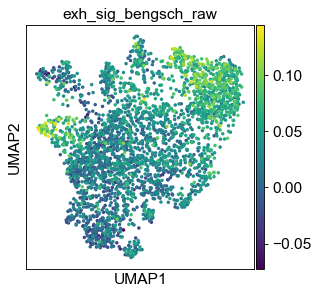

In [37]:
sc.pl.umap(adata, color='exh_sig_bengsch_raw', 
          save='_score_bengsch_2018_raw')

#### Scott, Schietinger 2019

In [39]:
scott_2019_exh_sig = ['ABCB8',	'ABCB9',	'ABHD14B',	'ABHD4',	'ABHD6',	'ABI3',	'ABR',	'ABTB1',	'ACAA1',	'ACAA2',	'ACADL',	'ACADS',	'ACBD4',	'ACCS',	'ACCSL',	'ACD',	'ACKR2',	'ACO1',	'ACOT7',	'ACOXL',	'ACSF2',	'ACSF3',	'ACTN1',	'ACTN1',	'ACTN2',	'ACTN2',	'ACTN3',	'ACTN3',	'ACTN4',	'ACTN4',	'ACTR1A',	'ACTR1B',	'ACVR2A',	'ACVR2B',	'ADAP1',	'ADAP2',	'ADAT2',	'ADCK5',	'ADGRG1',	'ADGRL1',	'ADGRL2',	'ADGRL3',	'ADPRH',	'ADRB1',	'ADRB3',	'ADSS1',	'ADSS2',	'AFMID',	'AGBL5',	'AGFG1',	'AGPAT3',	'AGPAT4',	'AHCYL1',	'AHCYL2',	'AIFM2',	'AKR1B10',	'AKR1B15',	'AKR1E2',	'ALDH7A1',	'ALKBH3',	'ALKBH6',	'AMZ1',	'ANGPTL2',	'ANKRD29',	'ANKRD46',	'ANKS1A',	'ANKS1B',	'ANXA11',	'ANXA4',	'AOX1',	'AP2A1',	'AP2A2',	'AP3S2',	'AP5B1',	'APBB1',	'APH1B',	'APLP1',	'APPL1',	'APPL2',	'ARAP1',	'ARAP2',	'ARAP3',	'ARF3',	'ARFGAP1',	'ARFGAP3',	'ARFIP2',	'ARHGAP11B',	'ARHGAP39',	'ARHGAP4',	'ARHGAP9',	'ARHGEF16',	'ARHGEF26',	'ARL16',	'ARL6IP1',	'ARMC3',	'ARMCX3',	'ARPC1A',	'ARPIN-AP3S2',	'ARRB1',	'ARRB2',	'ARRDC1',	'ARSA',	'ARSG',	'ARVCF',	'ASB2',	'ASGR1',	'ASGR2',	'ASL',	'ATAT1',	'ATCAY',	'ATG4B',	'ATG9A',	'ATG9B',	'ATMIN',	'ATP6V0A1',	'ATP6V0A1',	'ATP6V0A2',	'ATP6V0A2',	'ATP6V0A4',	'ATP6V0A4',	'ATP6V0B',	'ATP6V0D1',	'ATP9A',	'ATP9B',	'ATXN10',	'AUH',	'AVIL',	'AVIL',	'B3GNT7',	'B4GALT4',	'BAIAP2',	'BAIAP3',	'BCAM',	'BCAT2',	'BCKDK',	'BCL2A1',	'BCL2L11',	'BCO2',	'BCOR',	'BCORL1',	'BCR',	'BEND4',	'BIN1',	'BIRC2',	'BIRC3',	'BIRC7',	'BLK',	'BLOC1S5',	'BLOC1S5-TXNDC5',	'BMF',	'BNIP3',	'BOC',	'BORCS6',	'BRF2',	'BSPRY',	'BTD',	'BTG1',	'BTG1',	'BTG2',	'BTG2',	'BTRC',	'C1QTNF1',	'C1QTNF6',	'CA2',	'CACNA1A',	'CACNA1B',	'CACNA1C',	'CACNA1D',	'CACNA1E',	'CACNA1F',	'CACNA1S',	'CADM3',	'CALCA',	'CALCB',	'CALCB',	'CALHM2',	'CALM1',	'CALM2',	'CALM3',	'CAMK2A',	'CAMK2B',	'CAMK2D',	'CAMK2G',	'CAMKMT',	'CAMLG',	'CAND1',	'CAND2',	'CAPG',	'CAPN1',	'CAPN11',	'CAPN2',	'CAPN3',	'CAPN8',	'CAPN9',	'CAPNS1',	'CAPNS2',	'CARD10',	'CARNS1',	'CASP3',	'CASP7',	'CASP9',	'CBARP',	'CBL',	'CBLB',	'CBX6',	'CBX8',	'CBY1',	'CCDC134',	'CCDC163',	'CCDC17',	'CCDC28A',	'CCDC28B',	'CCDC57',	'CCDC86',	'CCL18',	'CCL3',	'CCL3L3',	'CCL4',	'CCL4L2',	'CCNI',	'CCR8',	'CCRL2',	'CD101',	'CD151',	'CD200',	'CD200R1',	'CD200R1',	'CD200R1',	'CD200R1',	'CD200R1L',	'CD200R1L',	'CD200R1L',	'CD200R1L',	'CD2BP2',	'CD3E',	'CD72',	'CD8A',	'CDC34',	'CDCA2',	'CDCP2',	'CDK10',	'CDK11A',	'CDK11B',	'CDK14',	'CDK16',	'CDK17',	'CDK18',	'CDK5',	'CDK6',	'CDK9',	'CDKN2C',	'CELA1',	'CENPA',	'CENPO',	'CENPT',	'CEP250',	'CEP89',	'CERS4',	'CERS5',	'CERS6',	'CETN2',	'CFAP126',	'CGRRF1',	'CHAD',	'CHAT',	'CHMP6',	'CHN1',	'CHN2',	'CHN2',	'CHN2',	'CHPF',	'CHPF2',	'CHRNB1',	'CHST12',	'CHST14',	'CHURC1-FNTB',	'CIAPIN1',	'CIRBP',	'CIZ1',	'CKB',	'CKM',	'CLASRP',	'CLDN10',	'CLEC10A',	'CLIP1',	'CLIP2',	'CLIP3',	'CLNK',	'CLSPN',	'CMTM3',	'CNIH2',	'CNIH3',	'CNOT10',	'CNOT11',	'CNPY2',	'CNTROB',	'COCH',	'COG7',	'COMMD10',	'COMMD4',	'COMMD7',	'COMMD7',	'COMMD7',	'COMT',	'COPRS',	'COPS4',	'COQ9',	'CORO2A',	'CORO2B',	'CRACR2A',	'CRAT',	'CRB3',	'CREB3L2',	'CREM',	'CRLF2',	'CRMP1',	'CRYZ',	'CRYZL1',	'CSDC2',	'CSF1',	'CSF2',	'CSF2RA',	'CSNK1D',	'CSNK1D',	'CSNK1E',	'CSNK1E',	'CST6',	'CST7',	'CTDNEP1',	'CTDSP2',	'CTLA4',	'CTNND2',	'CTSA',	'CTSB',	'CTSC',	'CUEDC1',	'CUEDC2',	'CUL7',	'CUL7',	'CUL9',	'CUL9',	'CXCL1',	'CXCL2',	'CXCL3',	'CXXC5',	'CYB5R3',	'CYP11A1',	'CYP20A1',	'CYP4F11',	'CYP4F11',	'CYP4F12',	'CYP4F12',	'CYP4F2',	'CYP4F2',	'CYP4F22',	'CYP4F22',	'CYP4F3',	'CYP4F3',	'CYP4F8',	'CYP4F8',	'DALRD3',	'DAP',	'DAPK2',	'DCAF11',	'DCAF4',	'DCAF4L1',	'DCAF4L2',	'DCAKD',	'DCLK1',	'DCLK2',	'DCTN2',	'DCXR',	'DDX28',	'DECR1',	'DECR2',	'DEDD',	'DEF8',	'DENND6A',	'DENND6B',	'DGAT1',	'DGCR6',	'DGCR6L',	'DGKA',	'DGKB',	'DGKD',	'DGKG',	'DGKH',	'DGKI',	'DGKK',	'DGKZ',	'DHCR7',	'DHRS11',	'DIS3L2',	'DMAP1',	'DNAI7',	'DNAJC12',	'DNAJC4',	'DNAJC6',	'DNAL4',	'DNASE2',	'DNM1',	'DNM2',	'DNM3',	'DNMT3A',	'DNMT3B',	'DNPEP',	'DOCK11',	'DOCK6',	'DOCK7',	'DOCK8',	'DOCK9',	'DOK1',	'DOLPP1',	'DPAGT1',	'DPEP1',	'DPEP2',	'DPEP2',	'DPEP2',	'DPEP3',	'DPEP3',	'DPYS',	'DPYSL2',	'DPYSL3',	'DPYSL4',	'DRAM1',	'DTD1',	'DTX3',	'DUS2',	'DUS3L',	'DUSP10',	'DUSP15',	'DUSP2',	'DUSP22',	'DUSP6',	'DUSP7',	'DXO',	'E2F3',	'ECH1',	'ECI2',	'EDC3',	'EDC4',	'EDEM2',	'EEF2K',	'EFCAB8',	'EFHD1',	'EFHD2',	'EGR1',	'EGR2',	'EHD1',	'EHD1',	'EHD2',	'EHD2',	'EHD3',	'EHD3',	'EHD4',	'EHD4',	'EHMT1',	'EHMT2',	'EIF2D',	'EIF4ENIF1',	'ELK3',	'ELMO1',	'ELMO2',	'ELMO3',	'ELP3',	'EMID1',	'EMILIN1',	'EML1',	'EML1',	'EML2',	'EML2',	'EML3',	'EML4',	'EML4',	'ENDOV',	'ENGASE',	'ENPP1',	'ENPP2',	'ENPP3',	'ENPP5',	'ENTPD1',	'EPCAM',	'EPDR1',	'EPHA1',	'EPHA10',	'EPHA2',	'EPHA3',	'EPHA4',	'EPHA5',	'EPHA6',	'EPHA7',	'EPHA8',	'EPHB1',	'EPHB2',	'EPHB3',	'EPHB4',	'EPHB6',	'EPHX1',	'ERGIC1',	'ERGIC3',	'ERP29',	'ETV5',	'EVA1B',	'EXO5',	'EXOC3L1',	'EXOC7',	'EXOG',	'EXT2',	'FAH',	'FAHD2A',	'FAHD2B',	'FAM104B',	'FAM131A',	'FAM151B',	'FAM156A',	'FAM156B',	'FAM174A',	'FAM174B',	'FAM210B',	'FAM222B',	'FAM3A',	'FAM3C',	'FAM83H',	'FANCG',	'FARP1',	'FARP2',	'FARS2',	'FASLG',	'FASTK',	'FAXC',	'FBXL18',	'FBXO44',	'FBXO6',	'FBXO6',	'FBXW11',	'FBXW12',	'FBXW5',	'FBXW8',	'FBXW9',	'FCER1G',	'FCGBP',	'FCHSD1',	'FCRL1',	'FCRL2',	'FCRL3',	'FCRL6',	'FDFT1',	'FDX1',	'FDXR',	'FGR',	'FIBP',	'FILIP1',	'FILIP1L',	'FLOT2',	'FLT1',	'FLT4',	'FNDC3A',	'FNDC3B',	'FNTB',	'FRMD3',	'FRMD4A',	'FRMD4B',	'FRMD5',	'FRMD6',	'FUCA2',	'FUS',	'FUT10',	'FUZ',	'FYN',	'GABARAPL1',	'GABARAPL3',	'GAK',	'GALNS',	'GALNT3',	'GALNT6',	'GALT',	'GATAD2A',	'GCDH',	'GCNT1',	'GCSAM',	'GDE1',	'GDI1',	'GDI2',	'GFI1',	'GFI1B',	'GGT1',	'GGT2',	'GGT5',	'GHDC',	'GIMAP1',	'GIPC1',	'GIPC2',	'GLB1',	'GLB1L',	'GLDC',	'GLIS1',	'GLMP',	'GLP1R',	'GMPPA',	'GNB1',	'GNB2',	'GNB4',	'GNGT2',	'GNL1',	'GNPDA1',	'GNPDA2',	'GORASP1',	'GOT2',	'GPD2',	'GPLD1',	'GPR108',	'GPR137',	'GPR137B',	'GPR153',	'GPR157',	'GPR162',	'GPRASP1',	'GPRASP2',	'GPRIN2',	'GPSM1',	'GPSM2',	'GRINA',	'GRK4',	'GRK5',	'GRK6',	'GSDMD',	'GSE1',	'GSN',	'GSN',	'GSTM1',	'GSTM2',	'GSTM3',	'GSTM4',	'GSTM5',	'GSTO1',	'GSTO2',	'GSTP1',	'GSTT2',	'GSTT2B',	'GTDC1',	'GTF2IRD1',	'GTF2IRD2',	'GTF2IRD2B',	'GYG1',	'GYPC',	'GZMA',	'HACD3',	'HAGH',	'HAGHL',	'HAP1',	'HARBI1',	'HAVCR2',	'HCK',	'HDAC3',	'HDAC4',	'HDAC5',	'HDAC7',	'HDAC9',	'HDDC3',	'HDHD3',	'HEATR3',	'HES6',	'HIC1',	'HIC2',	'HIP1',	'HIP1R',	'HLA-A',	'HLA-B',	'HLA-C',	'HLA-DMA',	'HLA-E',	'HLA-F',	'HLA-G',	'HLA-H',	'HMG20B',	'HMGCL',	'HMGCLL1',	'HMSD',	'HNRNPL',	'HOOK2',	'HOOK3',	'HPS1',	'HPS4',	'HS1BP3',	'HSBP1',	'HTATIP2',	'HTRA2',	'HUNK',	'ICA1',	'IFT22',	'IFT43',	'IFT46',	'IFT52',	'IGF1R',	'IGSF3',	'IGSF5',	'IKZF2',	'IKZF4',	'IL10',	'IL21',	'IL21R',	'IL2RB',	'IL3RA',	'IL6ST',	'ILDR1',	'ILK',	'ILVBL',	'INPP5B',	'INPP5D',	'INPPL1',	'INSC',	'INSR',	'INSRR',	'IP6K3',	'IRAK2',	'IREB2',	'IRF8',	'IRS2',	'ISLR',	'ISOC2',	'ISY1',	'ISY1-RAB43',	'ITCH',	'ITFG2',	'ITIH5',	'ITM2A',	'ITM2C',	'IZUMO1R',	'IZUMO4',	'JAG1',	'JAG2',	'JAK1',	'JAK2',	'JAK3',	'JAM2',	'JDP2',	'JOSD2',	'JRK',	'KANK3',	'KCNH2',	'KCNH6',	'KCNH7',	'KCTD11',	'KCTD13',	'KCTD3',	'KCTD7',	'KDF1',	'KDM4A',	'KDM4D',	'KDM4E',	'KDM4F',	'KDR',	'KHK',	'KIF15',	'KIF19',	'KIF5B',	'KIFC2',	'KIFC3',	'KLC1',	'KLC2',	'KLC3',	'KLC4',	'KLHDC3',	'KLHDC8B',	'KLHL1',	'KLHL4',	'KLHL5',	'KLK1',	'KLK2',	'KLK3',	'KLRB1',	'KLRB1',	'KLRC1',	'KLRC2',	'KLRC3',	'KLRC4',	'KLRC4-KLRK1',	'KLRF1',	'KLRF1',	'KLRF2',	'KLRF2',	'KNDC1',	'KPTN',	'LAG3',	'LANCL1',	'LAPTM4A',	'LASP1',	'LAT2',	'LBH',	'LCAT',	'LCK',	'LCLAT1',	'LCMT1',	'LDAF1',	'LDHB',	'LEPROT',	'LETMD1',	'LGALS4',	'LGI1',	'LGI2',	'LIMD2',	'LIMK1',	'LIMK2',	'LINC02218',	'LIPE',	'LIPT1',	'LITAF',	'LMNTD2',	'LMO4',	'LOC105369632',	'LPAR2',	'LPCAT3',	'LPXN',	'LRRC1',	'LRRC14',	'LRRC27',	'LRRC29',	'LRRC61',	'LRRC9',	'LRTOMT',	'LSS',	'LTA4H',	'LXN',	'LY75',	'LY75-CD302',	'LYN',	'LYPLA1',	'LYPLA2',	'LZTS1',	'M1AP',	'MAGED2',	'MAGEH1',	'MAN2B2',	'MANBA',	'MAP1LC3A',	'MAP1LC3B',	'MAP1LC3B2',	'MAP2',	'MAP4K1',	'MAPK1',	'MAPK3',	'MARVELD2',	'MATK',	'MAX',	'MAZ',	'MCAM',	'MCCC2',	'MCF2',	'MCF2L',	'MCF2L2',	'MCOLN1',	'MCOLN1',	'MCOLN2',	'MCOLN2',	'MCOLN3',	'MCOLN3',	'MCUB',	'MDFIC',	'MEA1',	'MECOM',	'MED18',	'MEGF10',	'MEGF11',	'MEI1',	'METTL21A',	'METTL6',	'MFSD10',	'MFSD3',	'MICU1',	'MIIP',	'MLKL',	'MLLT6',	'MMD',	'MMD2',	'MMP13',	'MMP23A',	'MMP23B',	'MNAT1',	'MOB2',	'MORN1',	'MOSPD3',	'MPG',	'MPHOSPH6',	'MPST',	'MRC1',	'MRC2',	'MRGPRE',	'MRNIP',	'MRPL4',	'MSRB2',	'MSTO1',	'MTFR1L',	'MTG2',	'MTHFSD',	'MUS81',	'MVB12A',	'MVK',	'MXD4',	'MYD88',	'MYO1A',	'MYO1A',	'MYO1B',	'MYO1B',	'MYO1C',	'MYO1C',	'MYO1D',	'MYO1D',	'MYO1E',	'MYO1E',	'MYO1F',	'MYO1F',	'MYO1G',	'MYO1G',	'MYO1H',	'MYO1H',	'MYO6',	'MZT2A',	'MZT2B',	'NAA40',	'NAB2',	'NACC1',	'NACC2',	'NADSYN1',	'NAGK',	'NAGLU',	'NAIP',	'NAPSA',	'NAT9',	'NATD1',	'NCF1',	'NCF1B',	'NCF1C',	'NCMAP',	'NDE1',	'NDFIP1',	'NDUFAF7',	'NDUFS2',	'NECAP2',	'NEIL1',	'NEK8',	'NELFE',	'NEU3',	'NEU4',	'NEURL2',	'NEURL3',	'NFIL3',	'NFKBIL1',	'NIT1',	'NLRX1',	'NMB',	'NOSIP',	'NPEPL1',	'NR4A2',	'NRBP2',	'NRGN',	'NSDHL',	'NSMAF',	'NSMF',	'NTPCR',	'NUCB1',	'NUDCD3',	'NUDT1',	'NUDT22',	'OAZ2',	'OCIAD2',	'OCRL',	'OPTN',	'ORAI1',	'ORAI3',	'OS9',	'OSGIN1',	'OTOS',	'OTUB1',	'OXA1L',	'OXSR1',	'OXSR1',	'P2RX4',	'P2RX7',	'P4HTM',	'PABPC1',	'PABPC1',	'PABPC1L',	'PABPC1L',	'PABPC3',	'PABPC3',	'PABPC4',	'PABPC4',	'PACRGL',	'PACSIN1',	'PACSIN2',	'PADI1',	'PADI2',	'PADI3',	'PADI4',	'PAFAH1B3',	'PANX1',	'PANX3',	'PAQR7',	'PARP16',	'PBX4',	'PCBP4',	'PCK1',	'PCK2',	'PCTP',	'PDCD1',	'PDCD1LG2',	'PDE4A',	'PDE4B',	'PDE4C',	'PDE4D',	'PDE8A',	'PDE8B',	'PDE8B',	'PDE8B',	'PDK2',	'PDLIM5',	'PDLIM7',	'PDZD11',	'PDZD2',	'PEAR1',	'PEF1',	'PERP',	'PEX11A',	'PEX11B',	'PEX11G',	'PEX19',	'PEX6',	'PFKFB1',	'PFKFB2',	'PFKFB3',	'PFKFB4',	'PFKL',	'PFKM',	'PFKP',	'PGAP2',	'PGAP3',	'PGD',	'PGLS',	'PGLYRP1',	'PGLYRP2',	'PGPEP1',	'PGPEP1L',	'PHKA1',	'PHKA2',	'PHKG2',	'PICK1',	'PIGS',	'PIP5K1A',	'PIP5K1B',	'PIP5K1C',	'PITPNM1',	'PITPNM2',	'PITPNM3',	'PKD1L2',	'PKN1',	'PKN2',	'PKN3',	'PKP4',	'PLA2G15',	'PLA2G6',	'PLA2R1',	'PLAU',	'PLBD2',	'PLCXD1',	'PLEKHD1',	'PLEKHG2',	'PLEKHM2',	'PLGRKT',	'PLK2',	'PLK3',	'PLOD1',	'PLOD2',	'PLOD3',	'PLPP2',	'PLPP4',	'PLPP5',	'PLSCR1',	'PLSCR2',	'PLSCR3',	'PLXNA1',	'PLXNA2',	'PLXNA3',	'PLXNA4',	'PLXNB1',	'PLXNB2',	'PLXNB3',	'PLXND1',	'PMFBP1',	'PMM1',	'PNKP',	'PNPLA6',	'PNPLA6',	'PNPLA7',	'PNPLA7',	'POLD4',	'POLR3H',	'POU2F2',	'PPCDC',	'PPIC',	'PPIE',	'PPM1B',	'PPM1H',	'PPM1N',	'PPOX',	'PPP1R12C',	'PPP1R16B',	'PPP1R3B',	'PPP1R3G',	'PRDM16',	'PRDX5',	'PRDX6',	'PRELID2',	'PREX1',	'PREX2',	'PRKCE',	'PRKCH',	'PRKCSH',	'PRKRA',	'PRMT2',	'PRR36',	'PRR5',	'PRR5',	'PRR5-ARHGAP8',	'PRR5L',	'PRR5L',	'PRRC1',	'PRRT1',	'PRSS1',	'PRSS2',	'PRSS3',	'PRSS36',	'PSKH1',	'PSKH2',	'PTGER2',	'PTGR1',	'PTK2',	'PTK2B',	'PTMS',	'PTPN11',	'PTPN14',	'PTPN21',	'PTPN5',	'PTPN6',	'PTPN7',	'PTPRR',	'R3HDM4',	'RAB11A',	'RAB11B',	'RAB24',	'RAB32',	'RAB36',	'RAB3A',	'RAB4A',	'RAB4B',	'RABEP2',	'RABGAP1',	'RABGAP1L',	'RABL2A',	'RABL2B',	'RAD51D',	'RALGPS1',	'RALGPS2',	'RAPGEF1',	'RAPSN',	'RASD1',	'RASGEF1B',	'RASGEF1C',	'RASGRF1',	'RASGRF2',	'RASSF1',	'RASSF6',	'RASSF7',	'RBL1',	'RBL2',	'RBM11',	'RBMS2',	'RDH12',	'RDM1',	'RECQL5',	'RENBP',	'REPIN1',	'RFC2',	'RFT1',	'RFTN1',	'RFXANK',	'RGP1',	'RGS16',	'RGS3',	'RGS8',	'RGS9',	'RHBDD3',	'RHOA',	'RHOC',	'RHOD',	'RING1',	'RIPK3',	'RIPPLY3',	'RNASEH1',	'RNF122',	'RNF135',	'RNF166',	'RNF215',	'RNF26',	'RNH1',	'RPA2',	'RPA4',	'RPS6KA1',	'RPS6KA2',	'RPS6KA3',	'RPS6KA6',	'RPS6KB1',	'RPS6KB2',	'RPS6KL1',	'RPUSD1',	'RTN1',	'RUNDC1',	'RYBP',	'SAMSN1',	'SCAMP1',	'SCCPDH',	'SCIN',	'SCIN',	'SCLY',	'SCN10A',	'SCN11A',	'SCN1A',	'SCN2A',	'SCN3A',	'SCN4A',	'SCN5A',	'SCN7A',	'SCN8A',	'SCN9A',	'SCRIB',	'SCRN2',	'SDCBP2',	'SDF4',	'SDR39U1',	'SDR42E1',	'SEC22A',	'SELENBP1',	'SEMA4C',	'SEMA7A',	'SERHL',	'SERHL2',	'SERPINA3',	'SERPINB6',	'SERPINE2',	'SESN2',	'SETBP1',	'SFRP4',	'SFT2D1',	'SFT2D2',	'SFXN4',	'SGTA',	'SH2D1B',	'SH2D2A',	'SH3BP2',	'SH3GLB2',	'SH3TC1',	'SH3TC2',	'SH3YL1',	'SHARPIN',	'SHKBP1',	'SIGIRR',	'SIK1',	'SIK1B',	'SIK2',	'SIL1',	'SIPA1',	'SIPA1L1',	'SIPA1L2',	'SIPA1L3',	'SIRT2',	'SIRT4',	'SIRT5',	'SIRT6',	'SLA2',	'SLC16A10',	'SLC16A11',	'SLC16A13',	'SLC16A3',	'SLC16A8',	'SLC1A5',	'SLC22A15',	'SLC25A1',	'SLC25A10',	'SLC25A11',	'SLC25A34',	'SLC25A39',	'SLC25A45',	'SLC27A1',	'SLC27A4',	'SLC28A1',	'SLC28A2',	'SLC29A4',	'SLC2A10',	'SLC2A8',	'SLC35B1',	'SLC35B2',	'SLC36A1',	'SLC36A2',	'SLC36A3',	'SLC36A4',	'SLC37A1',	'SLC37A2',	'SLC38A10',	'SLC38A9',	'SLC39A4',	'SLC39A5',	'SLC41A3',	'SLC4A1',	'SLC4A10',	'SLC4A2',	'SLC4A3',	'SLC4A4',	'SLC4A5',	'SLC4A7',	'SLC4A8',	'SLC4A9',	'SLC52A1',	'SLC52A2',	'SLC52A3',	'SLC9A3R1',	'SLC9A3R2',	'SLC9B1',	'SLC9B2',	'SLCO4A1',	'SMARCAL1',	'SMARCB1',	'SMCO4',	'SMIM10',	'SMIM10L2A',	'SMIM10L2B',	'SMIM24',	'SMIM3',	'SMIM7',	'SMPD5',	'SMYD2',	'SNAP47',	'SNAPIN',	'SNRNP35',	'SNX32',	'SNX33',	'SNX5',	'SNX6',	'SNX9',	'SPATA2L',	'SPCS3',	'SPINT1',	'SPINT2',	'SPO11',	'SPOCK2',	'SPP1',	'SPRY1',	'SPRY2',	'SPSB2',	'SPSB2',	'SRC',	'SRFBP1',	'SRGAP1',	'SRGAP2B',	'SRGAP2C',	'SRGAP3',	'SRR',	'SRXN1',	'SSBP2',	'SSBP3',	'SSBP4',	'ST14',	'ST3GAL1',	'ST3GAL2',	'ST6GALNAC3',	'ST6GALNAC6',	'ST6GALNAC6',	'ST6GALNAC6',	'STAMBPL1',	'STARD3NL',	'STK11',	'STK39',	'STK39',	'STN1',	'STOML1',	'STX10',	'STX4',	'STX5',	'STX6',	'STXBP1',	'STXBP2',	'SULF1',	'SULF2',	'SULT2A1',	'SULT2B1',	'SULT2B1',	'SUOX',	'SUPT3H',	'SUSD1',	'SUSD3',	'SUSD4',	'SV2A',	'SV2B',	'SV2C',	'SYK',	'SYNGR2',	'SYNGR3',	'SYNPO',	'SZT2',	'TACC2',	'TAF11',	'TAF11L10',	'TAF11L11',	'TAF11L12',	'TAF11L13',	'TAF11L14',	'TAF11L2',	'TAF11L3',	'TAF11L4',	'TAF11L5',	'TAF11L6',	'TAF11L7',	'TAF11L8',	'TAF11L9',	'TANGO2',	'TAP2',	'TARS1',	'TARS2',	'TARS3',	'TBC1D1',	'TBC1D2B',	'TBC1D4',	'TBC1D7',	'TBC1D7',	'TBC1D7-LOC100130357',	'TCEA1',	'TCEA2',	'TCF25',	'TCIRG1',	'TCIRG1',	'TCN2',	'TCTA',	'TECR',	'TECRL',	'TECTA',	'TERT',	'TESK2',	'TFPT',	'THEMIS2',	'TIAM1',	'TIAM2',	'TICAM1',	'TICAM2',	'TIGIT',	'TIMM17B',	'TIPRL',	'TJP1',	'TJP1',	'TJP2',	'TJP3',	'TJP3',	'TK1',	'TLR7',	'TLR8',	'TMBIM1',	'TMCC3',	'TMCO6',	'TMED4',	'TMED9',	'TMEM106A',	'TMEM106C',	'TMEM120A',	'TMEM120B',	'TMEM135',	'TMEM175',	'TMEM181',	'TMEM191B',	'TMEM191C',	'TMEM218',	'TMEM241',	'TMEM242',	'TMEM256',	'TMEM256-PLSCR3',	'TMEM38B',	'TMEM39B',	'TMEM59L',	'TMEM8B',	'TMEM9',	'TMEM9B',	'TMIE',	'TMPRSS13',	'TNFRSF18',	'TNFRSF1A',	'TNFRSF1B',	'TNFRSF4',	'TNFRSF9',	'TNFSF8',	'TNK2',	'TNKS1BP1',	'TNS1',	'TNS3',	'TOMM40L',	'TOX',	'TOX2',	'TP53INP2',	'TPI1',	'TPP1',	'TPRG1',	'TPTEP2-CSNK1E',	'TRABD',	'TRADD',	'TRAF5',	'TRAPPC3',	'TRMT12',	'TRPM1',	'TRPM3',	'TRPM6',	'TRPM7',	'TRPT1',	'TSC22D4',	'TSPAN11',	'TSPAN32',	'TSPAN4',	'TSPAN9',	'TSPY1',	'TSPY10',	'TSPY2',	'TSPY26P',	'TSPY3',	'TSPY4',	'TSSC4',	'TST',	'TSTD3',	'TUBG1',	'TUBG2',	'TWSG1',	'TXNDC12',	'TYK2',	'TYROBP',	'U2AF1',	'U2AF1L4',	'U2AF1L5',	'UBASH3B',	'UBE2M',	'UBE2R2',	'UBTD1',	'UBTD2',	'UBXN8',	'UCP2',	'UGT1A1',	'UGT1A1',	'UGT1A10',	'UGT1A10',	'UGT1A4',	'UGT1A4',	'UGT1A6',	'UGT1A6',	'UGT1A7',	'UGT1A7',	'UGT1A8',	'UGT1A8',	'UGT1A9',	'UGT1A9',	'UNC119',	'UNC119',	'UNC119B',	'UNC119B',	'UNC13D',	'UPF1',	'UQCC1',	'VAMP1',	'VAMP2',	'VAMP8',	'VAX1',	'VAX2',	'VIL1',	'VIL1',	'VILL',	'VILL',	'VIPAS39',	'VMP1',	'VPS37B',	'VPS37C',	'VPS45',	'VSIG10',	'VSIG10L',	'VWA8',	'WBP1',	'WDR6',	'WDR83',	'WDR90',	'WDSUB1',	'WDTC1',	'WFS1',	'WIZ',	'WLS',	'WWP1',	'WWP2',	'XCR1',	'XDH',	'XIAP',	'XKR8',	'XXYLT1',	'YAF2',	'YES1',	'YIPF1',	'YIPF2',	'YPEL1',	'YPEL2',	'YPEL3',	'YWHAG',	'YWHAH',	'ZAN',	'ZAP70',	'ZBED2',	'ZBED3',	'ZBTB3',	'ZC3H7A',	'ZC3H7B',	'ZDHHC12',	'ZDHHC16',	'ZDHHC4',	'ZER1',	'ZFAND3',	'ZFP36L1',	'ZFP41',	'ZFYVE19',	'ZFYVE21',	'ZFYVE28',	'ZMYM2',	'ZMYM3',	'ZMYM4',	'ZMYND10',	'ZNF143',	'ZNF212',	'ZNF219',	'ZNF226',	'ZNF233',	'ZNF395',	'ZNF414',	'ZNF418',	'ZNF419',	'ZNF446',	'ZNF480',	'ZNF552',	'ZNF561',	'ZNF562',	'ZNF586',	'ZNF587B',	'ZNF610',	'ZNF664',	'ZNF692',	'ZNF746',	'ZNF76',	'ZNF768',	'ZNF774',	'ZNF837',	'ZNHIT1',	'ZSCAN1',	'ZSWIM4',	'ZSWIM5',	'ZSWIM6',	'ZSWIM8']

In [40]:
len(scott_2019_exh_sig)

1661

In [41]:
n = 0
for gene in scott_2019_exh_sig:
    if gene in adata.raw.var.index:
        n += 1
print(n)

1327


In [42]:
sc.tl.score_genes(adata, scott_2019_exh_sig,
                  score_name = 'exh_sig_scott_raw', use_raw=True)  # uses 1327/1661 genes

computing score 'exh_sig_scott_raw'
    finished: added
    'exh_sig_scott_raw', score of gene set (adata.obs).
    1086 total control genes are used. (0:00:00)


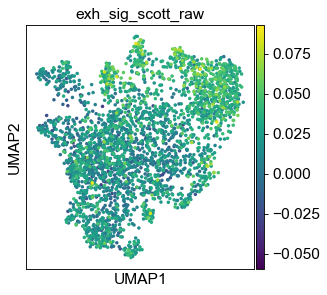

In [43]:
sc.pl.umap(adata, color='exh_sig_scott_raw', 
          save='_score_scott_2019_raw')

### Make heatmaps - Vd2+, Vd2- TP-, Vd2- TP+

#### Make labels

In [46]:
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2neg_v2_colors', 'tp_colors', 'trdv_colors'
    obsm: 'X_pca', 'X_umap'
    var

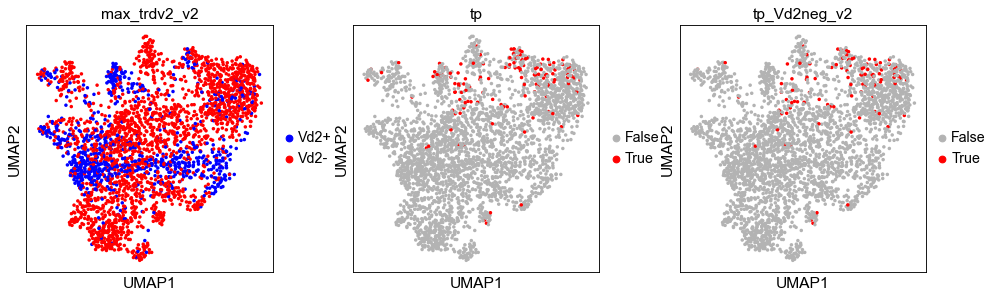

In [52]:
sc.pl.umap(adata, color=['max_trdv2_v2', 'tp','tp_Vd2neg_v2'])

In [53]:
print(adata.obs['max_trdv2_v2'].value_counts())
print(adata.obs['tp'].value_counts())
print(adata.obs['tp_Vd2neg_v2'].value_counts())

Vd2-    2167
Vd2+     857
Name: max_trdv2_v2, dtype: int64
False    2887
True      137
Name: tp, dtype: int64
False    2921
True      103
Name: tp_Vd2neg_v2, dtype: int64


In [77]:
# prepare ptt_vs_Vd2 label
ptt_vs_Vd2 = adata.obs['max_trdv2_v2'].astype(str)
ptt = np.array(adata.obs['max_trdv2_v2'] == 'Vd2-') & np.array(adata.obs['tp'] == 'True')
ptt_vs_Vd2[ptt] = 'Vd2-tp+'
ptt_vs_Vd2[ptt_vs_Vd2 == 'Vd2-'] = 'Vd2-tp-'
ptt_vs_Vd2

index
0       Vd2-tp-
1       Vd2-tp+
2          Vd2+
3       Vd2-tp+
4       Vd2-tp+
         ...   
3019    Vd2-tp-
3020    Vd2-tp-
3021    Vd2-tp-
3022    Vd2-tp-
3023    Vd2-tp-
Name: max_trdv2_v2, Length: 3024, dtype: object

In [78]:
# add ptt_vs_Vd2 label to adata.obs
adata.obs['ptt_vs_Vd2'] = ptt_vs_Vd2
adata.obs['ptt_vs_Vd2'].value_counts()

Vd2-tp-    2064
Vd2+        857
Vd2-tp+     103
Name: ptt_vs_Vd2, dtype: int64

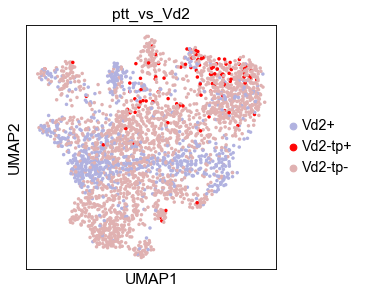

In [91]:
# pick color palette
sc.pl.umap(adata, color='ptt_vs_Vd2', palette=['#b1b2e0', '#ff0505', '#e0b1b1'], 
          save='_ptt_vs_Vd2')

In [93]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

#sc.tl.rank_genes_groups(adata, 'tp_Vd2neg_v2', method='wilcoxon', n_genes = 500)
sc.tl.rank_genes_groups(adata, groupby='ptt_vs_Vd2', method='wilcoxon', n_genes = 500)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:12)


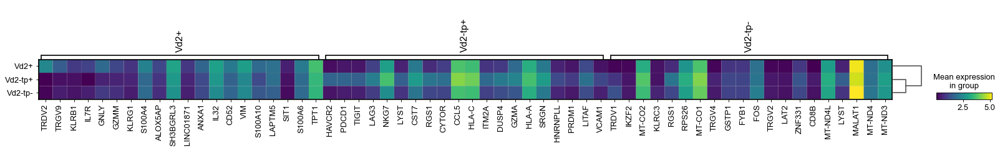

In [95]:
#axs = sc.pl.rank_genes_groups_matrixplot(adata, n_genes=20, standard_scale='var', cmap='Blues')
axs = sc.pl.rank_genes_groups_matrixplot(adata, n_genes=20, 
                                         save='ptt_vs_Vd2_20')

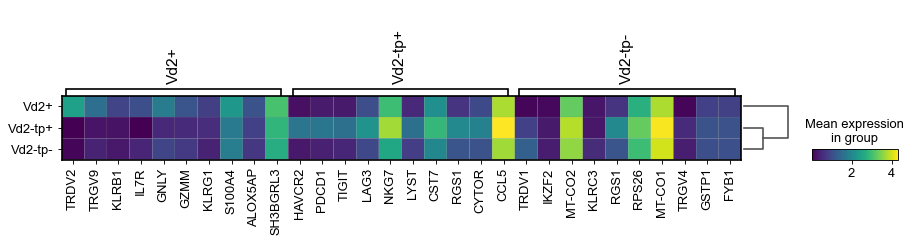

In [96]:
axs = sc.pl.rank_genes_groups_matrixplot(adata, n_genes=10, 
                                         save='ptt_vs_Vd2_10')

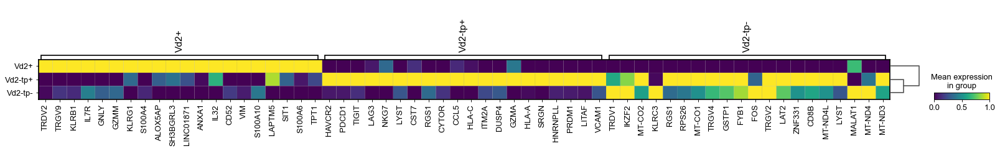

In [99]:
axs = sc.pl.rank_genes_groups_matrixplot(adata, n_genes=20, standard_scale='var', 
                                         save='ptt_vs_Vd2_20_scaled')

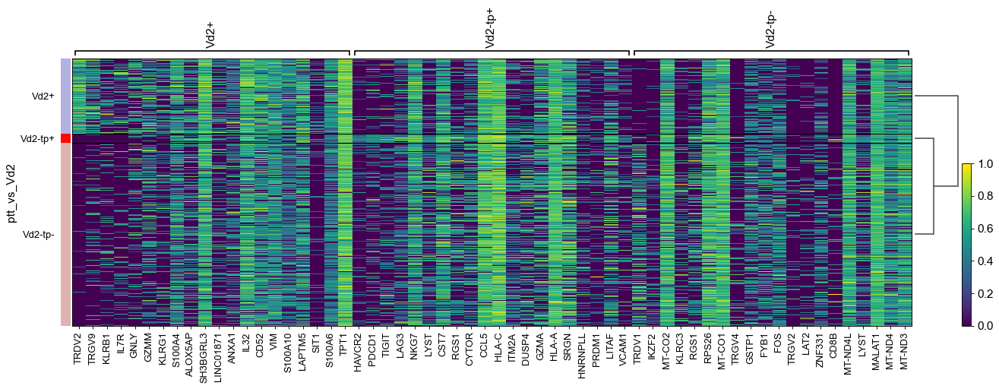

In [106]:
sc.pl.rank_genes_groups_heatmap(adata, n_genes=20, standard_scale='var', show_gene_labels=True,
                               save='_ptt_vs_Vd2_20_scaled')

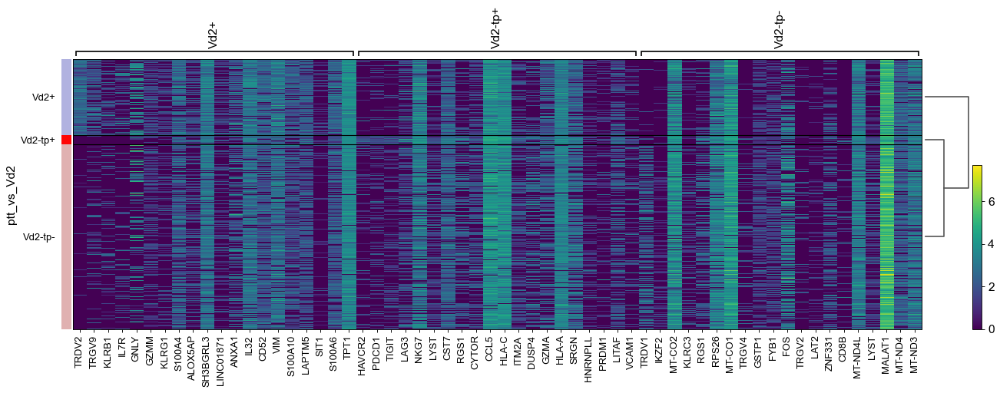

In [103]:
sc.pl.rank_genes_groups_heatmap(adata, n_genes=20, show_gene_labels=True)

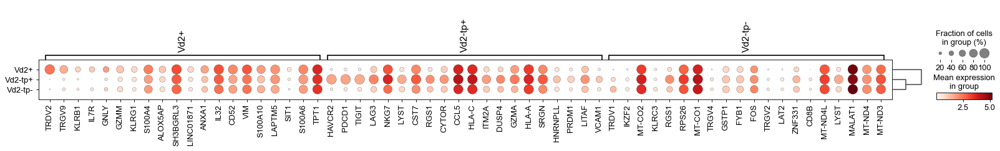

In [105]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=20)

In [108]:
adata.write(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2neg_v2_colors', 'tp_colors', 'trdv_colors', 'ptt_vs_Vd2_colors',

### Tue. Oct. 19

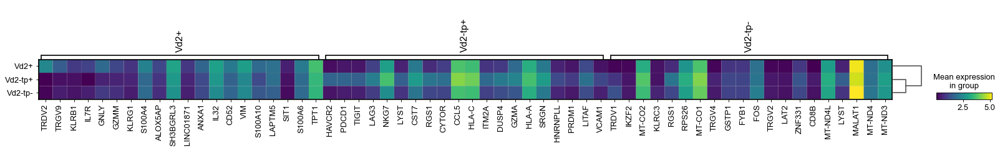

In [15]:
axs = sc.pl.rank_genes_groups_matrixplot(adata, n_genes=20)

/Users/brandonkevinchen/miniconda3/envs/scanpy3/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  _ = ax.pcolor(_color_df, **kwds)


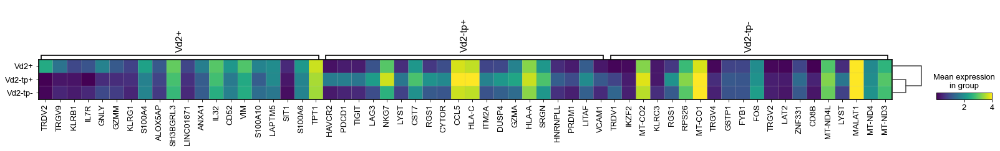

In [16]:
axs = sc.pl.rank_genes_groups_matrixplot(adata, n_genes=20, vmax=4, save='matrixplot_ptt_vs_Vd2_20_vmax4')

/Users/brandonkevinchen/miniconda3/envs/scanpy3/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  _ = ax.pcolor(_color_df, **kwds)


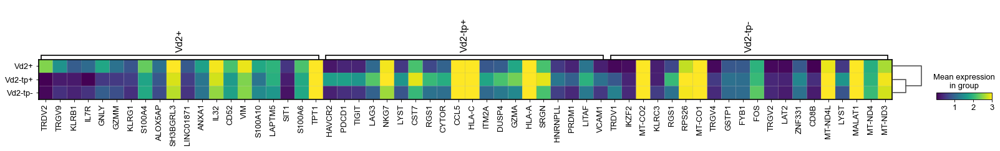

In [18]:
axs = sc.pl.rank_genes_groups_matrixplot(adata, n_genes=20, vmax=3, save='matrixplot_ptt_vs_Vd2_20_vmax3')

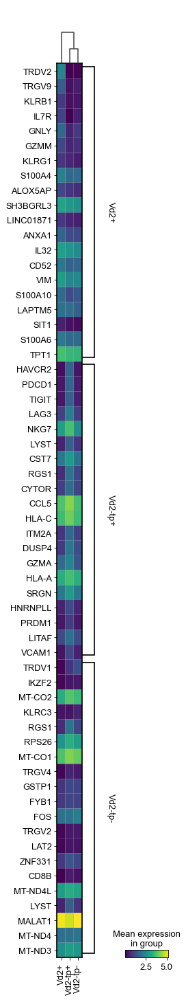

In [19]:
axs = sc.pl.rank_genes_groups_matrixplot(adata, n_genes=20, swap_axes=True, save='matrixplot_ptt_vs_Vd2_20_vert')

In [20]:
adata.obs['tp_Vd2neg_v2'].value_counts()

False    2921
True      103
Name: tp_Vd2neg_v2, dtype: int64

In [21]:
adata.obs['ptt_vs_Vd2'].value_counts()

Vd2-tp-    2064
Vd2+        857
Vd2-tp+     103
Name: ptt_vs_Vd2, dtype: int64

In [22]:
adata.write(results_file)

### Wed. Oct. 20

In [24]:
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2neg_v2_colors', 't

In [39]:
pttTop20 = ['HAVCR2', 'PDCD1', 'TIGIT', 'LAG3', 'NKG7',
            'CST7', 'CCL5', 'CTSW', 'LYST', 'CCL3',
            'CCL4', 'PRF1', 'PTMS', 'APOBEC3G', 'RPL41', 
            'KLRD1', 'CYTOR', 'HLA-C', 'LITAF', 'CCL4L2']

In [52]:
labelOrder = ['Vd2-tp+','Vd2-tp-', 'Vd2+']

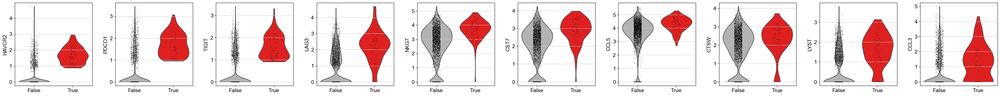

In [104]:
sc.pl.violin(adata, pttTop20[:10], groupby='tp_Vd2neg_v2', xlabel=' ', save='_ptt_1-10')

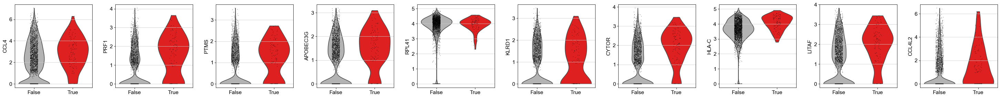

In [105]:
sc.pl.violin(adata, pttTop20[10:], groupby='tp_Vd2neg_v2', xlabel=' ', save='_ptt_11-20')

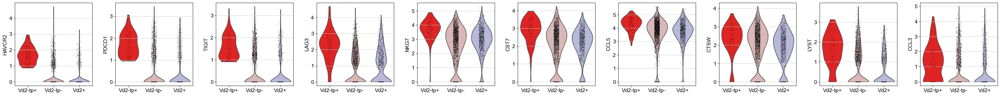

In [112]:
sc.pl.violin(adata, pttTop20[:10], groupby='ptt_vs_Vd2', xlabel=' ', order=labelOrder, save='_ptt_vs_Vd2_1-10')

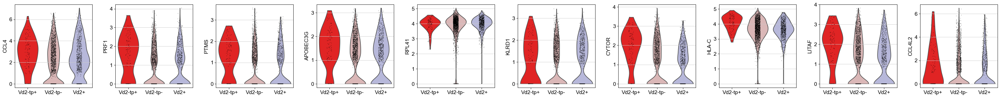

In [113]:
sc.pl.violin(adata, pttTop20[10:], groupby='ptt_vs_Vd2', xlabel=' ', order=labelOrder, save='_ptt_vs_Vd2_11-20')

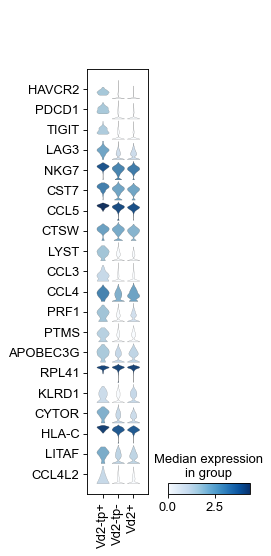

In [134]:
sc.pl.stacked_violin(adata, pttTop20, groupby='ptt_vs_Vd2',
                     swap_axes=True, categories_order=labelOrder, save='ptt_vs_Vd2')

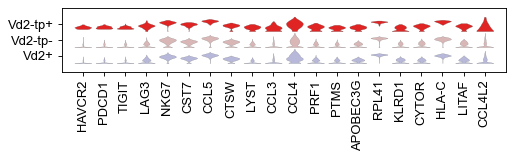

In [130]:
sc.pl.stacked_violin(adata, pttTop20, groupby='ptt_vs_Vd2', row_palette=['#ff0505', '#e0b1b1', '#b1b2e0'],
                     swap_axes=False, categories_order=labelOrder, save='ptt_vs_Vd2_colored')

## 20. Nov 24, 2021 <a class='anchor' id='20'></a>

[Table of contents](#toc)

In [6]:
adata = sc.read(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2neg_v2_colors', 't

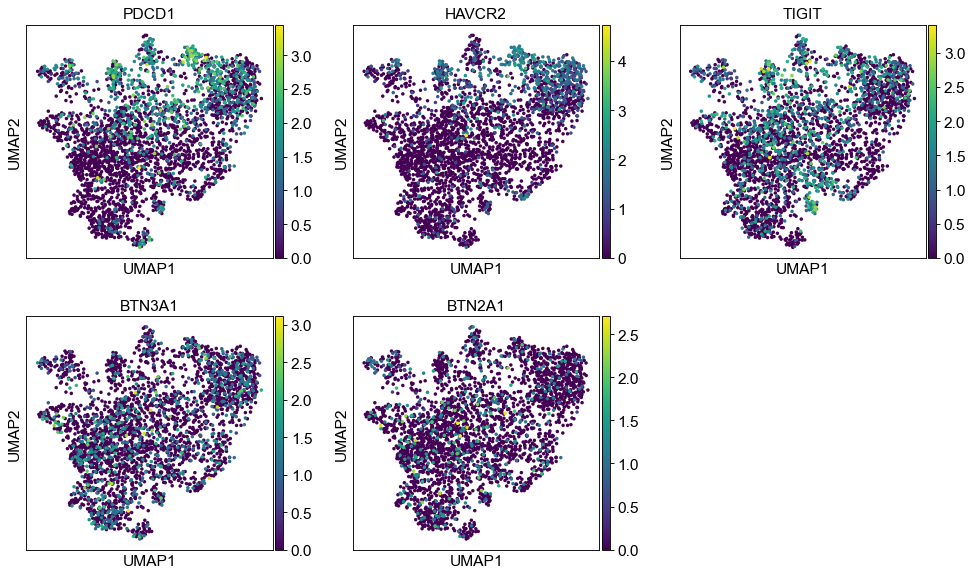

In [12]:
sc.pl.umap(adata, color=['PDCD1', 'HAVCR2', 'TIGIT',
                         'BTN3A1', 'BTN2A1'], ncols=3, 
          save='_BTN')

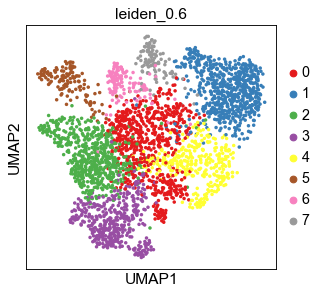

In [14]:
sc.pl.umap(adata, color=['leiden_0.6'])

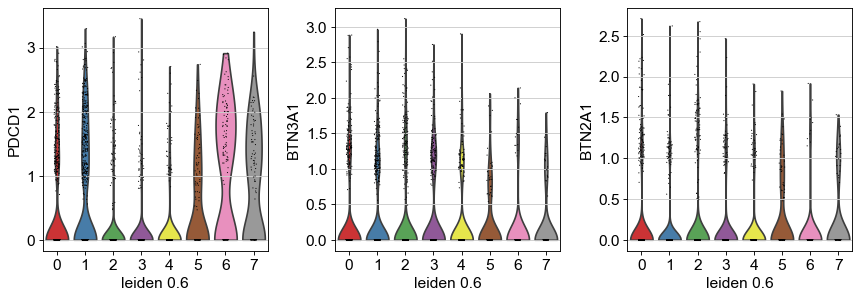

In [23]:
sc.pl.violin(adata, ['PDCD1', 'BTN3A1', 'BTN2A1'], groupby='leiden_0.6', save='_BTN')

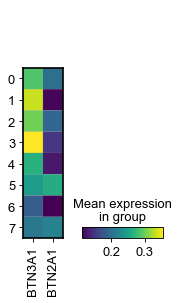

In [20]:
sc.pl.matrixplot(adata, ['BTN3A1', 'BTN2A1'], groupby='leiden_0.6', save='_BTN')

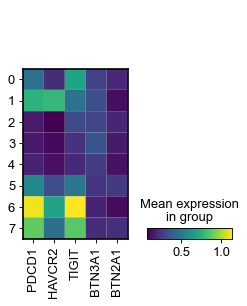

In [21]:
sc.pl.matrixplot(adata, ['PDCD1', 'HAVCR2', 'TIGIT',
                         'BTN3A1', 'BTN2A1'], groupby='leiden_0.6', save='_BTN_PTT')

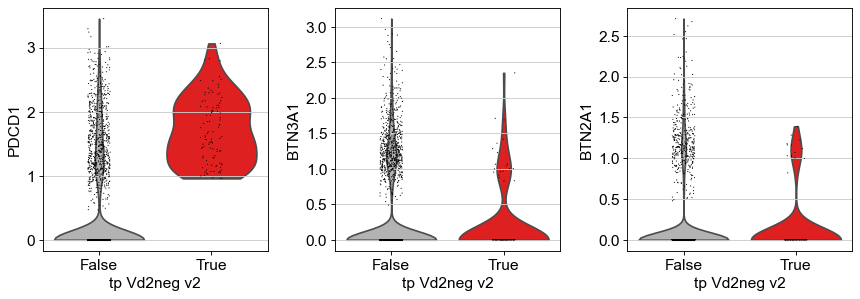

In [24]:
sc.pl.violin(adata, ['PDCD1', 'BTN3A1', 'BTN2A1'], groupby='tp_Vd2neg_v2', save='_BTN_by_PTT')

## 21. Dec 21, 2021 (Tue) <a class='anchor' id='21'></a>

[Table of contents](#toc)

### B. Fig 5B - UMAP colored by Vd2- gene signature score

In [18]:
adata = sc.read(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2neg_v2_colors', 't

In [19]:
gd_vd2neg_sig = ['TRDV1', 'RPL41', 'TRDC', 'CTSW', 'KLRD1', 'RPS10', 'RPS29', 'RPL36A', 'ZNF683', 'CCL5', 
                 'XCL2', 'MATK', 'LINC02446', 'KLRC3', 'XCL1', 'AOAH', 'NKG7', 'TRG-AS1', 'CRTAM', 'CD7']

In [20]:
len(gd_vd2neg_sig)

20

In [21]:
n = 0
for gene in gd_vd2neg_sig:
    if gene in adata.var.index:
        n += 1
print(n)

9


In [26]:
# use raw gene data
n = 0
for gene in gd_vd2neg_sig:
    if gene in adata.raw.var.index:
        n += 1
print(n)

20


In [27]:
sc.tl.score_genes(adata, gd_vd2neg_sig, 
                  score_name = 'sig_vd2-_raw', use_raw=True) # uses 20/20 genes

computing score 'sig_vd2-_raw'
    finished: added
    'sig_vd2-_raw', score of gene set (adata.obs).
    97 total control genes are used. (0:00:00)


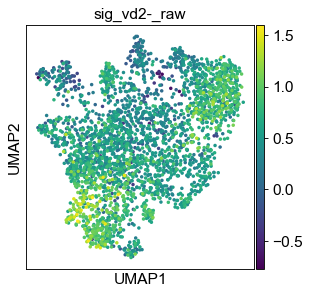

In [28]:
sc.pl.umap(adata, color='sig_vd2-_raw', 
          save='_score_vd2neg_raw')

### C. Fig 5C - Violin plots

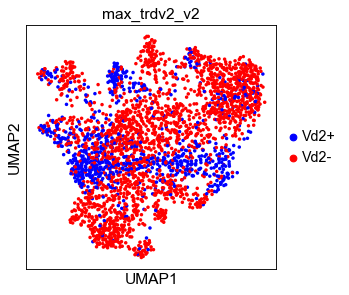

In [33]:
sc.pl.umap(adata, color=['max_trdv2_v2'])

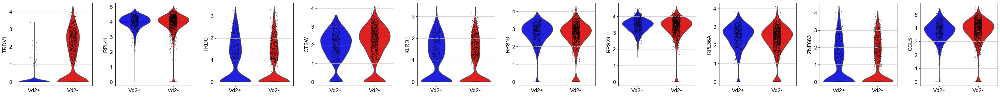

In [36]:
sc.pl.violin(adata, gd_vd2neg_sig[:10], groupby='max_trdv2_v2', xlabel=' ', 
             #order=labelOrder, 
             save='_vd2-_1-10')

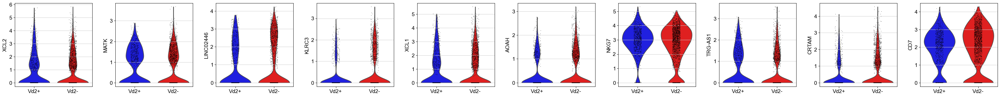

In [38]:
sc.pl.violin(adata, gd_vd2neg_sig[10:], groupby='max_trdv2_v2', xlabel=' ', 
             #order=labelOrder, 
             save='_vd2-_11-20')

In [39]:
adata.write(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2ne

## 22. Feb 23, 2022 (Wed) <a class='anchor' id='22'></a>

[Table of contents](#toc)

In [5]:
adata = sc.read(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2ne

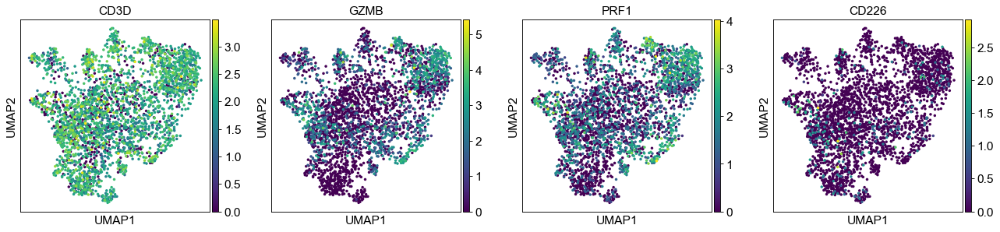

In [16]:
sc.pl.umap(adata, color=['CD3D', 'GZMB', 'PRF1', 'CD226'], save='_CD226')

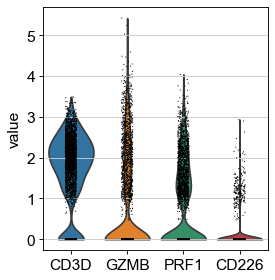

In [15]:
sc.pl.violin(adata, keys=['CD3D', 'GZMB', 'PRF1', 'CD226'], save='_CD226')

## 23. Apr 25, 2022 <a class='anchor' id='23'></a>
[Table of contents](#toc)

In [4]:
adata = sc.read(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2ne

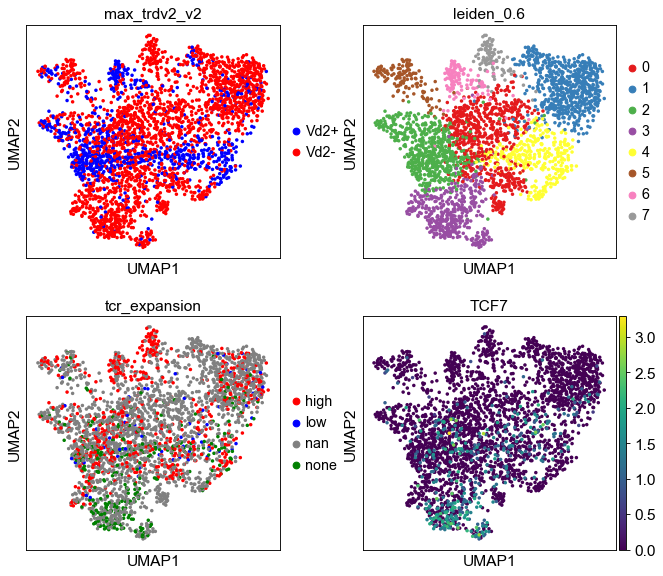

In [24]:
sc.pl.umap(adata, color = ['max_trdv2_v2', 'leiden_0.6', 'tcr_expansion', 'TCF7'], ncols=2,
          save = '_TCF7_context')

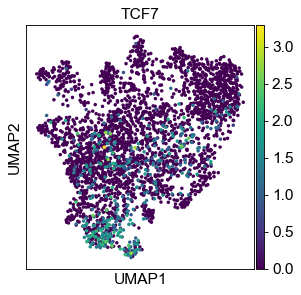

In [23]:
sc.pl.umap(adata, color = ['TCF7'], save='_TCF7')

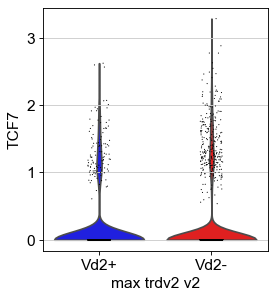

In [27]:
sc.pl.violin(adata, ['TCF7'], groupby='max_trdv2_v2', save='_TCF7_Vd2')

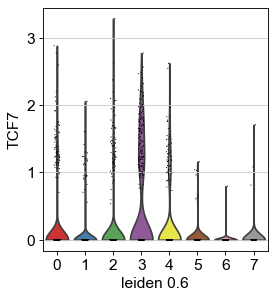

In [26]:
sc.pl.violin(adata, ['TCF7'], groupby='leiden_0.6', save='_TCF7_by_cluster')

/Users/brandonkevinchen/miniconda3/envs/scanpy3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:>

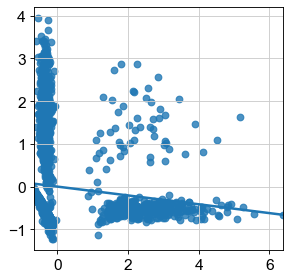

In [184]:
import seaborn as sns

x = np.array(adata[:, ['TCF7']].X.reshape((adata.shape[0])))
y = np.array(adata[:, ['PDCD1']].X.reshape((adata.shape[0])))

#create scatterplot with regression line
sns.regplot(x, y, ci=None)

/Users/brandonkevinchen/miniconda3/envs/scanpy3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:>

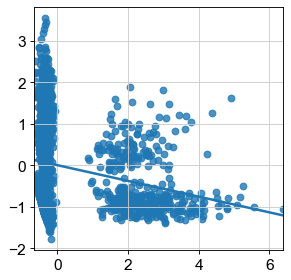

In [186]:
x = np.array(adata[:, ['TCF7']].X.reshape((adata.shape[0])))
y = np.array(adata[:, ['LAG3']].X.reshape((adata.shape[0])))

#create scatterplot with regression line
sns.regplot(x, y, ci=None)

/Users/brandonkevinchen/miniconda3/envs/scanpy3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:>

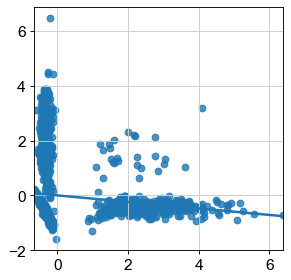

In [187]:
x = np.array(adata[:, ['TCF7']].X.reshape((adata.shape[0])))
y = np.array(adata[:, ['HAVCR2']].X.reshape((adata.shape[0])))

#create scatterplot with regression line
sns.regplot(x, y, ci=None)

### Apr 26, 2022 (Tue)

In [8]:
# dotplot
fig4e_marker_dict = {
                 'Exhaustion': ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'ENTPD1', 'TOX'],       
                 'Activation': ['TNFRSF9', 'MKI67'],          
                 'Cytotoxic': ['PRF1', 'GZMB', 'GZMA', 'GZMK'],
                 'Cytokine': ['TNF', 'IFNG', 'IL2'],
                 'Misc': ['TCF7']}

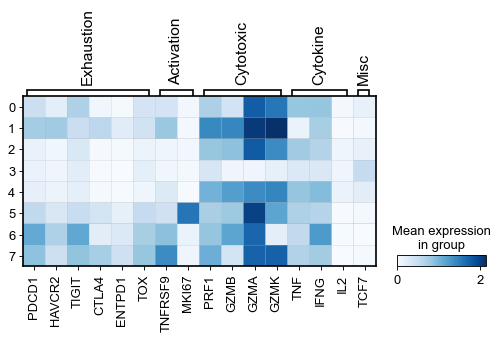

In [10]:
# matrixplot (heatmap)
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6', dendrogram=False, 
                 cmap='Blues', save='_fig4e_tcf7')

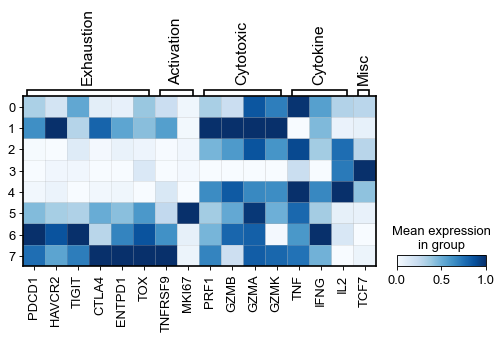

In [11]:
# matrixplot (heatmap)
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_tcf7_scaled')

## 24. May 24, 2022 <a class='anchor' id='24'></a>
[Table of contents](#toc)

In [4]:
adata = sc.read(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2ne

### 16a. freq Vd1 vs Vd3

In [7]:
adata.obs['max_trdv_v2'].value_counts()

TRDV1          1081
TRDV2           857
TRAV14DV4       386
TRAV29DV5       220
TRAV23DV6       218
TRDV3           191
TRAV38-2DV8      52
TRAV36DV7        19
Name: max_trdv_v2, dtype: int64

In [9]:
trdv_counts = pd.DataFrame(adata.obs['max_trdv_v2'].value_counts())
trdv_counts

,max_trdv_v2
TRDV1,1081
TRDV2,857
TRAV14DV4,386
TRAV29DV5,220
TRAV23DV6,218
TRDV3,191
TRAV38-2DV8,52
TRAV36DV7,19


In [12]:
trdv_counts.to_csv('outputs/trdv_counts.csv')

In [14]:
adata.obs['single_trdv'].value_counts()

nan          1740
TRDV2         650
TRDV1         461
TRAV29DV5     111
TRDV3          59
TRAV14DV4       1
TRAV23DV6       1
TRAV36DV7       1
Name: single_trdv, dtype: int64

In [15]:
trdv_counts = pd.DataFrame(adata.obs['single_trdv'].value_counts())
trdv_counts

,single_trdv
nan,1740
TRDV2,650
TRDV1,461
TRAV29DV5,111
TRDV3,59
TRAV14DV4,1
TRAV23DV6,1
TRAV36DV7,1


In [16]:
trdv_counts.to_csv('outputs/counts_single_trdv.csv')

### 16b. TCR expansion

In [6]:
adata.obs['tcr_expansion'].value_counts()

nan     1991
high     637
none     320
low       76
Name: tcr_expansion, dtype: int64

In [11]:
df = adata.obs[['tcr_expansion', 'max_trdv2_v2']]
df

,tcr_expansion,max_trdv2_v2
index,,
0,nan,Vd2-
1,high,Vd2-
2,nan,Vd2+
3,nan,Vd2-
4,nan,Vd2-
...,...,...
3019,nan,Vd2-
3020,nan,Vd2-
3021,nan,Vd2-


In [15]:
df2 = pd.DataFrame(df.groupby(['max_trdv2_v2', 'tcr_expansion']).size())
df2.to_csv('outputs/counts_exp_by_vd2.csv')
df2

0
max_trdv2_v2 tcr_expansion      
Vd2+         high            312
             low              33
             nan             376
             none            136
Vd2-         high            325
             low              43
             nan            1615
             none            184

## 25. Aug 11, 2022 - Vd chain data <a class='anchor' id='25'></a>
[Table of contents](#toc)

In [5]:
adata = sc.read(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2ne

### A. Get Vd2- gene set scores, cut by max_trdv_v2 Vd chain labels

In [6]:
adata.obs.head()

,barcode,doublet,sample_id,n_genes,percent_mito,n_counts,leiden,batch_name,cell.barcode,tcr_expansion,...,max_trdv_v2,max_trdv2_v2,tp_Vd2neg_v2,exh_sig_scott,exh_sig_ptt,exh_sig_ptt_raw,exh_sig_bengsch_raw,exh_sig_scott_raw,ptt_vs_Vd2,sig_vd2-_raw
index,,,,,,,,,,,,,,,,,,,,,
0,AAACCTGCACAGCCCA-1,SNG,KID21,1852,0.027119,5273.0,1,Chiara_Kidney_Pooled_gdTCR,AAACCTGCACAGCCCA-1,nan,...,TRDV1,Vd2-,False,0.050725,0.263952,1.047894,0.075503,0.061164,Vd2-tp-,0.781219
1,AAACCTGCAGGACCCT-1,SNG,KID21,1761,0.041157,6463.0,1,Chiara_Kidney_Pooled_gdTCR,AAACCTGCAGGACCCT-1,high,...,TRDV1,Vd2-,True,0.041005,1.106077,1.320339,0.068453,0.037306,Vd2-tp+,1.102228
2,AAACCTGCATTCACTT-1,SNG,KID19,1195,0.003381,2662.0,2,Chiara_Kidney_Pooled_gdTCR,AAACCTGCATTCACTT-1,nan,...,TRDV2,Vd2+,False,-0.013852,-0.221797,0.436365,-0.014625,0.018300,Vd2+,0.489947
3,AAACGGGAGCTAGTTC-1,SNG,KID21,1652,0.038266,5697.0,1,Chiara_Kidney_Pooled_gdTCR,AAACGGGAGCTAGTTC-1,nan,...,TRAV14DV4,Vd2-,True,0.038809,0.883561,1.595587,0.060334,0.044589,Vd2-tp+,0.812253
4,AAACGGGCAATACGCT-1,SNG,KID19,2057,0.037134,4201.0,5,Chiara_Kidney_Pooled_gdTCR,AAACGGGCAATACGCT-1,nan,...,TRAV29DV5,Vd2-,True,0.112923,0.823487,1.379016,0.050074,0.032970,Vd2-tp+,0.225186


In [14]:
df = adata.obs[['max_trdv_v2', 'sig_vd2-_raw']]
df

,max_trdv_v2,sig_vd2-_raw
index,,
0,TRDV1,0.781219
1,TRDV1,1.102228
2,TRDV2,0.489947
3,TRAV14DV4,0.812253
4,TRAV29DV5,0.225186
...,...,...
3019,TRAV14DV4,0.703170
3020,TRAV14DV4,0.640545
3021,TRDV1,0.550190


In [19]:
df.to_csv('outputs/genesig_by_vd2.csv', index = False)
df.head()

,max_trdv_v2,sig_vd2-_raw
index,,
0,TRDV1,0.781219
1,TRDV1,1.102228
2,TRDV2,0.489947
3,TRAV14DV4,0.812253
4,TRAV29DV5,0.225186


In [21]:
adata.write(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2ne

## 26. Sep 2, 2022 - CD8 exh score by subset, Fig 4 violins <a class='anchor' id='26'></a>
[Table of contents](#toc)

In [9]:
adata = sc.read(results_file)
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2ne

### A. CD8 exh score by subset

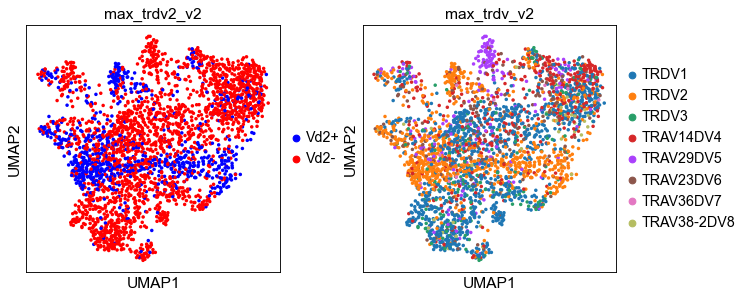

In [10]:
sc.pl.umap(adata, color=['max_trdv2_v2', 'max_trdv_v2'])

In [13]:
#sc.pl.umap(adata, color=['max_trdv_v2', 'exh_sig_scott'])

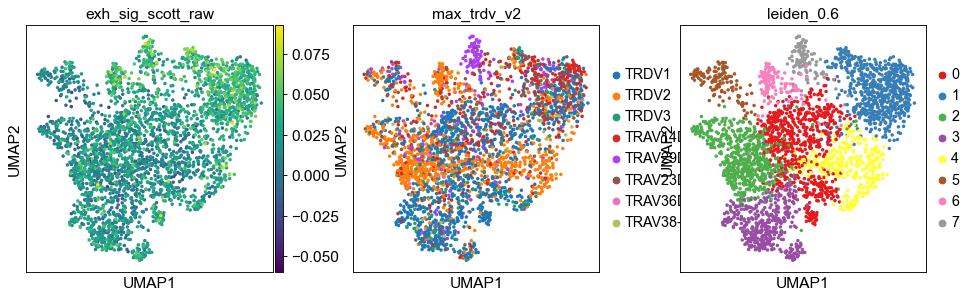

In [44]:
sc.pl.umap(adata, color=['exh_sig_scott_raw', 'max_trdv_v2', 'leiden_0.6'])

In [15]:
adata.obs.head()

,barcode,doublet,sample_id,n_genes,percent_mito,n_counts,leiden,batch_name,cell.barcode,tcr_expansion,...,max_trdv_v2,max_trdv2_v2,tp_Vd2neg_v2,exh_sig_scott,exh_sig_ptt,exh_sig_ptt_raw,exh_sig_bengsch_raw,exh_sig_scott_raw,ptt_vs_Vd2,sig_vd2-_raw
index,,,,,,,,,,,,,,,,,,,,,
0,AAACCTGCACAGCCCA-1,SNG,KID21,1852,0.027119,5273.0,1,Chiara_Kidney_Pooled_gdTCR,AAACCTGCACAGCCCA-1,nan,...,TRDV1,Vd2-,False,0.050725,0.263952,1.047894,0.075503,0.061164,Vd2-tp-,0.781219
1,AAACCTGCAGGACCCT-1,SNG,KID21,1761,0.041157,6463.0,1,Chiara_Kidney_Pooled_gdTCR,AAACCTGCAGGACCCT-1,high,...,TRDV1,Vd2-,True,0.041005,1.106077,1.320339,0.068453,0.037306,Vd2-tp+,1.102228
2,AAACCTGCATTCACTT-1,SNG,KID19,1195,0.003381,2662.0,2,Chiara_Kidney_Pooled_gdTCR,AAACCTGCATTCACTT-1,nan,...,TRDV2,Vd2+,False,-0.013852,-0.221797,0.436365,-0.014625,0.018300,Vd2+,0.489947
3,AAACGGGAGCTAGTTC-1,SNG,KID21,1652,0.038266,5697.0,1,Chiara_Kidney_Pooled_gdTCR,AAACGGGAGCTAGTTC-1,nan,...,TRAV14DV4,Vd2-,True,0.038809,0.883561,1.595587,0.060334,0.044589,Vd2-tp+,0.812253
4,AAACGGGCAATACGCT-1,SNG,KID19,2057,0.037134,4201.0,5,Chiara_Kidney_Pooled_gdTCR,AAACGGGCAATACGCT-1,nan,...,TRAV29DV5,Vd2-,True,0.112923,0.823487,1.379016,0.050074,0.032970,Vd2-tp+,0.225186


In [16]:
df = adata.obs[['max_trdv_v2', 'exh_sig_scott_raw']]
df

,max_trdv_v2,exh_sig_scott_raw
index,,
0,TRDV1,0.061164
1,TRDV1,0.037306
2,TRDV2,0.018300
3,TRAV14DV4,0.044589
4,TRAV29DV5,0.032970
...,...,...
3019,TRAV14DV4,0.031734
3020,TRAV14DV4,0.038555
3021,TRDV1,0.035873


In [17]:
df.to_csv('outputs/exh_sig_scott_by_vd.csv', index = False)
df.head()

,max_trdv_v2,exh_sig_scott_raw
index,,
0,TRDV1,0.061164
1,TRDV1,0.037306
2,TRDV2,0.018300
3,TRAV14DV4,0.044589
4,TRAV29DV5,0.032970


In [43]:
df = adata.obs[['leiden_0.6', 'exh_sig_scott_raw']]
df

,leiden_0.6,exh_sig_scott_raw
index,,
0,1,0.061164
1,1,0.037306
2,2,0.018300
3,1,0.044589
4,5,0.032970
...,...,...
3019,1,0.031734
3020,1,0.038555
3021,0,0.035873


In [45]:
df.to_csv('outputs/exh_sig_scott_by_cluster.csv', index = False)
df.head()

,leiden_0.6,exh_sig_scott_raw
index,,
0,1,0.061164
1,1,0.037306
2,2,0.018300
3,1,0.044589
4,5,0.032970


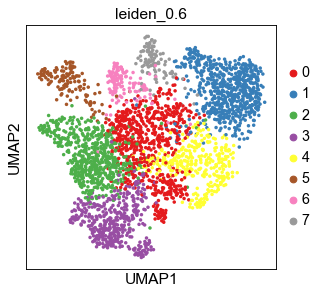

In [46]:
sc.pl.umap(adata, color='leiden_0.6', 
          save='_cluster_leiden_0.6')

### B. Fig 4 violins

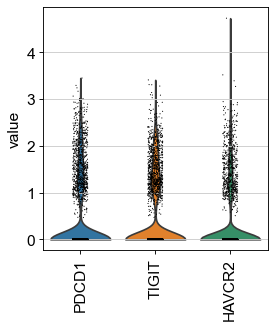

In [34]:
sc.pl.violin(adata, ['PDCD1', 'TIGIT', 'HAVCR2'], rotation=90, size=1, 
             save='_fig4_exh1')

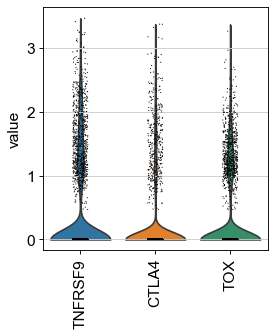

In [35]:
sc.pl.violin(adata, ['TNFRSF9', 'CTLA4', 'TOX'], rotation=90, size=1,
            save='_fig4_exh2')

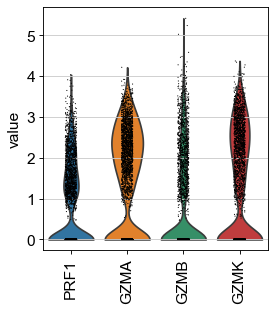

In [36]:
sc.pl.violin(adata, ['PRF1', 'GZMA', 'GZMB', 'GZMK'], rotation=90,
            save='_fig4_tox')

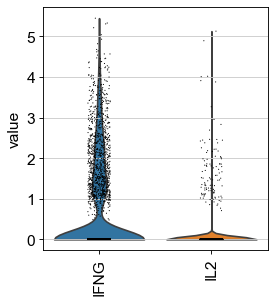

In [37]:
sc.pl.violin(adata, ['IFNG', 'IL2'], rotation=90,
            save='_fig4_cyto')

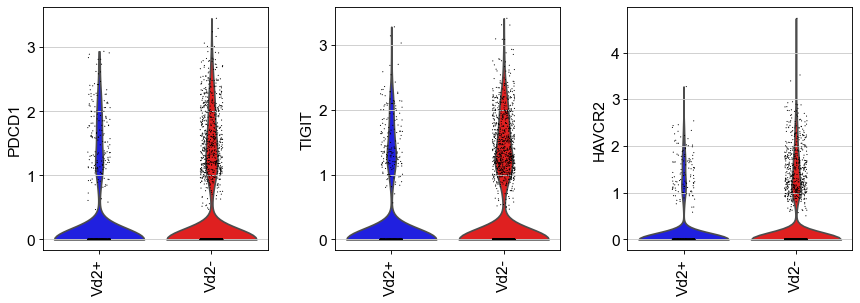

In [39]:
sc.pl.violin(adata, ['PDCD1', 'TIGIT', 'HAVCR2'], rotation=90, size=1, groupby='max_trdv2_v2', 
             save='_fig4_vd2_exh1')

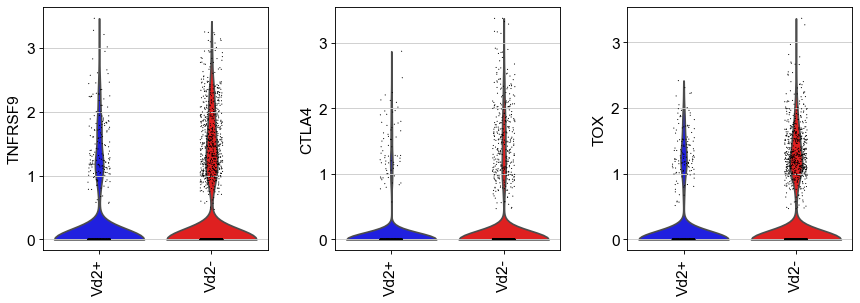

In [40]:
sc.pl.violin(adata, ['TNFRSF9', 'CTLA4', 'TOX'], rotation=90, size=1, groupby='max_trdv2_v2', 
            save='_fig4_vd2_exh2')

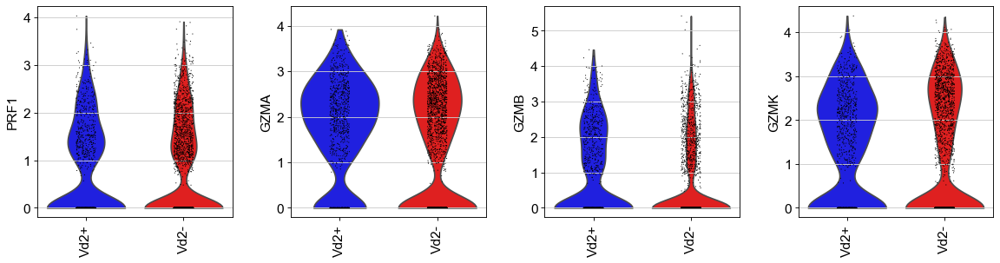

In [41]:
sc.pl.violin(adata, ['PRF1', 'GZMA', 'GZMB', 'GZMK'], rotation=90, groupby='max_trdv2_v2', 
            save='_fig4_vd2_tox')

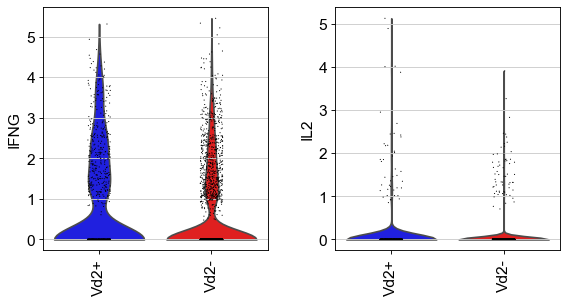

In [42]:
sc.pl.violin(adata, ['IFNG', 'IL2'], rotation=90, groupby='max_trdv2_v2', 
            save='_fig4_vd2_cyto')

In [47]:
adata.write(results_file)

## 27. Sep 22, 2022 (Thu) <a class='anchor' id='27'></a>

[Table of contents](#toc)

In [51]:
# column order
fig4e_marker_dict = {
                 'Exhaustion': ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'ENTPD1', 'TOX'],       
                 'Activation': ['TNFRSF9', 'MKI67', 'TCF7'],          
                 'Cytotoxic': ['PRF1', 'GZMB', 'GZMA', 'GZMK'],
                 'Cytokine': ['TNF', 'IFNG', 'IL2']}

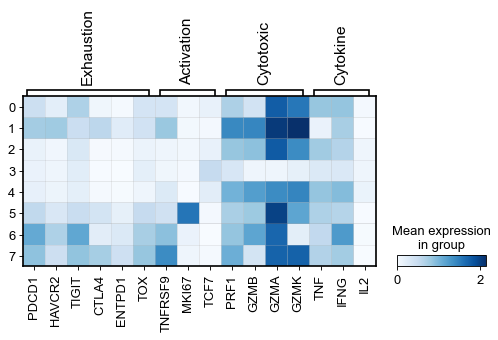

In [54]:
# matrixplot - add TCF7
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6', dendrogram=False, 
                 cmap='Blues', save='_fig4e_tcf7')

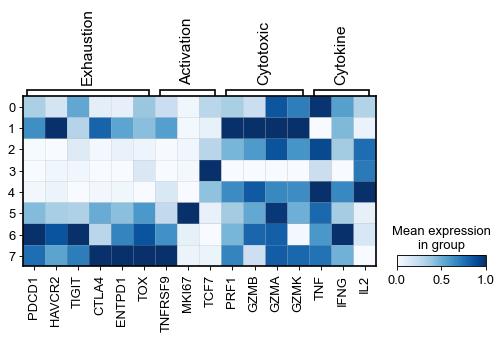

In [55]:
# matrixplot - add TCF7 (scaled)
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_tcf7_scaled')

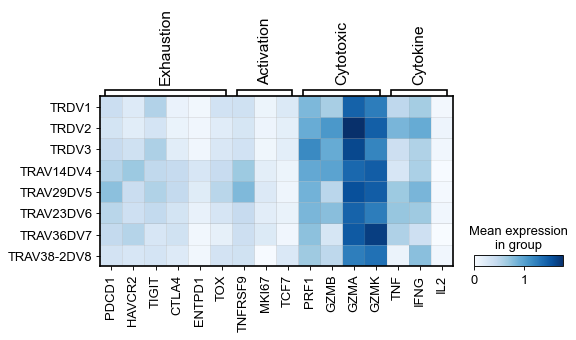

In [58]:
# matrixplot - by max_trdv_v2
sc.pl.matrixplot(adata, fig4e_marker_dict, 'max_trdv_v2', dendrogram=False, 
                 cmap='Blues', save='_fig4e_trdv')

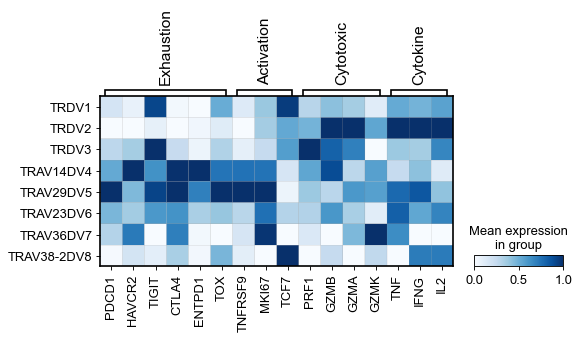

In [59]:
# matrixplot - by max_trdv_v2 (scaled)
sc.pl.matrixplot(adata, fig4e_marker_dict, 'max_trdv_v2', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_trdv_scaled')

## 28. Oct 10, 2022 (Mon) - re-color and re-label TCR expansion UMAP <a class='anchor' id='28'></a>

[Table of contents](#toc)

In [9]:
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_colors', 'tp_Vd2ne

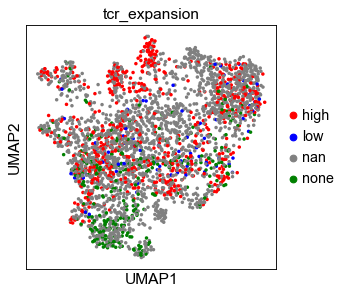

In [10]:
sc.pl.umap(adata, color='tcr_expansion')

In [11]:
adata.obs['tcr_expansion'].value_counts()

nan     1991
high     637
none     320
low       76
Name: tcr_expansion, dtype: int64

In [12]:
df = adata.obs[['tcr_expansion']]
df.head()

,tcr_expansion
index,
0,nan
1,high
2,nan
3,nan
4,nan


In [13]:
df['tcr_expansion2'] = df[['tcr_expansion']]
df.head()

<ipython-input-13-a5dc51f31d44>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tcr_expansion2'] = df[['tcr_expansion']]


,tcr_expansion,tcr_expansion2
index,,
0,nan,nan
1,high,high
2,nan,nan
3,nan,nan
4,nan,nan


In [14]:
df['tcr_expansion2'] = df['tcr_expansion2'].replace('none', 'singleton')
df['tcr_expansion2'] = df['tcr_expansion2'].replace(['high', 'low'], 'expanded')
df.head(10)

<ipython-input-14-c1f2d52f29cf>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tcr_expansion2'] = df['tcr_expansion2'].replace('none', 'singleton')
<ipython-input-14-c1f2d52f29cf>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tcr_expansion2'] = df['tcr_expansion2'].replace(['high', 'low'], 'expanded')


,tcr_expansion,tcr_expansion2
index,,
0,nan,nan
1,high,expanded
2,nan,nan
3,nan,nan
4,nan,nan
5,nan,nan
6,none,singleton
7,nan,nan
8,nan,nan


In [15]:
df.value_counts()

tcr_expansion  tcr_expansion2
nan            nan               1991
high           expanded           637
none           singleton          320
low            expanded            76
dtype: int64

In [16]:
adata.obs['tcr_expansion2'] = df[['tcr_expansion2']]
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw', 'tcr_expansion2'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_

In [17]:
adata.obs['tcr_expansion2'] = pd.Categorical(adata.obs['tcr_expansion2'], 
                                   categories=['expanded', 'singleton', 'nan'],
                                   ordered=False)

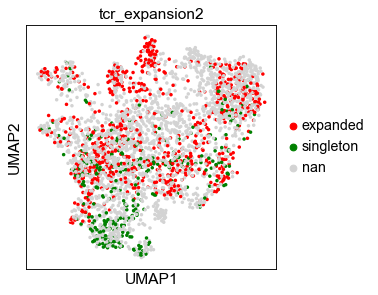

In [18]:
sc.pl.umap(adata, color='tcr_expansion2', palette=['red', 'green', 'lightgrey'])#,          save='_tcr_expansion2')

In [19]:
adata.write(results_file)

## 29. Oct 20, 2022 (Thu) - PTT/cytotox violins split by expansion <a class='anchor' id='29'></a>

[Table of contents](#toc)

In [20]:
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw', 'tcr_expansion2'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colors', 'single_trdv_colors', 'tcr_expansion_colors', 'tp_Vd2neg_

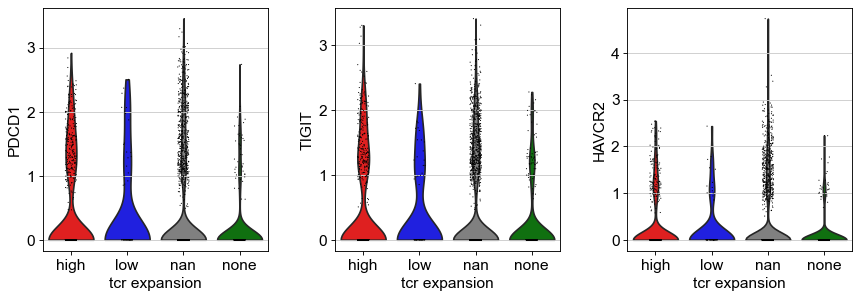

In [21]:
sc.pl.violin(adata, ['PDCD1', 'TIGIT', 'HAVCR2'], groupby='tcr_expansion')

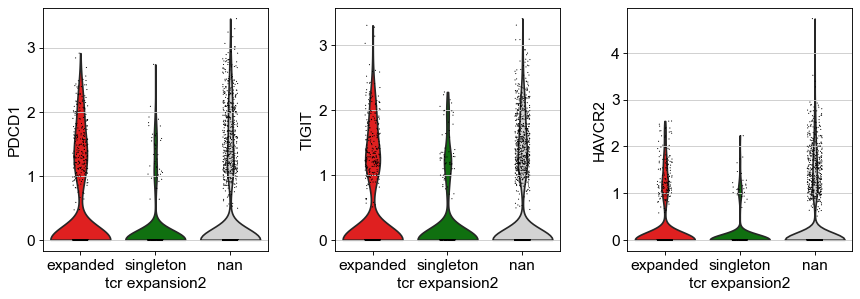

In [23]:
sc.pl.violin(adata, ['PDCD1', 'TIGIT', 'HAVCR2'], groupby='tcr_expansion2', save='_expansion_ptt')

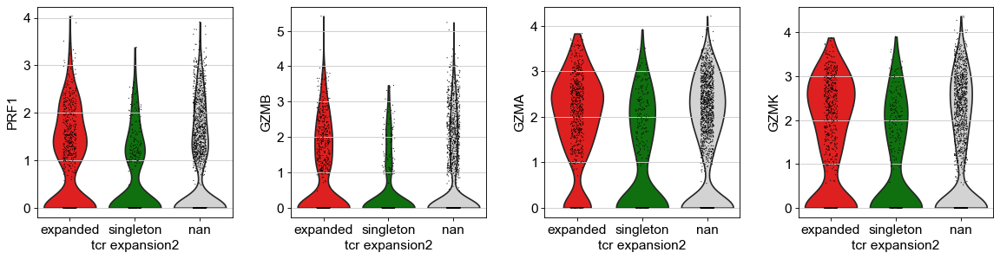

In [25]:
sc.pl.violin(adata, ['PRF1', 'GZMB', 'GZMA', 'GZMK'], groupby='tcr_expansion2', save='_expansion_cytotox')

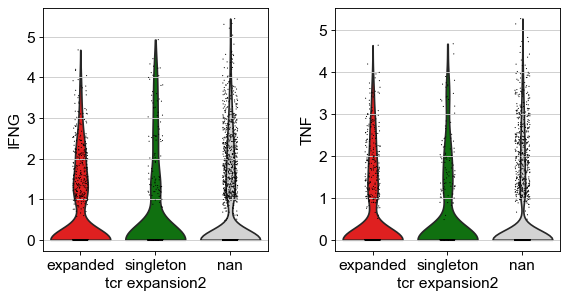

In [30]:
sc.pl.violin(adata, ['IFNG', 'TNF'], groupby='tcr_expansion2', save='_expansion_cytotox2')

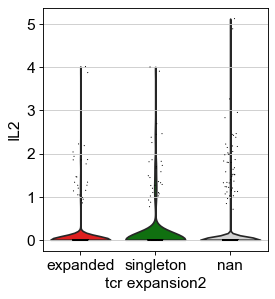

In [45]:
sc.pl.violin(adata, ['IL2'], groupby='tcr_expansion2')#, save='_expansion_cytotox2')

In [35]:
select_markers = ['PDCD1', 'TIGIT', 'HAVCR2', 'PRF1', 'GZMB', 'GZMA', 'GZMK', 'IFNG', 'TNF']

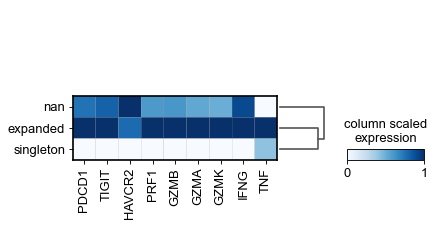

In [41]:
sc.pl.matrixplot(adata, select_markers, 'tcr_expansion2', 
                 dendrogram=True, cmap='Blues', standard_scale='var', colorbar_title='column scaled\nexpression',
                 save='_expansion_select')

In [37]:
# scale and store results in layer
adata.layers['scaled'] = sc.pp.scale(adata, copy=True).X

/Users/brandonkevinchen/miniconda3/envs/scanpy3/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  _ = ax.pcolor(_color_df, **kwds)


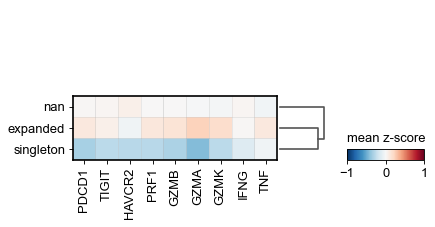

In [42]:
sc.pl.matrixplot(adata, select_markers, 'tcr_expansion2', dendrogram=True,
                 colorbar_title='mean z-score', layer='scaled', vmin=-1, vmax=1, cmap='RdBu_r',
                 save='_expansion_select_scaled')

/Users/brandonkevinchen/miniconda3/envs/scanpy3/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  _ = ax.pcolor(_color_df, **kwds)


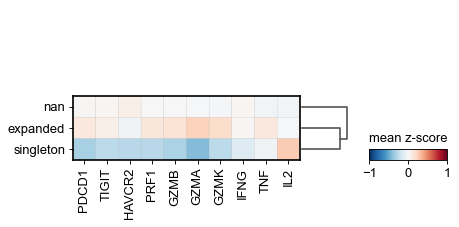

In [44]:
sc.pl.matrixplot(adata, select_markers+['IL2'], 'tcr_expansion2', dendrogram=True,
                 colorbar_title='mean z-score', layer='scaled', vmin=-1, vmax=1, cmap='RdBu_r', save='_expansion_select_scaled_IL2')

In [46]:
adata.write(results_file)

## 30. Oct 24, 2022 (Mon) - tweak expansion plots (drop nan, add IL2 violin) <a class='anchor' id='30'></a>

[Table of contents](#toc)

In [53]:
adata.obs.keys()

Index(['barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito',
       'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion',
       'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp',
       'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2',
       'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw',
       'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2',
       'sig_vd2-_raw', 'tcr_expansion2'],
      dtype='object')

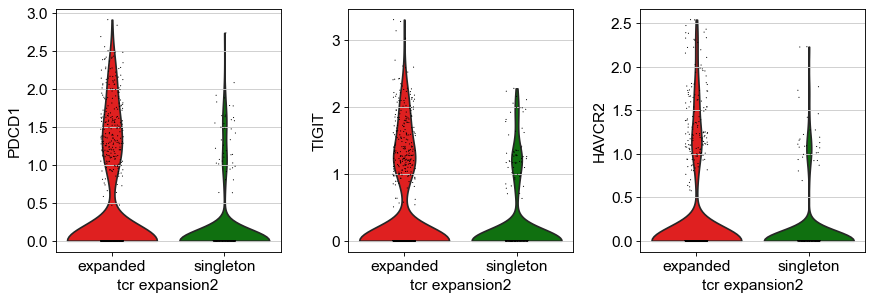

In [55]:
sc.pl.violin(adata[adata.obs['tcr_expansion2'] != 'nan'], 
             ['PDCD1', 'TIGIT', 'HAVCR2'], groupby='tcr_expansion2', save='_expansion_wo_nan_ptt')

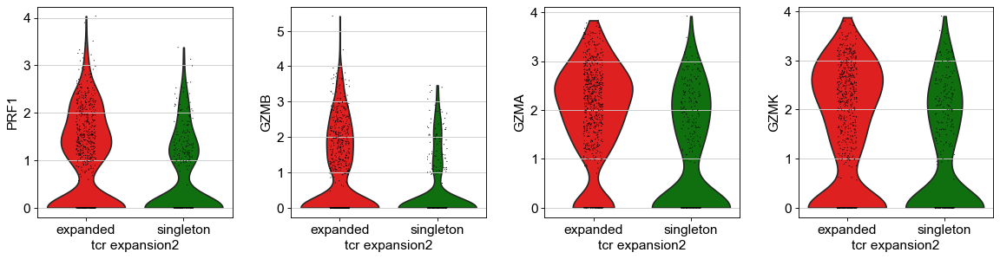

In [56]:
sc.pl.violin(adata[adata.obs['tcr_expansion2'] != 'nan'], 
             ['PRF1', 'GZMB', 'GZMA', 'GZMK'], groupby='tcr_expansion2', save='_expansion_wo_nan_cytotox')

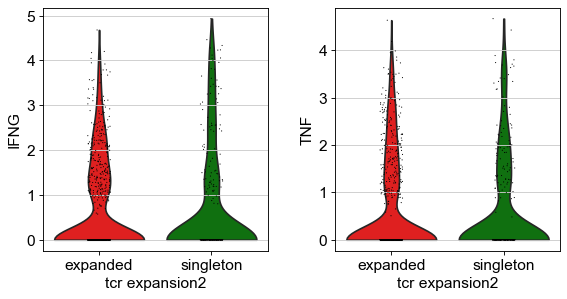

In [57]:
sc.pl.violin(adata[adata.obs['tcr_expansion2'] != 'nan'], 
             ['IFNG', 'TNF'], groupby='tcr_expansion2', save='_expansion_wo_nan_cytotox2')

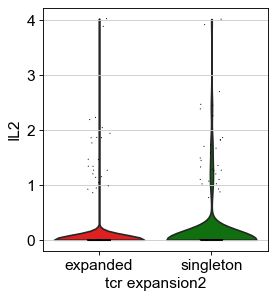

In [58]:
sc.pl.violin(adata[adata.obs['tcr_expansion2'] != 'nan'], 
             ['IL2'], groupby='tcr_expansion2', save='_expansion_wo_nan_cytotox3')

In [59]:
select_markers = ['PDCD1', 'TIGIT', 'HAVCR2', 'PRF1', 'GZMB', 'GZMA', 'GZMK', 'IFNG', 'TNF', 'IL2']

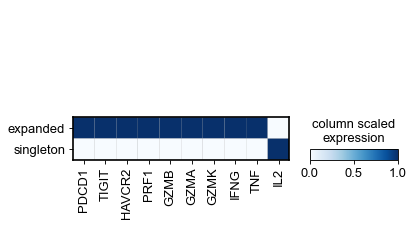

In [62]:
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], 
                 select_markers, 'tcr_expansion2', 
                 dendrogram=True, cmap='Blues', standard_scale='var', colorbar_title='column scaled\nexpression',
                 save='_expansion_wo_nan_select')

In [37]:
# scale and store results in layer
adata.layers['scaled'] = sc.pp.scale(adata, copy=True).X

/Users/brandonkevinchen/miniconda3/envs/scanpy3/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  _ = ax.pcolor(_color_df, **kwds)


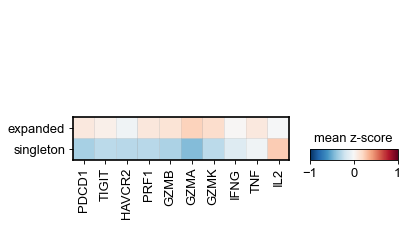

In [63]:
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], 
                 select_markers, 'tcr_expansion2', dendrogram=True,
                 colorbar_title='mean z-score', layer='scaled', vmin=-1, vmax=1, cmap='RdBu_r',
                 save='_expansion_wo_nan_select_scaled')

### Export updated adata.obs for Hai

In [ ]:
# adata.write recently run on test_tcr2.ipynb

In [64]:
adata.obs.keys()

Index(['barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito',
       'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion',
       'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp',
       'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2',
       'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw',
       'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2',
       'sig_vd2-_raw', 'tcr_expansion2'],
      dtype='object')

In [83]:
adata.obs[['barcode', 'sample_id', 
           'max_trdv_v2', 'max_trdv2_v2', 'tp', 'tp_Vd2neg_v2',
           'leiden_0.6', 'tcr_expansion2']]

,barcode,sample_id,max_trdv_v2,max_trdv2_v2,tp,tp_Vd2neg_v2,leiden_0.6,tcr_expansion2
index,,,,,,,,
0,AAACCTGCACAGCCCA-1,KID21,TRDV1,Vd2-,False,False,1,nan
1,AAACCTGCAGGACCCT-1,KID21,TRDV1,Vd2-,True,True,1,expanded
2,AAACCTGCATTCACTT-1,KID19,TRDV2,Vd2+,False,False,2,nan
3,AAACGGGAGCTAGTTC-1,KID21,TRAV14DV4,Vd2-,True,True,1,nan
4,AAACGGGCAATACGCT-1,KID19,TRAV29DV5,Vd2-,True,True,5,nan
...,...,...,...,...,...,...,...,...
3019,TTTGTCAAGACCCACC-1,KID21,TRAV14DV4,Vd2-,False,False,1,nan
3020,TTTGTCAAGCACGCCT-1,KID21,TRAV14DV4,Vd2-,False,False,1,nan
3021,TTTGTCAAGCCAGGAT-1,KID18,TRDV1,Vd2-,False,False,0,nan


In [86]:
df = adata.obs[['max_trdv2_v2', 'tp']]
df.value_counts()

max_trdv2_v2  tp   
Vd2-          False    2064
Vd2+          False     823
Vd2-          True      103
Vd2+          True       34
dtype: int64

In [87]:
df = adata.obs[['max_trdv2_v2', 'tp_Vd2neg_v2']]
df.value_counts()

max_trdv2_v2  tp_Vd2neg_v2
Vd2-          False           2064
Vd2+          False            857
Vd2-          True             103
dtype: int64

In [88]:
adata = sc.read(results_file)
adata.obs.head()

,barcode,doublet,sample_id,n_genes,percent_mito,n_counts,leiden,batch_name,cell.barcode,tcr_expansion,...,exh_sig_scott,exh_sig_ptt,exh_sig_ptt_raw,exh_sig_bengsch_raw,exh_sig_scott_raw,ptt_vs_Vd2,sig_vd2-_raw,tcr_expansion2,delta_expansion,delta_trdv
index,,,,,,,,,,,,,,,,,,,,,
0,AAACCTGCACAGCCCA-1,SNG,KID21,1852,0.027119,5273.0,1,Chiara_Kidney_Pooled_gdTCR,AAACCTGCACAGCCCA-1,NaN,...,0.050725,0.263952,1.047894,0.075503,0.061164,Vd2-tp-,0.781219,nan,expanded,TRDV1
1,AAACCTGCAGGACCCT-1,SNG,KID21,1761,0.041157,6463.0,1,Chiara_Kidney_Pooled_gdTCR,AAACCTGCAGGACCCT-1,expanded,...,0.041005,1.106077,1.320339,0.068453,0.037306,Vd2-tp+,1.102228,expanded,expanded,TRDV1
2,AAACCTGCATTCACTT-1,SNG,KID19,1195,0.003381,2662.0,2,Chiara_Kidney_Pooled_gdTCR,AAACCTGCATTCACTT-1,NaN,...,-0.013852,-0.221797,0.436365,-0.014625,0.018300,Vd2+,0.489947,nan,expanded,TRDV2
3,AAACGGGAGCTAGTTC-1,SNG,KID21,1652,0.038266,5697.0,1,Chiara_Kidney_Pooled_gdTCR,AAACGGGAGCTAGTTC-1,NaN,...,0.038809,0.883561,1.595587,0.060334,0.044589,Vd2-tp+,0.812253,nan,NaN,NaN
4,AAACGGGCAATACGCT-1,SNG,KID19,2057,0.037134,4201.0,5,Chiara_Kidney_Pooled_gdTCR,AAACGGGCAATACGCT-1,NaN,...,0.112923,0.823487,1.379016,0.050074,0.032970,Vd2-tp+,0.225186,nan,NaN,NaN


In [91]:
adata.obs.to_csv('gd_adata_obs3.csv', index = False)

## 31. Nov 3, 2022 (Thu) - tweak matrixplot (add IL17, act: DNAM-1, NKG2D, NKp30, NKp44, NKp46, CD16) <a class='anchor' id='31'></a>

[Table of contents](#toc)

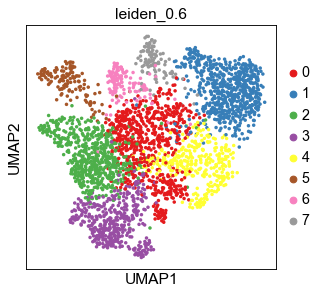

In [157]:
sc.pl.umap(adata, color='leiden_0.6')

In [154]:
# with IL17C
fig4e_marker_dict = {
                 'Exhaustion': ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'ENTPD1', 'TOX'],       
                 'Activation': ['TNFRSF9', 'CD226', 'KLRK1', 'NCR3', 'NCR2', 'NCR1', 'FCGR3A',
                                'MKI67', 'TCF7'],          
                 'Cytotoxic': ['PRF1', 'GZMB', 'GZMA', 'GZMK'],
                 'Cytokine': ['TNF', 'IFNG', 'IL2', 'IL17C']}

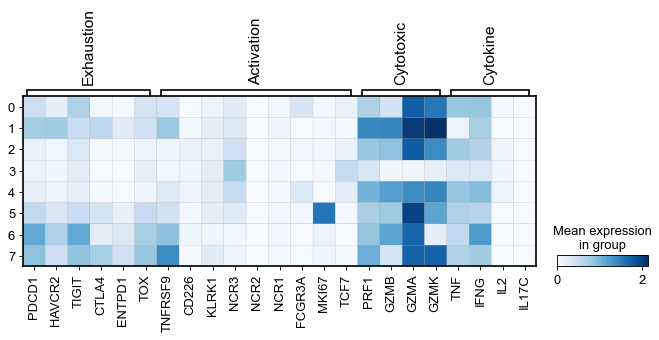

In [162]:
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6', dendrogram=False, 
                 cmap='Blues', save='_fig4e_1_w_actRs_IL17C')

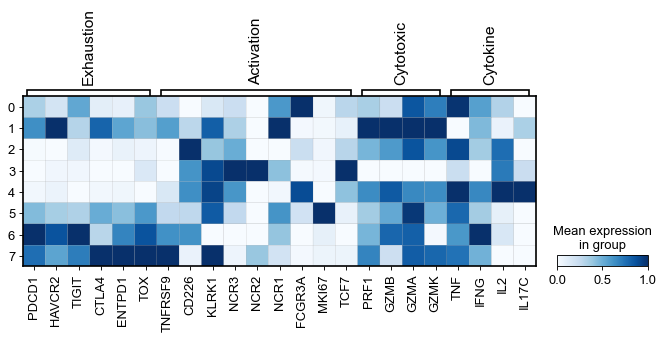

In [164]:
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_1_w_actRs_IL17C_scaled')

In [165]:
# additional activation receptors, without IL17C
#   DNAM-1, NKG2D, NKp30, NKp44, NKp46, CD16
#   CD226,  KLRK1, NCR3,  NCR2,  NCR1,  FCGR3A
fig4e_marker_dict = {
                 'Exhaustion': ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'ENTPD1', 'TOX'],       
                 'Activation': ['TNFRSF9', 'CD226', 'KLRK1', 'NCR3', 'NCR2', 'NCR1', 'FCGR3A',
                                'MKI67', 'TCF7'],          
                 'Cytotoxic': ['PRF1', 'GZMB', 'GZMA', 'GZMK'],
                 'Cytokine': ['TNF', 'IFNG', 'IL2']}

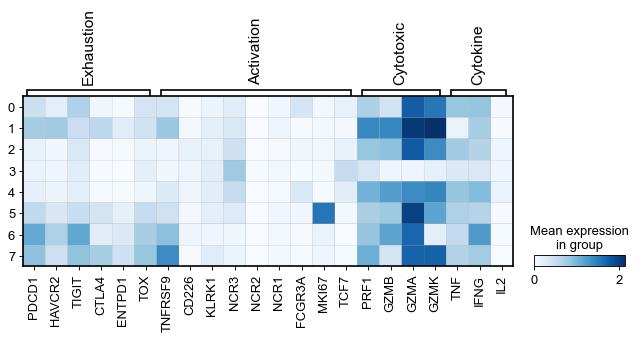

In [167]:
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6', dendrogram=False, 
                 cmap='Blues', save='_fig4e_1_w_actRs')

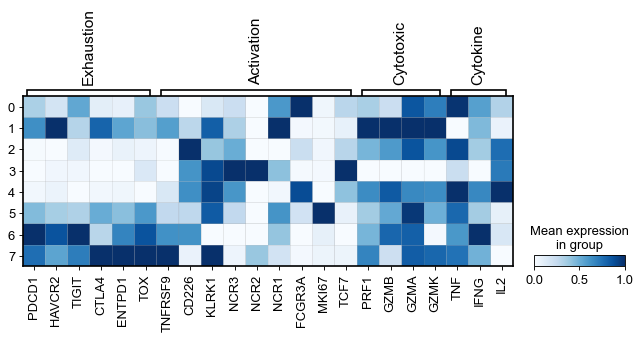

In [168]:
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_1_w_actRs_scaled')

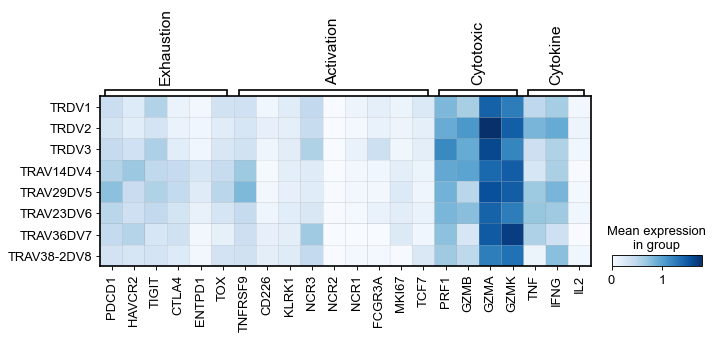

In [171]:
sc.pl.matrixplot(adata, fig4e_marker_dict, 'max_trdv_v2', dendrogram=False, 
                 cmap='Blues', save='_fig4e_1_w_actRs_max_trdv_v2')

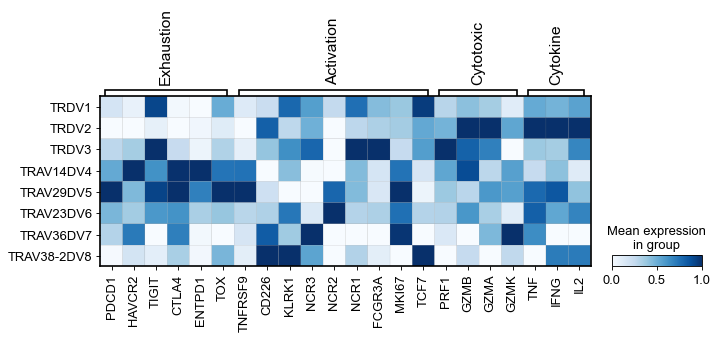

In [172]:
sc.pl.matrixplot(adata, fig4e_marker_dict, 'max_trdv_v2', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_1_w_actRs_max_trdv_v2_scaled')

In [175]:
adata.obs['single_trdv'].value_counts()

nan          1740
TRDV2         650
TRDV1         461
TRAV29DV5     111
TRDV3          59
TRAV14DV4       1
TRAV23DV6       1
TRAV36DV7       1
Name: single_trdv, dtype: int64

In [190]:
[True for i in adata.obs['single_trdv'] if i not in ['TRAV14DV4', 'TRAV23DV6', 'TRAV36DV7', 'nan'] else False]

SyntaxError: invalid syntax (<ipython-input-190-99a9832eda86>, line 1)

In [188]:
# matrixplot - by single_trdv2 (scaled)
select_cells = [i for i in adata.obs['single_trdv'] if i not in ['TRAV14DV4', 'TRAV23DV6', 'TRAV36DV7', 'nan']]

sc.pl.matrixplot(adata[select_cells, ], fig4e_marker_dict, 'single_trdv', dendrogram=False, 
                 cmap='Blues', standard_scale='var')#, save='_fig4e_trdv_scaled')

KeyError: "Values ['TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV3', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV3', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV3', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV3', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV3', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRAV29DV5', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRAV29DV5', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV1'], from ['TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV3', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV3', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV3', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV3', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV3', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRAV29DV5', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRAV29DV5', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV1', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV1', 'TRAV29DV5', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV1', 'TRAV29DV5', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV1', 'TRDV1', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV2', 'TRDV1', 'TRDV3', 'TRDV2', 'TRDV1', 'TRDV2', 'TRAV29DV5', 'TRDV3', 'TRDV2', 'TRDV2', 'TRDV3', 'TRDV1', 'TRDV1', 'TRDV1'], are not valid obs/ var names or indices."

### Which IL17 gene should I use?

In [139]:
[gene for gene in adata.raw.var_names if gene.startswith('IL17')]

['IL17RE', 'IL17RC', 'IL17C', 'IL17RA']

In [140]:
[gene for gene in adata.var_names if gene.startswith('IL17')]

['IL17RC']

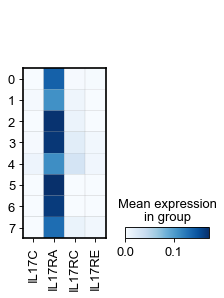

In [158]:
# matrixplot - IL17 (IL17RA)
sc.pl.matrixplot(adata, ['IL17C', 'IL17RA', 'IL17RC', 'IL17RE'], 'leiden_0.6', dendrogram=False, 
                 cmap='Blues', save='_IL17RA')

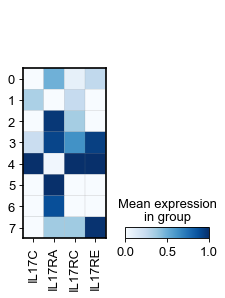

In [159]:
# matrixplot - IL17
sc.pl.matrixplot(adata, ['IL17C', 'IL17RA', 'IL17RC', 'IL17RE'], 'leiden_0.6', dendrogram=False, 
                 cmap='Blues', standard_scale='var')#, save='_fig4e_tcf7')

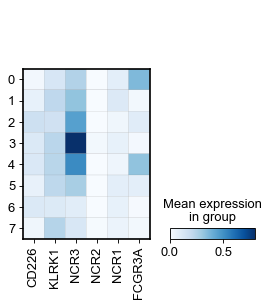

In [160]:
# matrixplot - additional activation receptors
sc.pl.matrixplot(adata, ['CD226', 'KLRK1', 'NCR3', 'NCR2', 'NCR1', 'FCGR3A'], 'leiden_0.6', dendrogram=False, 
                 cmap='Blues')#, save='_IL17RA')

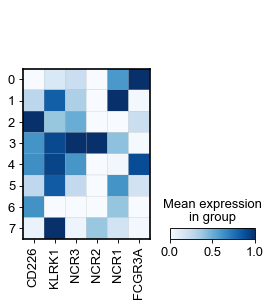

In [161]:
# matrixplot - additional activation receptors
sc.pl.matrixplot(adata, ['CD226', 'KLRK1', 'NCR3', 'NCR2', 'NCR1', 'FCGR3A'], 'leiden_0.6', dendrogram=False, 
                 cmap='Blues', standard_scale='var')#, save='_IL17RA')

### stacked bar plots - trdv x cluster

In [200]:
df = adata.obs[['max_trdv_v2', 'leiden_0.6']]
df.head()

,max_trdv_v2,leiden_0.6
index,,
0,TRDV1,1
1,TRDV1,1
2,TRDV2,2
3,TRAV14DV4,1
4,TRAV29DV5,5


In [203]:
df2 = df.groupby(['max_trdv_v2', 'leiden_0.6'])['leiden_0.6'].count().unstack()
df2

leiden_0.6,0,1,2,3,4,5,6,7
max_trdv_v2,,,,,,,,
TRDV1,382,215,110,284,55,33,0,2
TRDV2,67,82,351,24,204,37,91,1
TRDV3,45,41,24,49,25,6,1,0
TRAV14DV4,68,186,35,27,16,25,17,12
TRAV29DV5,42,33,26,17,6,18,2,76
TRAV23DV6,50,55,48,17,13,11,14,10
TRAV36DV7,5,4,4,3,1,1,1,0
TRAV38-2DV8,4,30,4,9,4,0,1,0


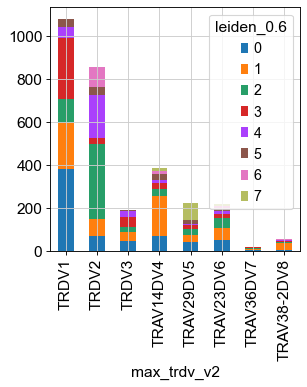

In [210]:
from matplotlib import pyplot as plt

df2.plot(kind='bar', stacked=True)
plt.savefig('figures/barplot_max_trdv_leiden.pdf')

In [251]:
df2.to_csv('outputs/counts_max_trdv_leiden.csv')

### Plot barplot by frequency 

In [234]:
rowsum = df2.sum(axis=1)
rowsum

max_trdv_v2
TRDV1          1081
TRDV2           857
TRDV3           191
TRAV14DV4       386
TRAV29DV5       220
TRAV23DV6       218
TRAV36DV7        19
TRAV38-2DV8      52
dtype: int64

In [236]:
df3 = df2.loc[:, '0':'7'].div(rowsum, axis=0)
df3

leiden_0.6,0,1,2,3,4,5,6,7
max_trdv_v2,,,,,,,,
TRDV1,0.353377,0.198890,0.101758,0.262720,0.050879,0.030527,0.000000,0.001850
TRDV2,0.078180,0.095683,0.409568,0.028005,0.238040,0.043174,0.106184,0.001167
TRDV3,0.235602,0.214660,0.125654,0.256545,0.130890,0.031414,0.005236,0.000000
TRAV14DV4,0.176166,0.481865,0.090674,0.069948,0.041451,0.064767,0.044041,0.031088
TRAV29DV5,0.190909,0.150000,0.118182,0.077273,0.027273,0.081818,0.009091,0.345455
TRAV23DV6,0.229358,0.252294,0.220183,0.077982,0.059633,0.050459,0.064220,0.045872
TRAV36DV7,0.263158,0.210526,0.210526,0.157895,0.052632,0.052632,0.052632,0.000000
TRAV38-2DV8,0.076923,0.576923,0.076923,0.173077,0.076923,0.000000,0.019231,0.000000


In [252]:
df3.to_csv('outputs/counts_max_trdv_leiden_freq.csv')

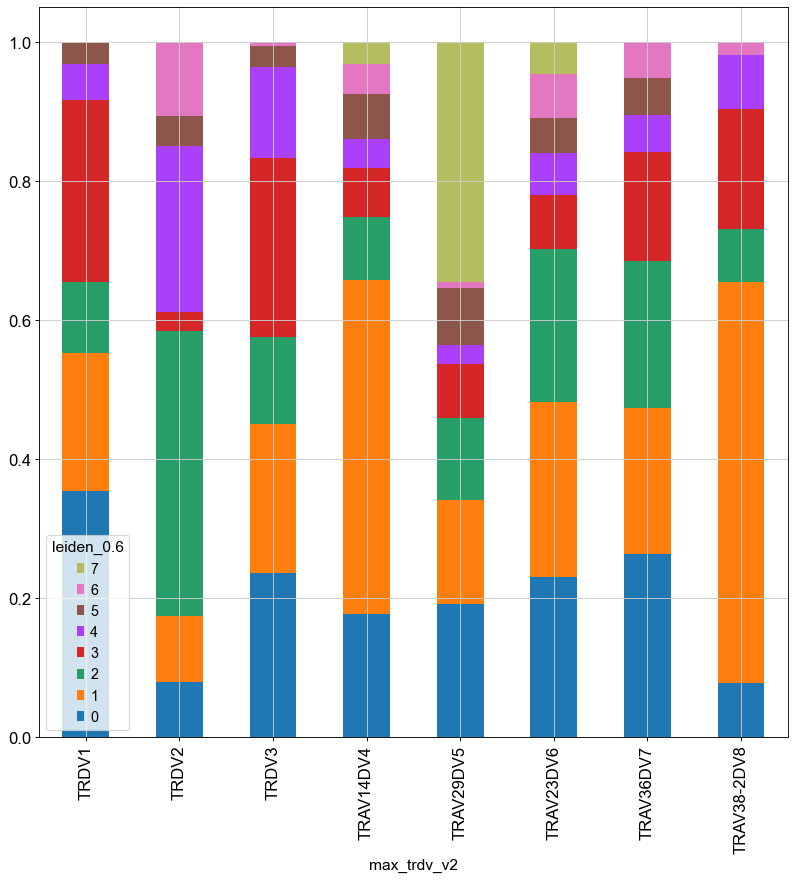

In [250]:
df3.plot(kind='bar', stacked=True, figsize=(12,12), fontsize=15, legend='reverse')
plt.savefig('figures/barplot_max_trdv_leiden_freq.pdf', dpi=1000)

## 32. Nov 17, 2022 (Thu) - make PTT UMAP <a class='anchor' id='32'></a>

[Table of contents](#toc)

### 1. PTT score UMAP

In [221]:
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw', 'tcr_expansion2', 'delta_expansion', 'delta_trdv'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'dendrogram_tcr_expansion2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trdv2_colo

In [223]:
ptt_genes = ['PDCD1', 'HAVCR2', 'TIGIT']

In [224]:
sc.tl.score_genes(adata, ptt_genes, 
                  score_name = 'ptt')

computing score 'ptt'
    finished: added
    'ptt', score of gene set (adata.obs).
    99 total control genes are used. (0:00:00)


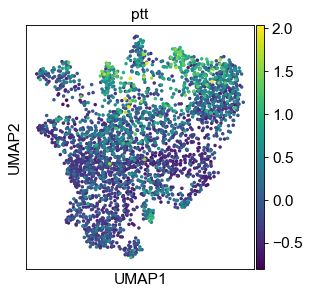

In [226]:
sc.pl.umap(adata, color='ptt', save='_score_ptt')

## 33. Nov 21, 2022 (Mon) - extract counts for (cytotox) violin plot stats <a class='anchor' id='33'></a>

[Table of contents](#toc)

In [253]:
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw', 'tcr_expansion2', 'delta_expansion', 'delta_trdv', 'ptt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'dendrogram_tcr_expansion2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trd

In [262]:
adata.obs.head()

,barcode,doublet,sample_id,n_genes,percent_mito,n_counts,leiden,batch_name,cell.barcode,tcr_expansion,...,exh_sig_ptt,exh_sig_ptt_raw,exh_sig_bengsch_raw,exh_sig_scott_raw,ptt_vs_Vd2,sig_vd2-_raw,tcr_expansion2,delta_expansion,delta_trdv,ptt
index,,,,,,,,,,,,,,,,,,,,,
0,AAACCTGCACAGCCCA-1,SNG,KID21,1852,0.027119,5273.0,1,Chiara_Kidney_Pooled_gdTCR,AAACCTGCACAGCCCA-1,NaN,...,0.263952,1.047894,0.075503,0.061164,Vd2-tp-,0.781219,nan,expanded,TRDV1,-0.013721
1,AAACCTGCAGGACCCT-1,SNG,KID21,1761,0.041157,6463.0,1,Chiara_Kidney_Pooled_gdTCR,AAACCTGCAGGACCCT-1,expanded,...,1.106077,1.320339,0.068453,0.037306,Vd2-tp+,1.102228,expanded,expanded,TRDV1,0.423432
2,AAACCTGCATTCACTT-1,SNG,KID19,1195,0.003381,2662.0,2,Chiara_Kidney_Pooled_gdTCR,AAACCTGCATTCACTT-1,NaN,...,-0.221797,0.436365,-0.014625,0.018300,Vd2+,0.489947,nan,expanded,TRDV2,-0.336689
3,AAACGGGAGCTAGTTC-1,SNG,KID21,1652,0.038266,5697.0,1,Chiara_Kidney_Pooled_gdTCR,AAACGGGAGCTAGTTC-1,NaN,...,0.883561,1.595587,0.060334,0.044589,Vd2-tp+,0.812253,nan,NaN,NaN,1.116336
4,AAACGGGCAATACGCT-1,SNG,KID19,2057,0.037134,4201.0,5,Chiara_Kidney_Pooled_gdTCR,AAACGGGCAATACGCT-1,NaN,...,0.823487,1.379016,0.050074,0.032970,Vd2-tp+,0.225186,nan,NaN,NaN,0.836065


In [267]:
adata.obs['delta_expansion'].value_counts()

expanded     936
singleton    348
Name: delta_expansion, dtype: int64

In [266]:
select_markers = ['PDCD1', 'HAVCR2', 'TIGIT', 'PRF1', 'GZMB', 'GZMA', 'GZMK', 'IFNG', 'TNF', 'IL2']

In [275]:
df1 = sc.get.obs_df(adata[adata.obs['delta_expansion'] == 'expanded'], keys=select_markers, obsm_keys=(), layer=None, gene_symbols=None, use_raw=False)
df1.to_csv('outputs/exp_violin_values_expanded.csv', index = False)
df1

,PDCD1,HAVCR2,TIGIT,PRF1,GZMB,GZMA,GZMK,IFNG,TNF,IL2
index,,,,,,,,,,
0,-0.587746,1.132567,-0.605615,-0.952346,-0.760624,0.802384,-1.116237,0.218094,-0.604720,-0.191334
1,1.196008,0.821215,0.734801,1.800583,3.888634,1.233811,-1.227353,-0.904242,-0.594676,-0.147902
2,-0.322009,-0.112372,-0.566085,-0.735624,-0.525833,-1.228383,0.252494,-0.832984,-0.968527,-0.376691
9,-0.607207,-0.481801,-0.723638,-1.031168,-0.805359,-0.693876,0.984030,0.668907,0.445913,-0.218391
10,-0.541891,-0.463294,-0.504166,-0.878315,-0.713890,-1.238259,-1.133835,1.402492,-0.718520,-0.202383
...,...,...,...,...,...,...,...,...,...,...
3007,-0.442306,-0.325991,-0.404584,-0.804495,1.995111,0.319538,1.367800,1.545304,-0.936636,-0.286263
3009,0.755275,-0.504540,-0.628639,1.205028,0.122669,0.193858,1.097694,0.963642,-0.584859,-0.194309
3010,-0.410678,-0.234806,1.508294,0.908599,0.887171,-1.318213,-0.912242,-0.591567,-0.735998,-0.290784


In [276]:
df2 = sc.get.obs_df(adata[adata.obs['delta_expansion'] == 'singleton'], keys=select_markers, obsm_keys=(), layer=None, gene_symbols=None, use_raw=False)
df2.to_csv('outputs/exp_violin_values_singleton.csv', index = False)
df2

,PDCD1,HAVCR2,TIGIT,PRF1,GZMB,GZMA,GZMK,IFNG,TNF,IL2
index,,,,,,,,,,
6,-0.527564,-0.387077,1.964240,0.217496,-0.718527,-1.426869,-1.054561,-0.730216,-0.656136,-0.253303
16,-0.485804,-0.327922,0.966604,-0.892209,-0.664095,-1.403381,-1.005574,0.453141,-0.686370,-0.272721
34,-0.477796,-0.332228,-0.543731,0.233153,-0.709226,0.341637,0.127962,-0.926568,2.581231,10.449464
55,-0.639364,-0.571531,-0.783315,0.403493,1.230713,0.870884,0.744417,0.832531,-0.347172,-0.105400
61,-0.648288,-0.566043,-0.759738,-1.006284,-0.767557,-1.498689,0.837400,-0.511743,-0.397284,-0.138631
...,...,...,...,...,...,...,...,...,...,...
2959,-0.540501,-0.447054,1.048201,-0.881390,-0.685100,0.226328,-1.064438,1.659593,-0.643950,-0.197943
2970,-0.603408,-0.498483,-0.799095,-0.961427,0.396676,0.765779,0.008989,-0.427504,-0.410513,3.586941
2996,-0.624909,-0.507100,-0.813458,-1.022537,-0.764978,-1.571155,-1.010481,-0.490076,-0.410270,-0.178462


In [277]:
# use_raw = True
df1 = sc.get.obs_df(adata[adata.obs['delta_expansion'] == 'expanded'], keys=select_markers, obsm_keys=(), layer=None, gene_symbols=None, use_raw=True)
df1.to_csv('outputs/exp_violin_values_raw_expanded.csv', index = False)
df1

,PDCD1,HAVCR2,TIGIT,PRF1,GZMB,GZMA,GZMK,IFNG,TNF,IL2
index,,,,,,,,,,
0,0.000000,1.063487,0.000000,0.000000,0.000000,2.515979,0.000000,1.063487,0.000000,0.0
1,1.409654,0.935022,0.935022,2.703066,5.417673,2.973856,0.000000,0.000000,0.000000,0.0
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.559528,0.000000,0.000000,0.0
9,0.000000,0.000000,0.000000,0.000000,0.000000,0.981977,2.664295,1.467749,0.981977,0.0
10,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.451195,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...
3007,0.000000,0.000000,0.000000,0.000000,3.043042,1.693327,3.235004,2.805261,0.000000,0.0
3009,1.031191,0.000000,0.000000,2.106280,1.031191,1.858360,2.847210,1.858360,0.000000,0.0
3010,0.000000,0.000000,1.642228,1.642228,1.642228,0.000000,0.000000,0.000000,0.000000,0.0


In [278]:
# use_raw = True
df2 = sc.get.obs_df(adata[adata.obs['delta_expansion'] == 'singleton'], keys=select_markers, obsm_keys=(), layer=None, gene_symbols=None, use_raw=True)
df2.to_csv('outputs/exp_violin_values_raw_singleton.csv', index = False)
df2

,PDCD1,HAVCR2,TIGIT,PRF1,GZMB,GZMA,GZMK,IFNG,TNF,IL2
index,,,,,,,,,,
6,0.0,0.000000,1.965184,1.113635,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
16,0.0,0.000000,1.230366,0.000000,0.000000,0.000000,0.000000,1.230366,0.000000,0.000000
34,0.0,0.000000,0.000000,1.084676,0.000000,1.927956,1.592691,0.000000,3.413692,3.911263
55,0.0,0.000000,0.000000,1.311237,2.211816,2.677853,2.211816,1.311237,0.000000,0.000000
61,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,2.412384,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...
2959,0.0,0.000000,1.228141,0.000000,0.000000,1.762974,0.000000,2.570654,0.000000,0.000000
2970,0.0,0.000000,0.000000,0.000000,1.257966,2.609429,1.257966,0.000000,0.000000,1.257966
2996,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


## 34. Nov 23, 2022 (Wed) <a class='anchor' id='34'></a>

[Table of contents](#toc)

In [279]:
adata.obs['tcr_expansion'].value_counts()

expanded     713
singleton    320
Name: tcr_expansion, dtype: int64

In [280]:
adata.obs['tcr_expansion2'].value_counts()

nan          1991
expanded      713
singleton     320
Name: tcr_expansion2, dtype: int64

In [281]:
adata.obs['delta_expansion'].value_counts()

expanded     936
singleton    348
Name: delta_expansion, dtype: int64

In [282]:
# expansion violin plots were made using adata[adata.obs['tcr_expansion2'] != 'nan']

# BUT expansion violin stats were made using adata[adata.obs['delta_expansion'] == 'expanded'] vs =='singleton' !!!

## 35. Nov 29, 2022 (Tue) - re-export expansion violin counts (use tcr_expansion numbers) to match violins <a class='anchor' id='35'></a>

[Table of contents](#toc)

In [283]:
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw', 'tcr_expansion2', 'delta_expansion', 'delta_trdv', 'ptt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'dendrogram_tcr_expansion2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trd

In [284]:
adata.obs.head()

,barcode,doublet,sample_id,n_genes,percent_mito,n_counts,leiden,batch_name,cell.barcode,tcr_expansion,...,exh_sig_ptt,exh_sig_ptt_raw,exh_sig_bengsch_raw,exh_sig_scott_raw,ptt_vs_Vd2,sig_vd2-_raw,tcr_expansion2,delta_expansion,delta_trdv,ptt
index,,,,,,,,,,,,,,,,,,,,,
0,AAACCTGCACAGCCCA-1,SNG,KID21,1852,0.027119,5273.0,1,Chiara_Kidney_Pooled_gdTCR,AAACCTGCACAGCCCA-1,NaN,...,0.263952,1.047894,0.075503,0.061164,Vd2-tp-,0.781219,nan,expanded,TRDV1,-0.013721
1,AAACCTGCAGGACCCT-1,SNG,KID21,1761,0.041157,6463.0,1,Chiara_Kidney_Pooled_gdTCR,AAACCTGCAGGACCCT-1,expanded,...,1.106077,1.320339,0.068453,0.037306,Vd2-tp+,1.102228,expanded,expanded,TRDV1,0.423432
2,AAACCTGCATTCACTT-1,SNG,KID19,1195,0.003381,2662.0,2,Chiara_Kidney_Pooled_gdTCR,AAACCTGCATTCACTT-1,NaN,...,-0.221797,0.436365,-0.014625,0.018300,Vd2+,0.489947,nan,expanded,TRDV2,-0.336689
3,AAACGGGAGCTAGTTC-1,SNG,KID21,1652,0.038266,5697.0,1,Chiara_Kidney_Pooled_gdTCR,AAACGGGAGCTAGTTC-1,NaN,...,0.883561,1.595587,0.060334,0.044589,Vd2-tp+,0.812253,nan,NaN,NaN,1.116336
4,AAACGGGCAATACGCT-1,SNG,KID19,2057,0.037134,4201.0,5,Chiara_Kidney_Pooled_gdTCR,AAACGGGCAATACGCT-1,NaN,...,0.823487,1.379016,0.050074,0.032970,Vd2-tp+,0.225186,nan,NaN,NaN,0.836065


In [285]:
adata.obs['delta_expansion'].value_counts()

expanded     936
singleton    348
Name: delta_expansion, dtype: int64

In [286]:
adata.obs['tcr_expansion'].value_counts()

expanded     713
singleton    320
Name: tcr_expansion, dtype: int64

In [287]:
select_markers = ['PDCD1', 'HAVCR2', 'TIGIT', 'PRF1', 'GZMB', 'GZMA', 'GZMK', 'IFNG', 'TNF', 'IL2']

In [288]:
# use_raw = True
df1 = sc.get.obs_df(adata[adata.obs['tcr_expansion'] == 'expanded'], keys=select_markers, obsm_keys=(), layer=None, gene_symbols=None, use_raw=True)
df1.to_csv('outputs/exp_violin_values_raw_tcr_expanded.csv', index = False)
df1

,PDCD1,HAVCR2,TIGIT,PRF1,GZMB,GZMA,GZMK,IFNG,TNF,IL2
index,,,,,,,,,,
1,1.409654,0.935022,0.935022,2.703066,5.417673,2.973856,0.000000,0.000000,0.000000,0.0
9,0.000000,0.000000,0.000000,0.000000,0.000000,0.981977,2.664295,1.467749,0.981977,0.0
10,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.451195,0.000000,0.0
17,0.000000,0.000000,0.000000,0.000000,1.638542,2.229510,1.638542,0.000000,0.000000,0.0
20,1.875932,0.000000,1.875932,1.875932,0.000000,2.323514,1.875932,0.000000,1.044613,0.0
...,...,...,...,...,...,...,...,...,...,...
3007,0.000000,0.000000,0.000000,0.000000,3.043042,1.693327,3.235004,2.805261,0.000000,0.0
3009,1.031191,0.000000,0.000000,2.106280,1.031191,1.858360,2.847210,1.858360,0.000000,0.0
3010,0.000000,0.000000,1.642228,1.642228,1.642228,0.000000,0.000000,0.000000,0.000000,0.0


In [289]:
# use_raw = True
df2 = sc.get.obs_df(adata[adata.obs['tcr_expansion'] == 'singleton'], keys=select_markers, obsm_keys=(), layer=None, gene_symbols=None, use_raw=True)
df2.to_csv('outputs/exp_violin_values_raw_tcr_singleton.csv', index = False)
df2

,PDCD1,HAVCR2,TIGIT,PRF1,GZMB,GZMA,GZMK,IFNG,TNF,IL2
index,,,,,,,,,,
6,0.0,0.0,1.965184,1.113635,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
16,0.0,0.0,1.230366,0.000000,0.000000,0.000000,0.000000,1.230366,0.000000,0.000000
34,0.0,0.0,0.000000,1.084676,0.000000,1.927956,1.592691,0.000000,3.413692,3.911263
55,0.0,0.0,0.000000,1.311237,2.211816,2.677853,2.211816,1.311237,0.000000,0.000000
61,0.0,0.0,0.000000,0.000000,0.000000,0.000000,2.412384,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...
2959,0.0,0.0,1.228141,0.000000,0.000000,1.762974,0.000000,2.570654,0.000000,0.000000
2970,0.0,0.0,0.000000,0.000000,1.257966,2.609429,1.257966,0.000000,0.000000,1.257966
2976,0.0,0.0,0.000000,0.000000,0.000000,0.000000,2.476570,0.000000,0.000000,0.000000


## 36. Dec 1, 2022 (Thu) - re-making the Fig. 4E heatmap <a class='anchor' id='36'></a>

[Table of contents](#toc)

### A. heatmap

In [290]:
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw', 'tcr_expansion2', 'delta_expansion', 'delta_trdv', 'ptt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'dendrogram_tcr_expansion2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colors', 'single_trd

In [340]:
# identify KIR genes present in dataset
genes_names = adata.var.index
substring = 'KIR'
res = [i for i in genes_names if substring in i]
res.sort()
res

['KIR2DL1', 'KIR2DL3', 'KIR2DL4', 'KIR3DL1', 'KIR3DL2', 'KIR3DL3', 'KIR3DX1']

In [341]:
# TODO: add genes, re-name/re-order 0 as 8

# 1. new NKG & KIR genes
#   NKG2D, NKG2A + 'KIR3DX1', 'KIR3DL3', 'KIR2DL3', 'KIR2DL1', 'KIR2DL4', 'KIR3DL1', 'KIR3DL2'
#   KLRK1, KLRC1

# 2. re-name/re-order 0 as 8

fig4e_marker_dict = {
                 'Exhaustion': ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'ENTPD1', 'TOX'],       
                 'Activation': ['TNFRSF9', 
                                'KLRK1', 'KLRC1', 'KIR2DL1', 'KIR2DL3', 'KIR2DL4', 'KIR3DL1', 'KIR3DL2', 'KIR3DL3', 'KIR3DX1',
                                'MKI67', 'TCF7'],          
                 'Cytotoxic': ['PRF1', 'GZMB', 'GZMA', 'GZMK'],
                 'Cytokine': ['TNF', 'IFNG', 'IL2']}

In [327]:
# create re-named and re-ordered (leiden_0.6) row names
leiden = adata.obs['leiden_0.6']
renamed = ['8', '1', '2', '3', '4', '5', '6', '7']
leiden = leiden.cat.rename_categories(renamed)
reordered = ['1', '2', '3', '4', '5', '6', '7', '8']
leiden = leiden.cat.reorder_categories(reordered)
leiden

index
0       1
1       1
2       2
3       1
4       5
       ..
3019    1
3020    1
3021    8
3022    6
3023    8
Name: leiden_0.6, Length: 3024, dtype: category
Categories (8, object): ['1', '2', '3', '4', '5', '6', '7', '8']

In [329]:
# confirm sucessful re-naming and re-ordering
adata.obs['leiden_0.6_2'] = leiden
adata.obs[['leiden_0.6', 'leiden_0.6_2']]

,leiden_0.6,leiden_0.6_2
index,,
0,1,1
1,1,1
2,2,2
3,1,1
4,5,5
...,...,...
3019,1,1
3020,1,1
3021,0,8


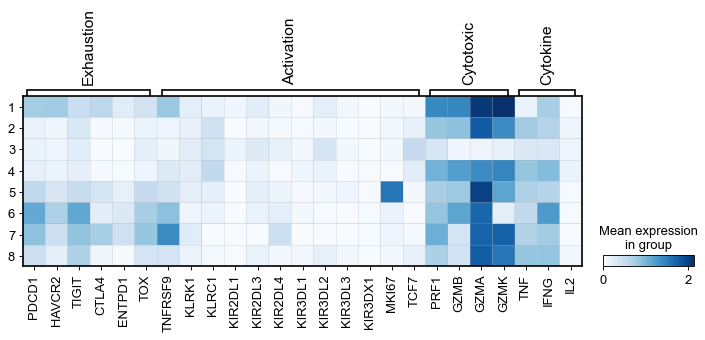

In [342]:
# plot unnormalized
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6_2', dendrogram=False, 
                 cmap='Blues', save='_fig4e_2_w_NKG2s_KIRs')

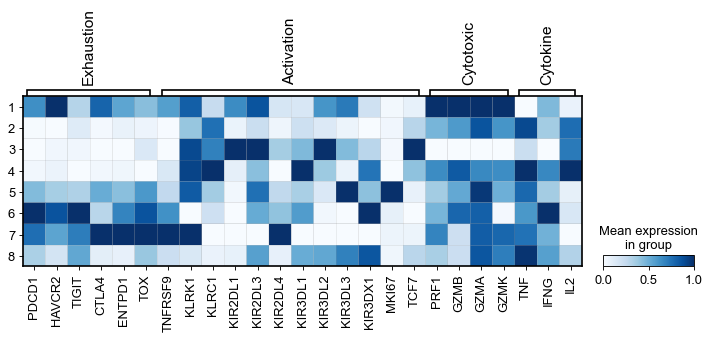

In [343]:
# plot normalized
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6_2', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_2_w_NKG2s_KIRs_scaled')

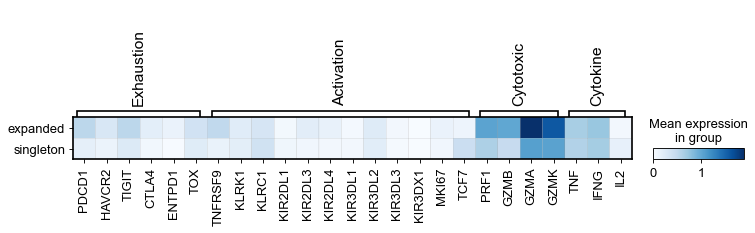

In [381]:
# plot unnormalized - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', save='_fig4e_2_w_NKG2s_KIRs_expansion')

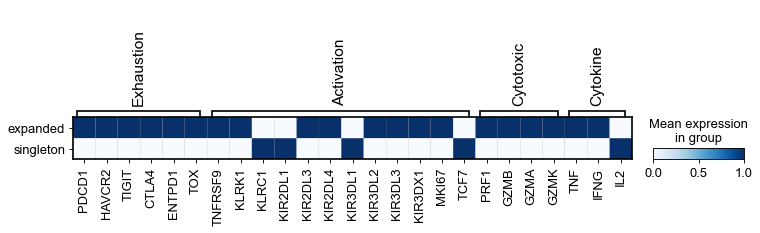

In [382]:
# plot normalized - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_2_w_NKG2s_KIRs_expansion_scaled')

In [383]:
fig4e_marker_dict_2 = {
                 'Activation': ['TNFRSF9', 
                                'KLRK1', 'KLRC1', 'KIR2DL1', 'KIR2DL3', 'KIR2DL4', 'KIR3DL1', 'KIR3DL2', 'KIR3DL3', 'KIR3DX1',
                                'MKI67', 'TCF7'],          
                    }

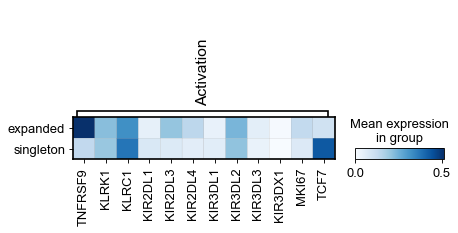

In [384]:
# plot unnormalized - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict_2, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', save='_fig4e_2_just_NKG2s_KIRs_expansion')

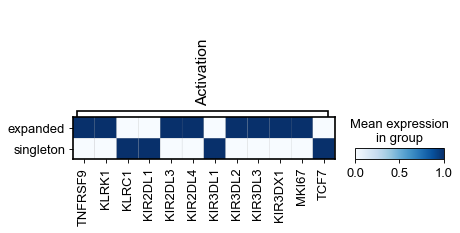

In [385]:
# plot normalized - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict_2, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_2_just_NKG2s_KIRs_expansion_scaled')

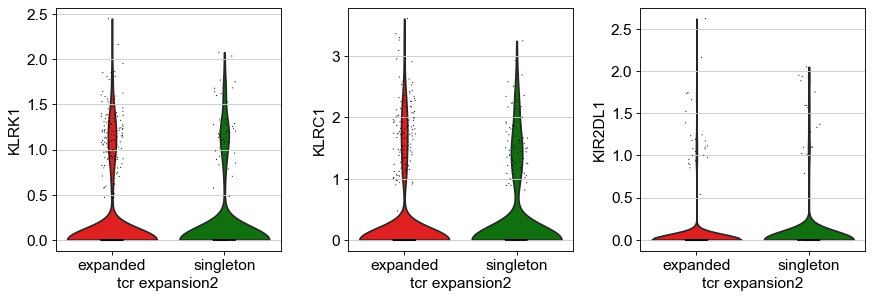

In [352]:
sc.pl.violin(adata[adata.obs['tcr_expansion2'] != 'nan'], 
             ['KLRK1', 'KLRC1', 'KIR2DL1'], 
             groupby='tcr_expansion2', save='_expansion_wo_nan_KLR_KIR_1')

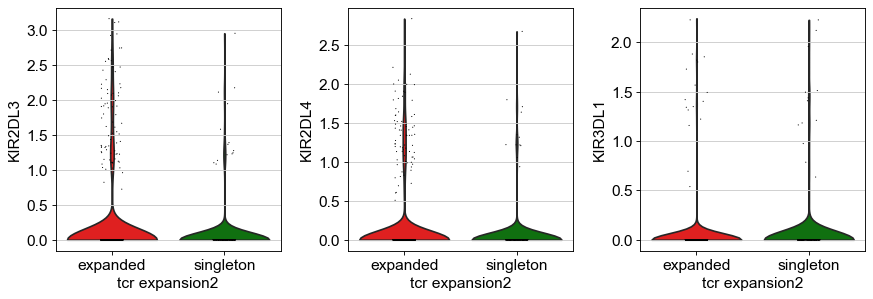

In [353]:
sc.pl.violin(adata[adata.obs['tcr_expansion2'] != 'nan'], 
             ['KIR2DL3', 'KIR2DL4', 'KIR3DL1'], 
             groupby='tcr_expansion2', save='_expansion_wo_nan_KLR_KIR_2')

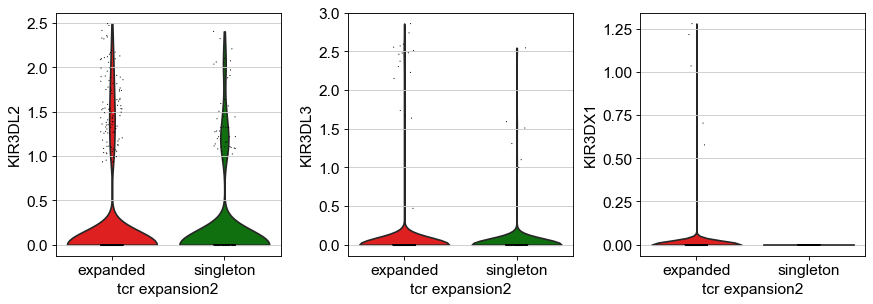

In [354]:
sc.pl.violin(adata[adata.obs['tcr_expansion2'] != 'nan'], 
             ['KIR3DL2', 'KIR3DL3', 'KIR3DX1'], 
             groupby='tcr_expansion2', save='_expansion_wo_nan_KLR_KIR_3')

### A.2 more heatmaps, with the addition of KLRD1 and KLRC3 from our Vd2- gene signature

In [400]:
# add KLRD1 and KLRC3 from gene sig
# KLRD1, KLRK1, KLRC1, KLRC3
# CD94,  NKG2D, NKG2A, NKG2E
fig4e_marker_dict = {
                 'Exhaustion': ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'ENTPD1', 'TOX'],       
                 'Activation': ['TNFRSF9', 
                                'KLRD1', 'KLRK1', 'KLRC1', 'KLRC3', 'KIR2DL1', 'KIR2DL3', 'KIR2DL4', 'KIR3DL1', 'KIR3DL2', 'KIR3DL3', 'KIR3DX1',
                                'MKI67', 'TCF7'],          
                 'Cytotoxic': ['PRF1', 'GZMB', 'GZMA', 'GZMK'],
                 'Cytokine': ['TNF', 'IFNG', 'IL2']}

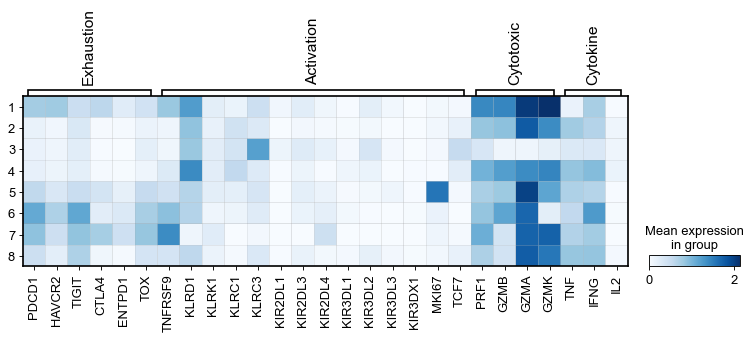

In [393]:
# plot unnormalized
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6_2', dendrogram=False, 
                 cmap='Blues', save='_fig4e_3_w_NKG2s_KIRs')

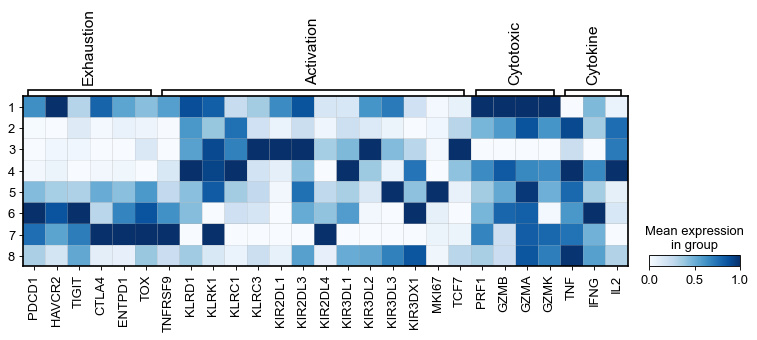

In [394]:
# plot normalized
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6_2', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_3_w_NKG2s_KIRs_scaled')

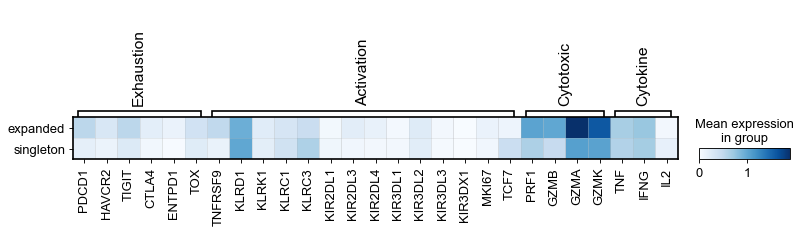

In [395]:
# plot unnormalized - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', save='_fig4e_3_w_NKG2s_KIRs_expansion')

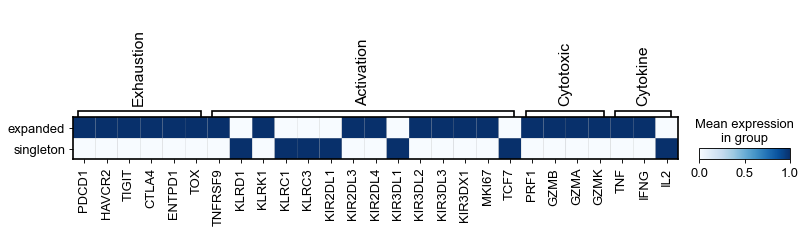

In [396]:
# plot normalized - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_3_w_NKG2s_KIRs_expansion_scaled')

In [401]:
fig4e_marker_dict_2 = {
                 'Activation': ['TNFRSF9', 
                                'KLRD1', 'KLRK1', 'KLRC1', 'KLRC3', 'KIR2DL1', 'KIR2DL3', 'KIR2DL4', 'KIR3DL1', 'KIR3DL2', 'KIR3DL3', 'KIR3DX1',
                                'MKI67', 'TCF7'],          
                    }

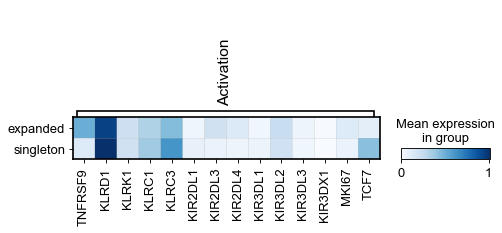

In [402]:
# plot unnormalized - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict_2, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', save='_fig4e_3_just_NKG2s_KIRs_expansion')

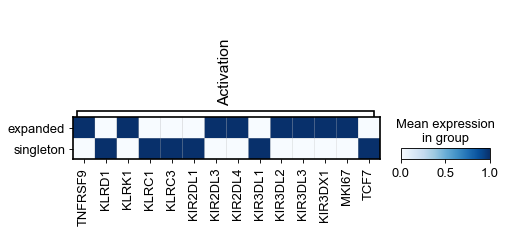

In [403]:
# plot normalized - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict_2, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_3_just_NKG2s_KIRs_expansion_scaled')

### B. Export Fig. 6C violin plot counts (for stats in R)

In [387]:
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw', 'tcr_expansion2', 'delta_expansion', 'delta_trdv', 'ptt', 'leiden_0.6_2'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'dendrogram_tcr_expansion2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colo

In [388]:
adata.obs['max_trdv2_v2'].value_counts()

Vd2-    2167
Vd2+     857
Name: max_trdv2_v2, dtype: int64

In [389]:
# Fig. 6C genes (Vd2- 20 gene signature)
gd_vd2neg_sig = ['TRDV1', 'RPL41', 'TRDC', 'CTSW', 'KLRD1', 'RPS10', 'RPS29', 'RPL36A', 'ZNF683', 'CCL5', 
                 'XCL2', 'MATK', 'LINC02446', 'KLRC3', 'XCL1', 'AOAH', 'NKG7', 'TRG-AS1', 'CRTAM', 'CD7']

In [390]:
# Vd2-, use_raw = True
df1 = sc.get.obs_df(adata[adata.obs['max_trdv2_v2'] == 'Vd2-'], keys=gd_vd2neg_sig, obsm_keys=(), layer=None, gene_symbols=None, use_raw=True)
df1.to_csv('outputs/fig6c_violin_values_raw_Vd2-.csv', index = False)
df1

,TRDV1,RPL41,TRDC,CTSW,KLRD1,RPS10,RPS29,RPL36A,ZNF683,CCL5,XCL2,MATK,LINC02446,KLRC3,XCL1,AOAH,NKG7,TRG-AS1,CRTAM,CD7
index,,,,,,,,,,,,,,,,,,,,
0,3.084704,3.955164,1.063487,2.515979,1.063487,2.993958,3.167896,1.900518,1.567137,4.620177,1.063487,1.900518,3.244695,1.900518,0.000000,1.567137,3.244695,1.063487,0.000000,1.900518
1,1.409654,3.641118,1.730204,1.972563,0.935022,2.703066,2.593623,1.730204,0.000000,4.037804,4.762560,0.000000,2.167492,0.935022,4.986638,0.000000,2.973856,0.935022,3.859003,3.464028
3,0.000000,4.290017,0.000000,3.011035,2.279987,2.586799,3.722607,2.821247,0.000000,4.760895,0.000000,1.506435,3.536628,0.000000,0.000000,1.013530,4.215112,2.082093,1.506435,2.445113
4,0.000000,2.997884,1.751071,2.353425,0.000000,1.751071,2.726696,1.217990,0.000000,3.464016,2.096932,0.000000,0.000000,0.000000,0.000000,0.000000,3.386579,0.000000,2.096932,2.557377
5,0.000000,4.355722,0.000000,1.912387,2.162438,1.912387,3.458498,2.528801,1.912387,4.723295,0.000000,1.072637,1.578185,0.000000,0.000000,0.000000,4.670670,0.000000,1.072637,2.907321
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3019,0.000000,4.440864,1.165190,2.800065,1.165190,2.487624,4.066799,2.655998,1.688815,4.466537,0.000000,0.000000,2.925967,0.000000,0.000000,2.030723,3.529238,0.000000,0.000000,1.688815
3020,0.000000,4.021676,1.927287,2.812745,1.592067,2.812745,3.274890,2.544879,0.000000,4.941237,0.000000,1.084157,2.923835,0.000000,0.000000,0.000000,4.241228,1.592067,1.084157,2.544879
3021,3.213659,3.213659,1.941253,1.382221,1.700303,1.941253,3.151797,1.382221,0.913033,4.939811,1.941253,1.382221,0.000000,1.700303,2.135272,0.913033,3.855409,0.000000,0.000000,1.382221


In [391]:
# Vd2+, use_raw = True
df2 = sc.get.obs_df(adata[adata.obs['max_trdv2_v2'] == 'Vd2+'], keys=gd_vd2neg_sig, obsm_keys=(), layer=None, gene_symbols=None, use_raw=True)
df2.to_csv('outputs/fig6c_violin_values_raw_Vd2+.csv', index = False)
df2

,TRDV1,RPL41,TRDC,CTSW,KLRD1,RPS10,RPS29,RPL36A,ZNF683,CCL5,XCL2,MATK,LINC02446,KLRC3,XCL1,AOAH,NKG7,TRG-AS1,CRTAM,CD7
index,,,,,,,,,,,,,,,,,,,,
2,0.0,4.665174,1.559528,1.559528,2.774231,2.774231,4.172258,2.984816,1.559528,2.774231,0.000000,2.141612,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.984816
7,0.0,4.178549,0.000000,0.000000,0.000000,3.065720,3.802681,2.919309,1.923201,4.517036,2.747724,0.000000,1.366452,0.000000,1.923201,0.000000,4.132759,1.923201,0.000000,2.540472
10,0.0,3.949137,1.656490,1.656490,0.000000,2.762733,3.191499,2.451195,1.656490,3.818355,0.000000,0.000000,0.000000,0.000000,0.000000,1.137974,2.451195,0.000000,1.996240,1.656490
17,0.0,4.005869,0.000000,0.000000,0.000000,3.531677,3.079075,3.253700,1.638542,4.763322,0.000000,2.598456,3.531677,0.000000,0.000000,0.000000,3.402317,1.638542,0.000000,3.402317
24,0.0,3.735481,0.000000,1.965184,1.965184,3.388980,3.518285,3.317464,0.000000,3.872125,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.965720,0.000000,1.113635,2.854357
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2995,0.0,4.238903,1.210829,2.717182,1.742663,2.344213,2.988211,2.088005,0.000000,3.201228,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.547986,0.000000,0.000000,1.210829
2997,0.0,3.933833,1.187046,2.058238,1.187046,2.058238,3.681743,2.516642,0.000000,3.260065,0.000000,1.714657,0.000000,0.000000,0.000000,0.000000,2.829778,0.000000,0.000000,2.516642
3007,0.0,4.179671,0.000000,2.492697,2.290015,2.492697,3.467696,2.035530,1.169000,4.419979,1.693327,1.693327,2.290015,2.035530,0.000000,1.169000,3.395984,0.000000,0.000000,2.661142


### C. Re-make Fig 6C (gene sig Vd2- vs Vd2+ violins) as heatmap

In [404]:
# Fig. 6C genes (Vd2- 20 gene signature)
gd_vd2neg_sig = ['TRDV1', 'RPL41', 'TRDC', 'CTSW', 'KLRD1', 'RPS10', 'RPS29', 'RPL36A', 'ZNF683', 'CCL5', 
                 'XCL2', 'MATK', 'LINC02446', 'KLRC3', 'XCL1', 'AOAH', 'NKG7', 'TRG-AS1', 'CRTAM', 'CD7']

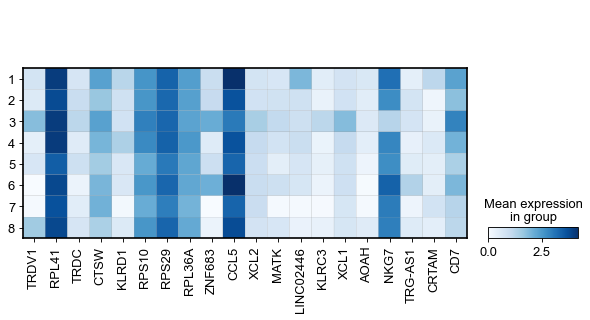

In [406]:
sc.pl.matrixplot(adata, gd_vd2neg_sig, 'leiden_0.6_2', dendrogram=False, 
                 cmap='Blues')#, save='_fig4e_3_just_NKG2s_KIRs_expansion')

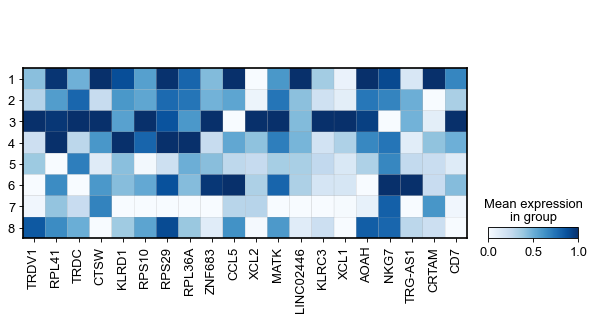

In [408]:
sc.pl.matrixplot(adata, gd_vd2neg_sig, 'leiden_0.6_2', dendrogram=False, 
                 cmap='Blues', standard_scale='var')#, save='_fig4e_3_just_NKG2s_KIRs_expansion')

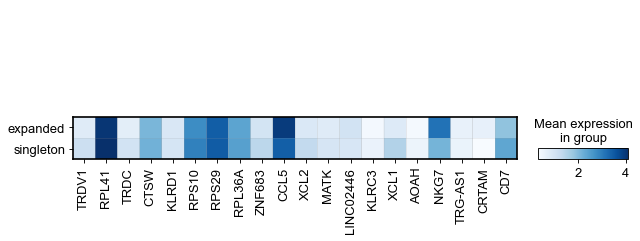

In [412]:
# plot unnormalized - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], gd_vd2neg_sig, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues')#, save='_fig4e_2_w_NKG2s_KIRs_expansion')

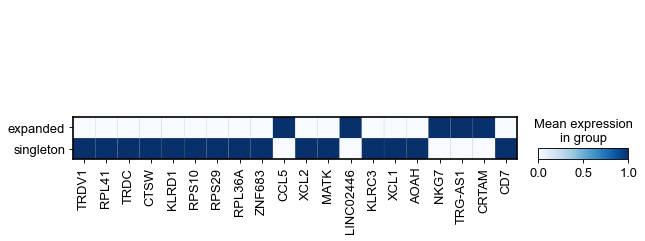

In [413]:
# plot unnormalized - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], gd_vd2neg_sig, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', standard_scale='var')#, save='_fig4e_2_w_NKG2s_KIRs_expansion')

In [414]:
adata

AnnData object with n_obs × n_vars = 3024 × 2934
    obs: 'barcode', 'doublet', 'sample_id', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'batch_name', 'cell.barcode', 'tcr_expansion', 'trdv', 'single_trdv', 'single_trdv2', 'stress', 'leiden_0.6', 'tp', 'tp_Vd2neg', 'max_trdv', 'max_trdv2', 'max_trdv_v2', 'max_trdv2_v2', 'tp_Vd2neg_v2', 'exh_sig_scott', 'exh_sig_ptt', 'exh_sig_ptt_raw', 'exh_sig_bengsch_raw', 'exh_sig_scott_raw', 'ptt_vs_Vd2', 'sig_vd2-_raw', 'tcr_expansion2', 'delta_expansion', 'delta_trdv', 'ptt', 'leiden_0.6_2'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden_0.6', 'dendrogram_max_trdv2', 'dendrogram_ptt_vs_Vd2', 'dendrogram_single_trdv2', 'dendrogram_tcr_expansion2', 'leiden', 'leiden_0.6_colors', 'leiden_colors', 'max_trdv2_colors', 'max_trdv2_v2_colors', 'max_trdv_colors', 'max_trdv_v2_colors', 'neighbors', 'pca', 'ptt_vs_Vd2_colors', 'rank_genes_groups', 'sample_id_colo

In [416]:
adata.obs['max_trdv2_v2'].value_counts()

Vd2-    2167
Vd2+     857
Name: max_trdv2_v2, dtype: int64

### D. Re-label "inhibitory" KIRs?

In [427]:
# add KLRD1 and KLRC3 from gene sig
# KLRD1, KLRK1, KLRC1, KLRC3
# CD94,  NKG2D, NKG2A, NKG2E
fig4e_marker_dict = {
                 'Exhaustion': ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'ENTPD1', 'TOX'],       
                 'Inhibition': ['KIR2DL1', 'KIR2DL3', 'KIR2DL4', 'KIR3DL1', 'KIR3DL2', 'KIR3DL3', 'KIR3DX1'],
                 'Activation': ['KLRD1', 'KLRK1', 'KLRC1', 'KLRC3', 'TNFRSF9', 'MKI67', 'TCF7'],
                 'Cytotoxic': ['PRF1', 'GZMB', 'GZMA', 'GZMK'],
                 'Cytokine': ['TNF', 'IFNG', 'IL2']}

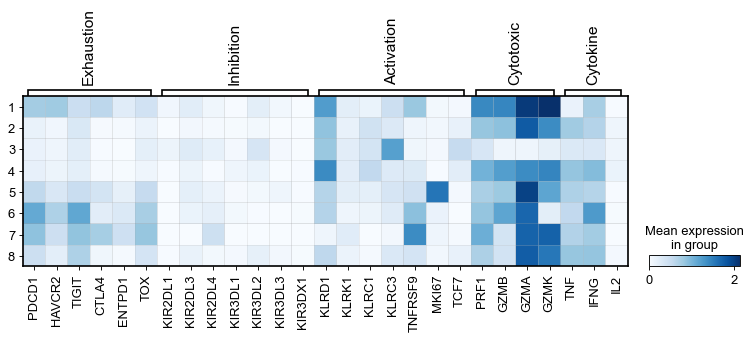

In [431]:
# plot unnormalized
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6_2', dendrogram=False, 
                 cmap='Blues', save='_fig4e_4_w_NKG2s_KIRs')

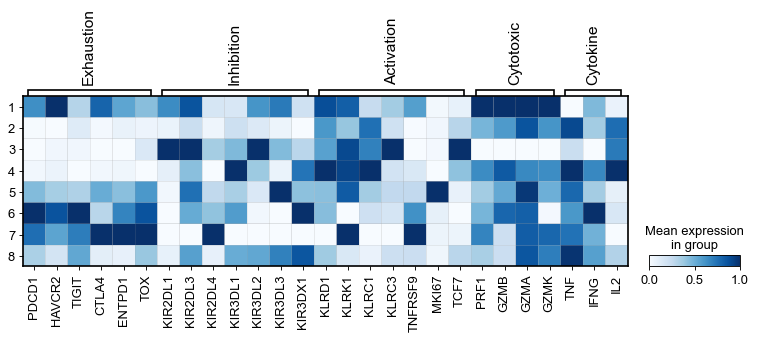

In [432]:
# plot normalized
sc.pl.matrixplot(adata, fig4e_marker_dict, 'leiden_0.6_2', dendrogram=False, 
                 cmap='Blues', standard_scale='var', save='_fig4e_4_w_NKG2s_KIRs_scaled')

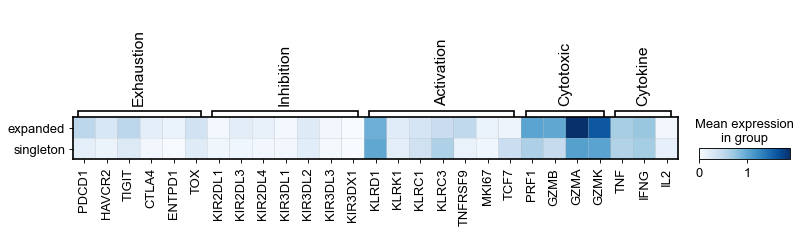

In [430]:
# plot unnormalized - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues')#, save='_fig4e_3_w_NKG2s_KIRs_expansion')

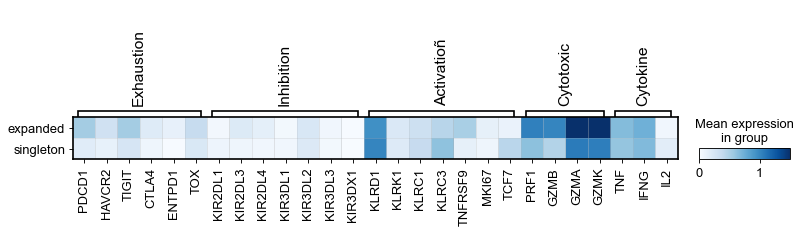

In [423]:
# plot w 'vmax' color scale cap - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', vmax=1.5)#, save='_fig4e_3_w_NKG2s_KIRs_expansion')

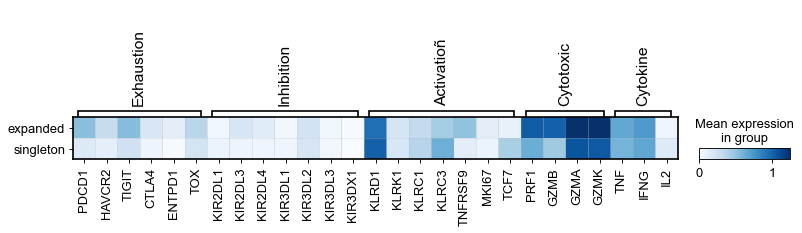

In [426]:
# USE THIS ONE
# plot w 'vmax' color scale cap - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', vmax=1.25, save='_fig4e_3_w_NKG2s_KIRs_expansion_vmax1.25')

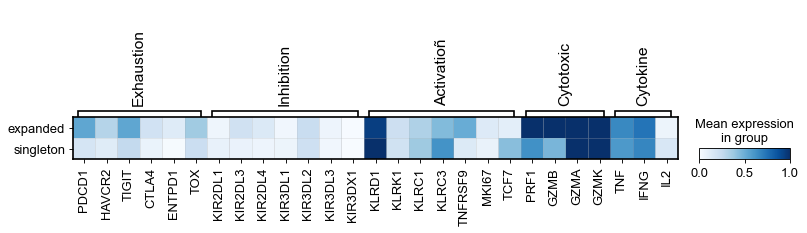

In [425]:
# plot w 'vmax' color scale cap - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', vmax=1)#, save='_fig4e_3_w_NKG2s_KIRs_expansion')

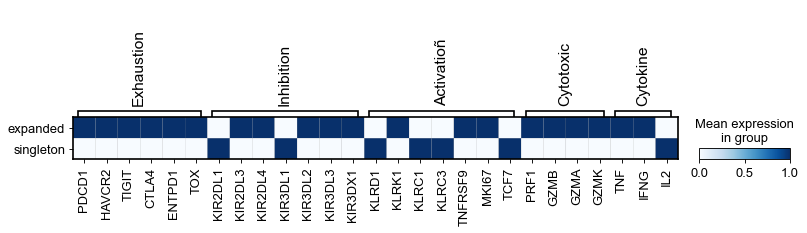

In [421]:
# plot normalized - expansion
sc.pl.matrixplot(adata[adata.obs['tcr_expansion2'] != 'nan'], fig4e_marker_dict, 'tcr_expansion2', dendrogram=False, 
                 cmap='Blues', standard_scale='var')#, save='_fig4e_3_w_NKG2s_KIRs_expansion_scaled')

## 37. Bottom of notebook <a class='anchor' id='37'></a>

[Table of contents](#toc)